<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Brain_Tumor_Object_Detection_Scratch_Crop_Brightness_5_layers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'

/content/drive/.shortcut-targets-by-id/1LSYxqUtErLWfbOg3Kht_4Q02IsWLPY5r/dataset brain tumor/dataset


In [3]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [4]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [5]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [6]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, MaxPooling2D, Dense, Activation, Dropout
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils
from PIL import Image, ImageEnhance

In [7]:
%cd '/dataset unzipped'

/dataset unzipped


In [8]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    brightness = 30
    image = np.int16(image)
    image = image + brightness
    image = np.clip(image,0,255)
    image = np.uint8(image)
    #image_enhance = ImageEnhance.Brightness(image)
    #factor = 1.5
    #image = image_enhance.enhance(factor)

    # Convert the image to grayscale, and blur it slightl
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()

    #add contrast
    #kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3))
    # Top Hat Transform
    #topHat = cv2.morphologyEx(new_image, cv2.MORPH_TOPHAT, kernel)
    # Black Hat Transform
    #blackHat = cv2.morphologyEx(new_image, cv2.MORPH_BLACKHAT, kernel)
    
    #new_image = new_image + topHat - blackHat
    
    return new_image,extLeft,extRight,extTop,extBot

In [9]:
#Codice per rendere l'immagine quadrata 
def make_square(im, fill_color=(0, 0, 0, 0)):
    x, y = im.shape[0], im.shape[1]
    size = max(x, y)
    BLACK = [0, 0, 0]
    new_im = cv2.copyMakeBorder(im,int((size-y)/2),int((size-y)/2),int((size-x)/2),int((size-x)/2),cv2.BORDER_CONSTANT, value = BLACK)
    return new_im

In [10]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 224

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_train.append(image)

image_index = 0
#bb_train = np.zeros((len(X_train),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

                #print(temp_array)
                #bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
#bb_test = np.zeros((len(X_test),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

                #bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

#print(bb_test[30])
#print(extRight_coords_x_test[30])
#print(extLeft_coords_x_test[30])
     


Dimensione delle liste prima di duplicare le immagini:
X_train:  878
bb_list:  878
Dimensione delle liste dopo la duplicazione delle immagini:
X_train:  919
bb_train:  919
Dimensione delle liste prima di duplicare le immagini:
X_test:  223
bb_list:  223
Dimensione delle liste dopo la duplicazione delle immagini:
X_test:  237
bb_test:  237


In [11]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [12]:
datagen = ImageDataGenerator(
  rescale = 1./255,
  #rotation_range = 5,
  shear_range = 0.02,
  #zoom_range = 0.02, 
  samplewise_center = True,
  samplewise_std_normalization = True
  #horizontal_flip=True
)

val_data_gen = ImageDataGenerator(rescale = 1./255)

In [13]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [14]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [15]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [16]:
tf.keras.backend.set_image_data_format('channels_last')
BATCH_SIZE = 32
#save_path = os.path.join('./', 'model_from_scratch')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test)

In [17]:
input_ = Input(shape=[image_size,image_size, 3])

x = input_

for i in range(5):
    n_filters = 2**(i + 3)
    x = Conv2D(n_filters, 3, activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPool2D(2, padding='same')(x)

x = Dropout(0.5)(x)
x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dense(32, activation='relu')(x)
output = Dense(4, name='coords')(x)

model = tf.keras.models.Model(input_, output)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 8)       224       
                                                                 
 batch_normalization (BatchN  (None, 224, 224, 8)      32        
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 8)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 16)      1168      
                                                                 
 batch_normalization_1 (Batc  (None, 112, 112, 16)     64    

In [18]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
    print(len(pred_coords))    
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [19]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [20]:
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_SCRATCH

save_path = './model_checkpoint_SCRATCH/model_SCRATCH.h5'
     

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_SCRATCH’: File exists


In [21]:
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    save_format = 'h5',
    filepath=save_path,
    monitor='val_IoU',
    verbose=1,
    mode = 'max',
    save_best_only=True
    ),
    ShowTestImages()
]

In [22]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)
def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou

In [23]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

Epoch 1/200
26/26 [==============================] - ETA: 0s - loss: 31.7532 - IoU: 0.0807
Epoch 1: val_IoU improved from -inf to 0.01386, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 1s 38ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


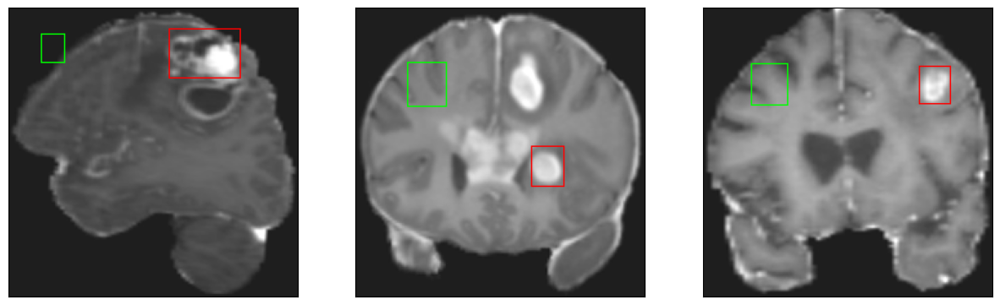

26/26 [==============================] - 19s 203ms/step - loss: 31.7532 - IoU: 0.0807 - val_loss: 41.4309 - val_IoU: 0.0139
Epoch 2/200
26/26 [==============================] - ETA: 0s - loss: 19.2100 - IoU: 0.1821
Epoch 2: val_IoU improved from 0.01386 to 0.09925, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


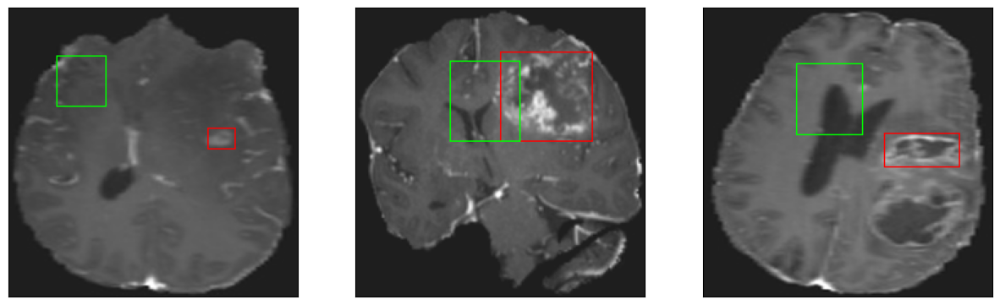

26/26 [==============================] - 3s 98ms/step - loss: 19.2100 - IoU: 0.1821 - val_loss: 29.6847 - val_IoU: 0.0993
Epoch 3/200
25/26 [===========================>..] - ETA: 0s - loss: 16.1381 - IoU: 0.2466
Epoch 3: val_IoU did not improve from 0.09925
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


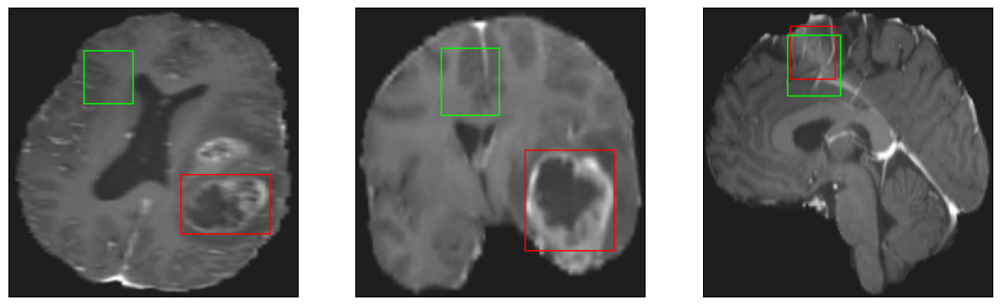

26/26 [==============================] - 2s 84ms/step - loss: 16.0906 - IoU: 0.2482 - val_loss: 29.2775 - val_IoU: 0.0604
Epoch 4/200
25/26 [===========================>..] - ETA: 0s - loss: 14.3021 - IoU: 0.2807
Epoch 4: val_IoU did not improve from 0.09925
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


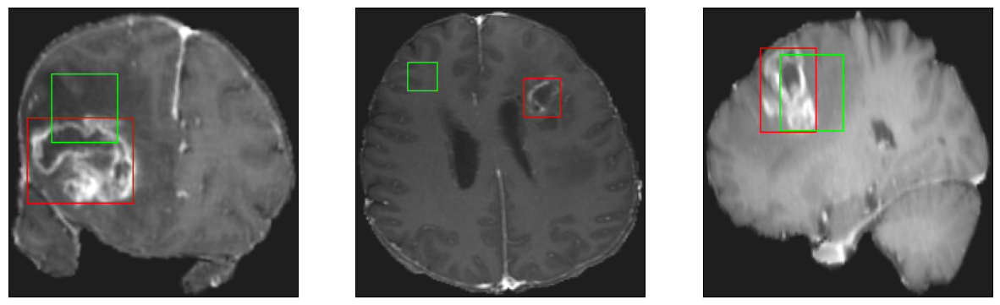

26/26 [==============================] - 2s 80ms/step - loss: 14.2542 - IoU: 0.2832 - val_loss: 28.9216 - val_IoU: 0.0541
Epoch 5/200
25/26 [===========================>..] - ETA: 0s - loss: 13.4811 - IoU: 0.2949
Epoch 5: val_IoU did not improve from 0.09925
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


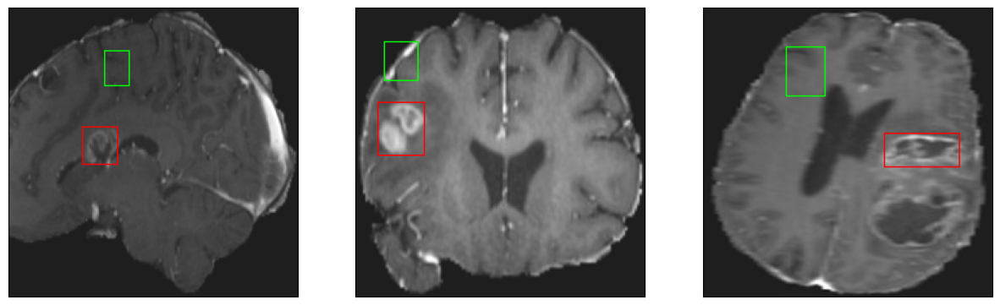

26/26 [==============================] - 3s 108ms/step - loss: 13.4044 - IoU: 0.2953 - val_loss: 36.3209 - val_IoU: 0.0171
Epoch 6/200
26/26 [==============================] - ETA: 0s - loss: 12.2282 - IoU: 0.3327
Epoch 6: val_IoU did not improve from 0.09925
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


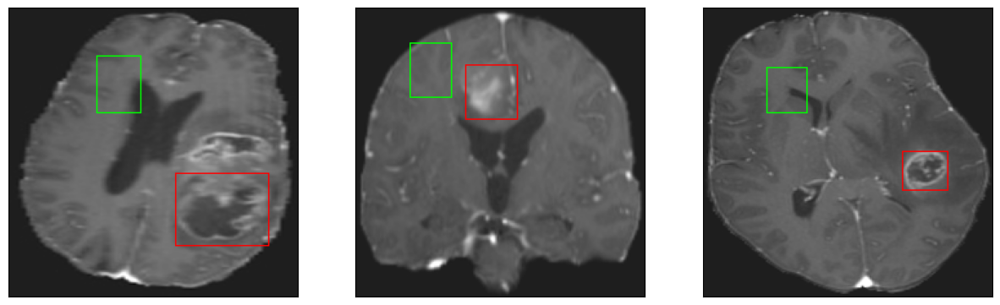

26/26 [==============================] - 3s 96ms/step - loss: 12.2282 - IoU: 0.3327 - val_loss: 32.3784 - val_IoU: 0.0342
Epoch 7/200
26/26 [==============================] - ETA: 0s - loss: 12.1653 - IoU: 0.3428
Epoch 7: val_IoU did not improve from 0.09925
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


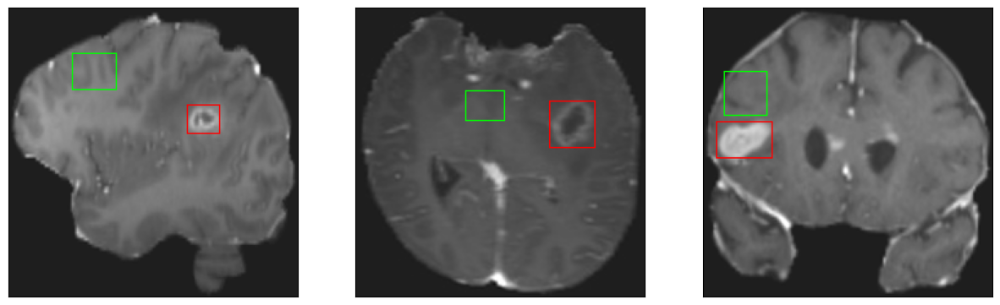

26/26 [==============================] - 2s 85ms/step - loss: 12.1653 - IoU: 0.3428 - val_loss: 29.5429 - val_IoU: 0.0359
Epoch 8/200
25/26 [===========================>..] - ETA: 0s - loss: 11.0150 - IoU: 0.3690
Epoch 8: val_IoU did not improve from 0.09925
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


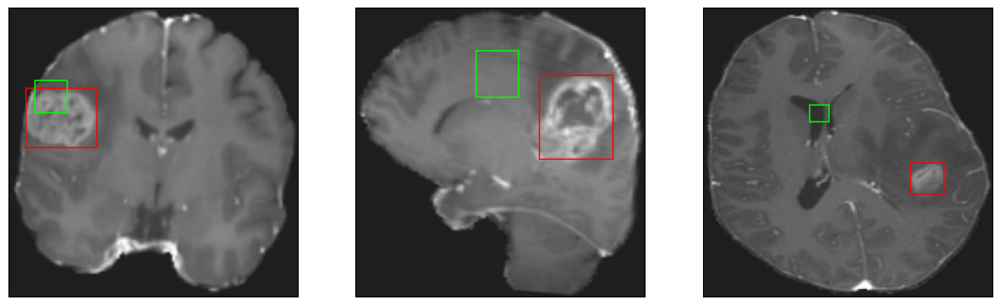

26/26 [==============================] - 2s 92ms/step - loss: 11.0137 - IoU: 0.3698 - val_loss: 29.4840 - val_IoU: 0.0389
Epoch 9/200
25/26 [===========================>..] - ETA: 0s - loss: 10.5869 - IoU: 0.3720
Epoch 9: val_IoU improved from 0.09925 to 0.17394, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


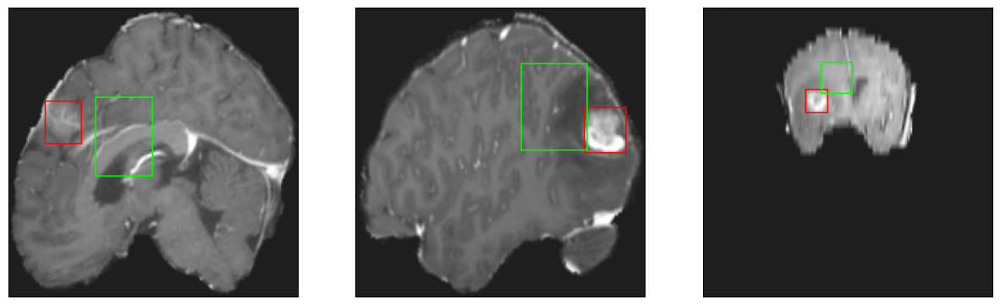

26/26 [==============================] - 3s 107ms/step - loss: 10.5783 - IoU: 0.3721 - val_loss: 18.2429 - val_IoU: 0.1739
Epoch 10/200
26/26 [==============================] - ETA: 0s - loss: 10.7171 - IoU: 0.3632
Epoch 10: val_IoU did not improve from 0.17394
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 22ms/step
4
8/8 [==============================] - 0s 13ms/step
4


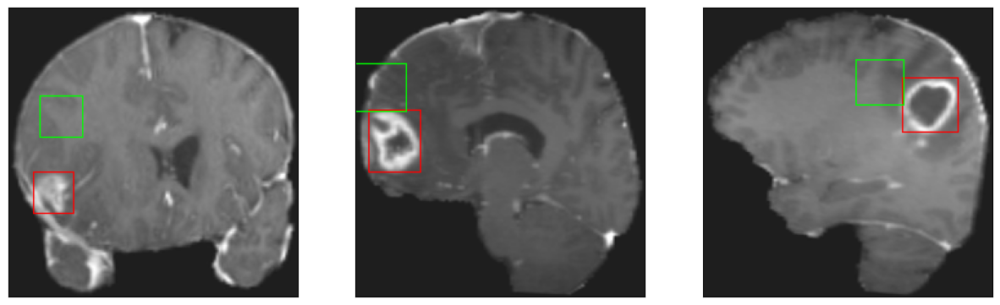

26/26 [==============================] - 4s 167ms/step - loss: 10.7171 - IoU: 0.3632 - val_loss: 26.1197 - val_IoU: 0.0407
Epoch 11/200
26/26 [==============================] - ETA: 0s - loss: 9.9489 - IoU: 0.3906
Epoch 11: val_IoU did not improve from 0.17394
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


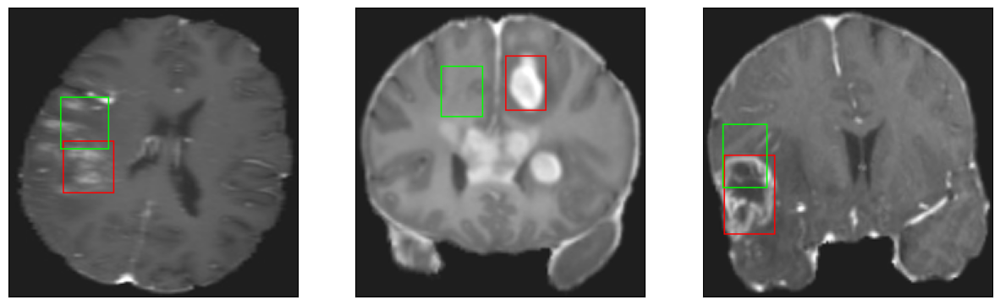

26/26 [==============================] - 3s 119ms/step - loss: 9.9489 - IoU: 0.3906 - val_loss: 19.4161 - val_IoU: 0.1405
Epoch 12/200
25/26 [===========================>..] - ETA: 0s - loss: 9.7904 - IoU: 0.4007
Epoch 12: val_IoU improved from 0.17394 to 0.24309, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


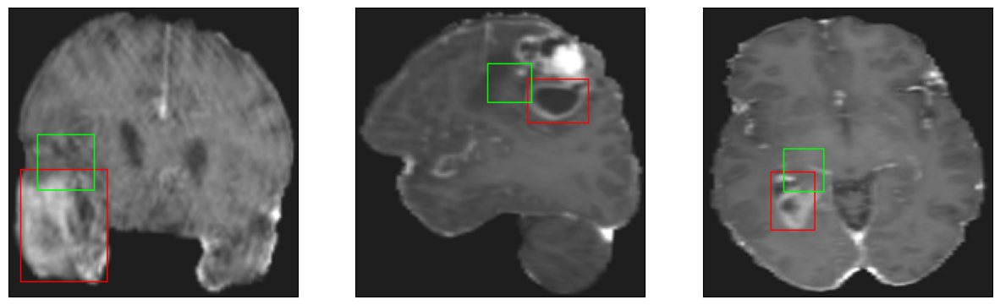

26/26 [==============================] - 3s 108ms/step - loss: 9.7577 - IoU: 0.4008 - val_loss: 15.3183 - val_IoU: 0.2431
Epoch 13/200
25/26 [===========================>..] - ETA: 0s - loss: 9.2732 - IoU: 0.4154
Epoch 13: val_IoU did not improve from 0.24309
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


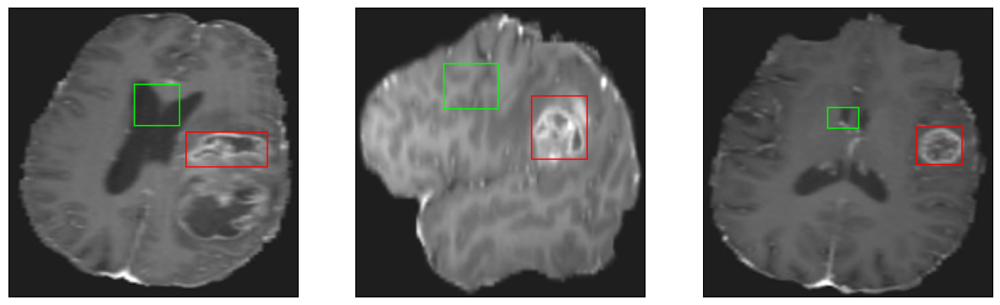

26/26 [==============================] - 2s 86ms/step - loss: 9.2217 - IoU: 0.4160 - val_loss: 26.9696 - val_IoU: 0.0460
Epoch 14/200
25/26 [===========================>..] - ETA: 0s - loss: 9.4733 - IoU: 0.4065
Epoch 14: val_IoU did not improve from 0.24309
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 11ms/step
4


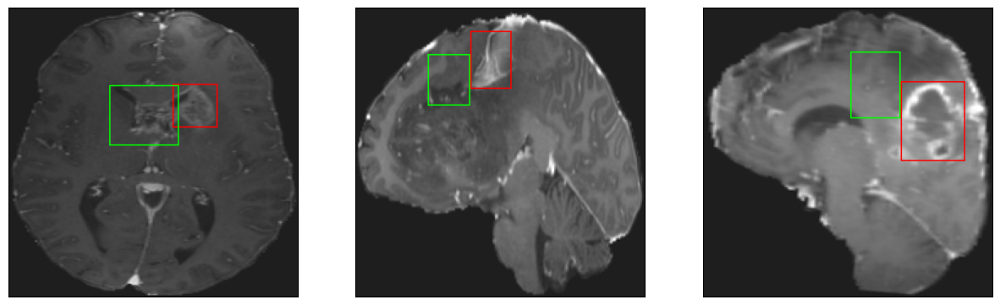

26/26 [==============================] - 2s 93ms/step - loss: 9.4510 - IoU: 0.4087 - val_loss: 16.9790 - val_IoU: 0.2029
Epoch 15/200
25/26 [===========================>..] - ETA: 0s - loss: 8.6663 - IoU: 0.4423
Epoch 15: val_IoU improved from 0.24309 to 0.29606, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4


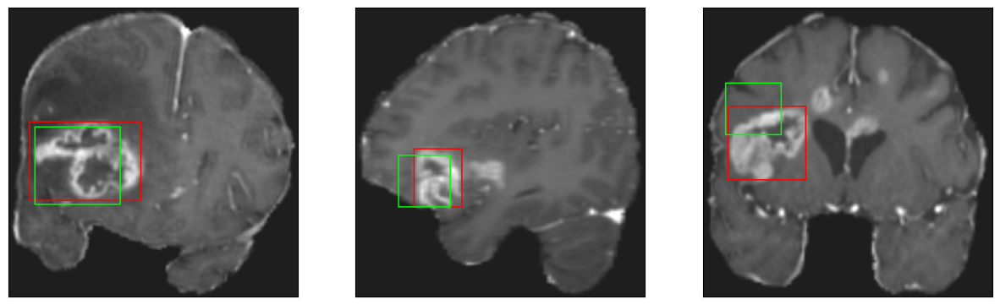

26/26 [==============================] - 3s 128ms/step - loss: 8.6908 - IoU: 0.4426 - val_loss: 13.8618 - val_IoU: 0.2961
Epoch 16/200
26/26 [==============================] - ETA: 0s - loss: 8.7411 - IoU: 0.4426
Epoch 16: val_IoU did not improve from 0.29606
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 10ms/step
4


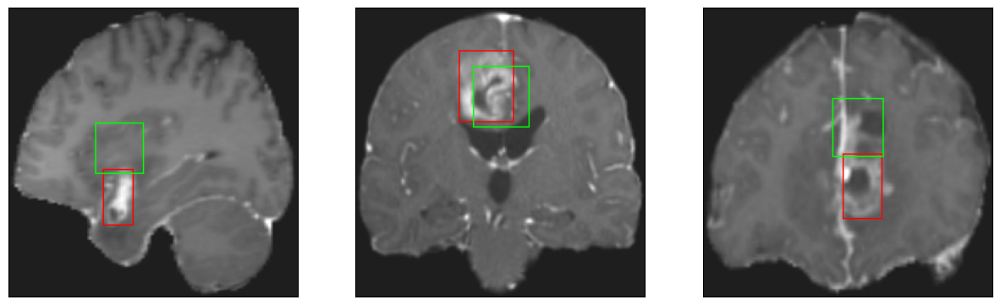

26/26 [==============================] - 3s 94ms/step - loss: 8.7411 - IoU: 0.4426 - val_loss: 15.3682 - val_IoU: 0.2364
Epoch 17/200
25/26 [===========================>..] - ETA: 0s - loss: 8.7071 - IoU: 0.4367
Epoch 17: val_IoU did not improve from 0.29606
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


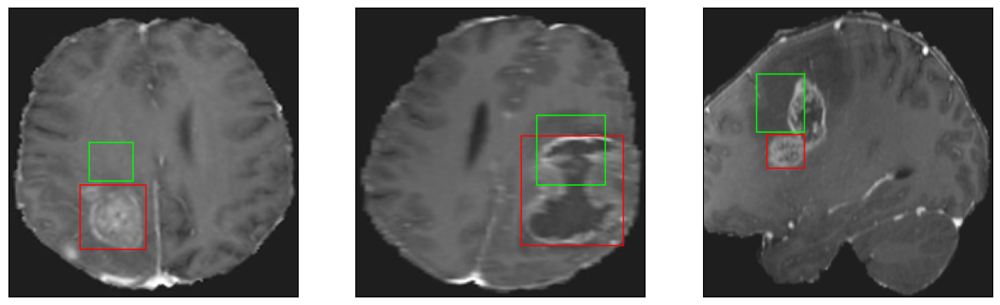

26/26 [==============================] - 2s 96ms/step - loss: 8.7160 - IoU: 0.4340 - val_loss: 15.9451 - val_IoU: 0.2311
Epoch 18/200
26/26 [==============================] - ETA: 0s - loss: 8.5735 - IoU: 0.4469
Epoch 18: val_IoU did not improve from 0.29606
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


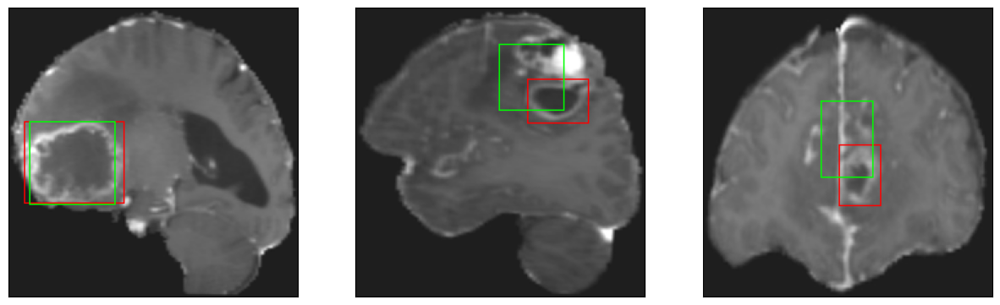

26/26 [==============================] - 3s 98ms/step - loss: 8.5735 - IoU: 0.4469 - val_loss: 15.0679 - val_IoU: 0.2879
Epoch 19/200
25/26 [===========================>..] - ETA: 0s - loss: 8.4034 - IoU: 0.4530
Epoch 19: val_IoU improved from 0.29606 to 0.31580, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


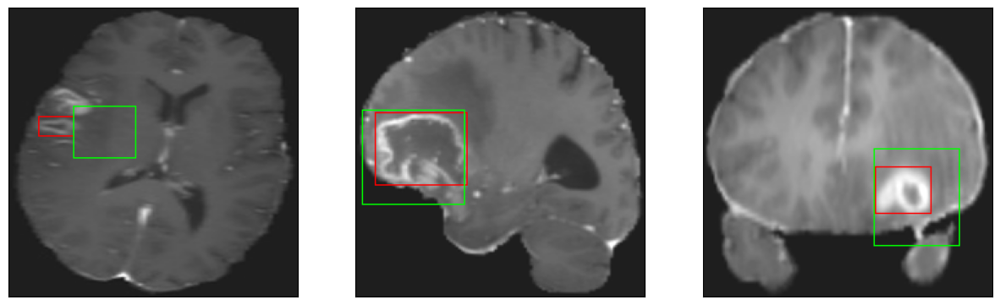

26/26 [==============================] - 3s 122ms/step - loss: 8.3826 - IoU: 0.4554 - val_loss: 14.7789 - val_IoU: 0.3158
Epoch 20/200
25/26 [===========================>..] - ETA: 0s - loss: 8.1520 - IoU: 0.4597
Epoch 20: val_IoU did not improve from 0.31580
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


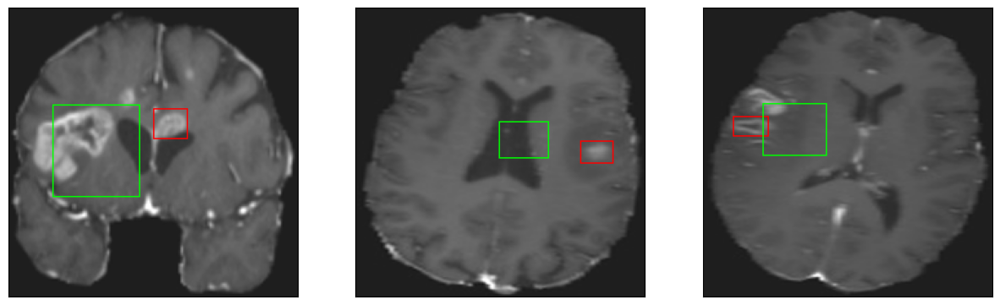

26/26 [==============================] - 3s 113ms/step - loss: 8.1227 - IoU: 0.4610 - val_loss: 20.0359 - val_IoU: 0.1786
Epoch 21/200
25/26 [===========================>..] - ETA: 0s - loss: 8.0560 - IoU: 0.4656
Epoch 21: val_IoU did not improve from 0.31580
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


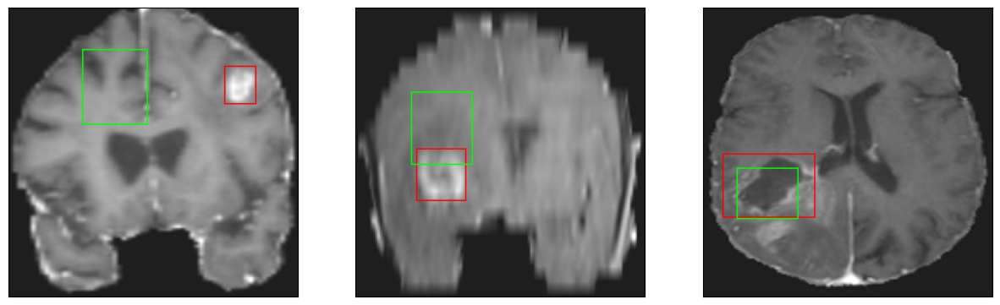

26/26 [==============================] - 3s 99ms/step - loss: 8.0760 - IoU: 0.4650 - val_loss: 15.4912 - val_IoU: 0.2208
Epoch 22/200
25/26 [===========================>..] - ETA: 0s - loss: 7.6558 - IoU: 0.4842
Epoch 22: val_IoU improved from 0.31580 to 0.33179, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


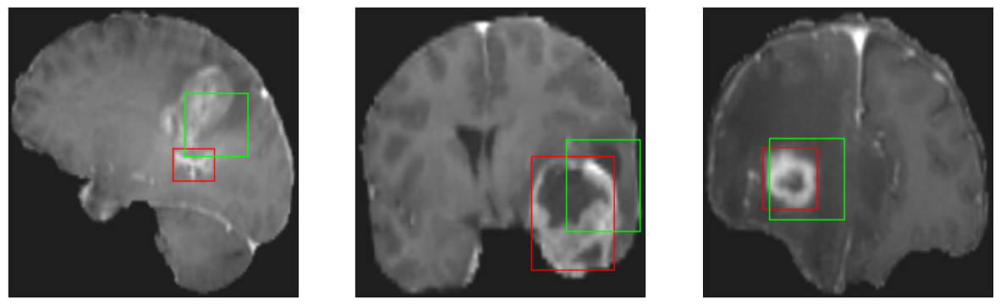

26/26 [==============================] - 4s 142ms/step - loss: 7.6504 - IoU: 0.4838 - val_loss: 14.1066 - val_IoU: 0.3318
Epoch 23/200
26/26 [==============================] - ETA: 0s - loss: 7.4890 - IoU: 0.4977
Epoch 23: val_IoU improved from 0.33179 to 0.34533, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


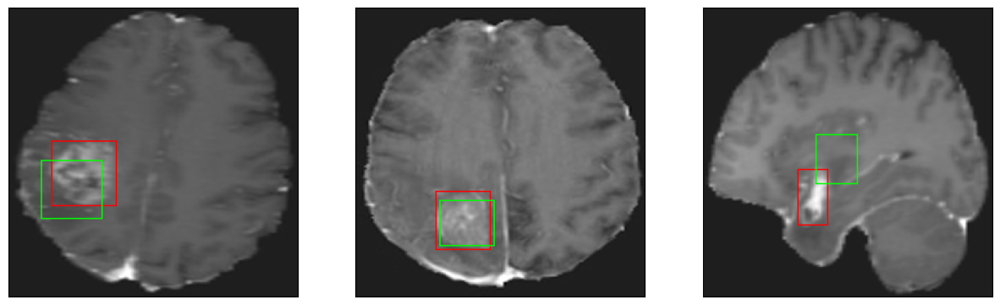

26/26 [==============================] - 3s 98ms/step - loss: 7.4890 - IoU: 0.4977 - val_loss: 12.5109 - val_IoU: 0.3453
Epoch 24/200
25/26 [===========================>..] - ETA: 0s - loss: 7.5897 - IoU: 0.4877
Epoch 24: val_IoU did not improve from 0.34533
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


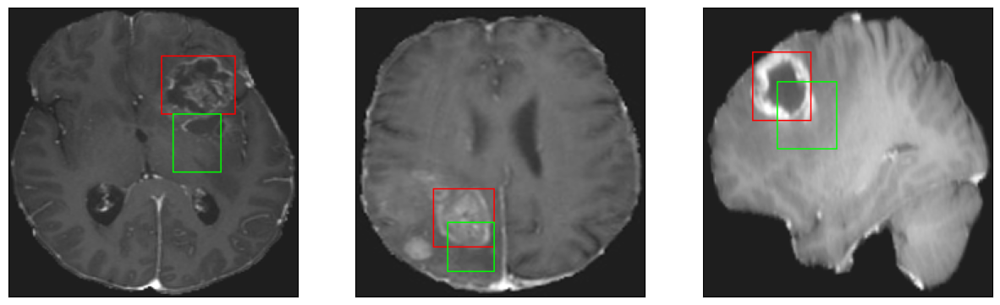

26/26 [==============================] - 3s 98ms/step - loss: 7.6612 - IoU: 0.4853 - val_loss: 13.5269 - val_IoU: 0.3092
Epoch 25/200
25/26 [===========================>..] - ETA: 0s - loss: 7.3874 - IoU: 0.4954
Epoch 25: val_IoU did not improve from 0.34533
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


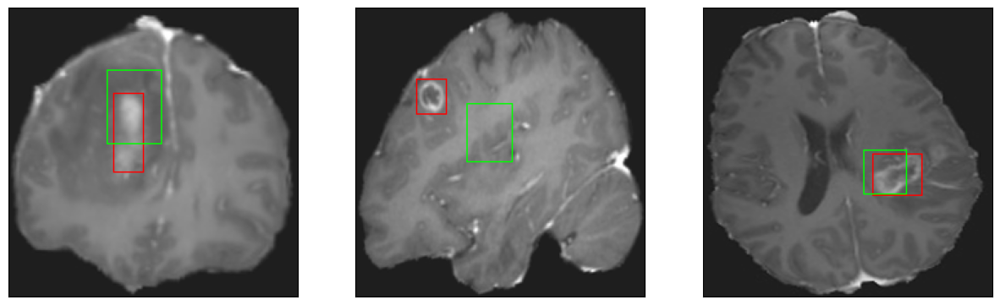

26/26 [==============================] - 3s 118ms/step - loss: 7.4025 - IoU: 0.4948 - val_loss: 12.9812 - val_IoU: 0.3359
Epoch 26/200
25/26 [===========================>..] - ETA: 0s - loss: 7.4748 - IoU: 0.4906
Epoch 26: val_IoU did not improve from 0.34533
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


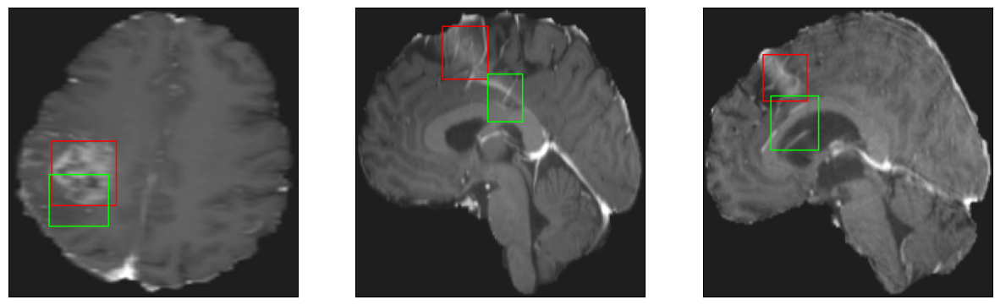

26/26 [==============================] - 3s 111ms/step - loss: 7.4567 - IoU: 0.4896 - val_loss: 12.7615 - val_IoU: 0.3276
Epoch 27/200
25/26 [===========================>..] - ETA: 0s - loss: 7.2081 - IoU: 0.5034
Epoch 27: val_IoU did not improve from 0.34533
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


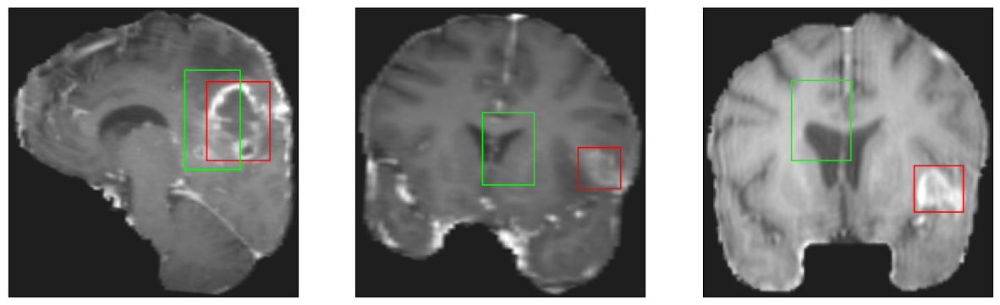

26/26 [==============================] - 2s 95ms/step - loss: 7.2395 - IoU: 0.4988 - val_loss: 16.9649 - val_IoU: 0.2355
Epoch 28/200
26/26 [==============================] - ETA: 0s - loss: 7.2723 - IoU: 0.4978
Epoch 28: val_IoU improved from 0.34533 to 0.35480, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


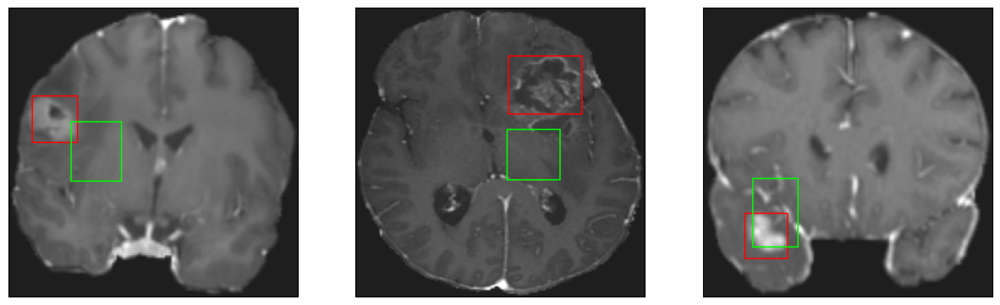

26/26 [==============================] - 3s 111ms/step - loss: 7.2723 - IoU: 0.4978 - val_loss: 13.3580 - val_IoU: 0.3548
Epoch 29/200
25/26 [===========================>..] - ETA: 0s - loss: 7.0430 - IoU: 0.5090
Epoch 29: val_IoU did not improve from 0.35480
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


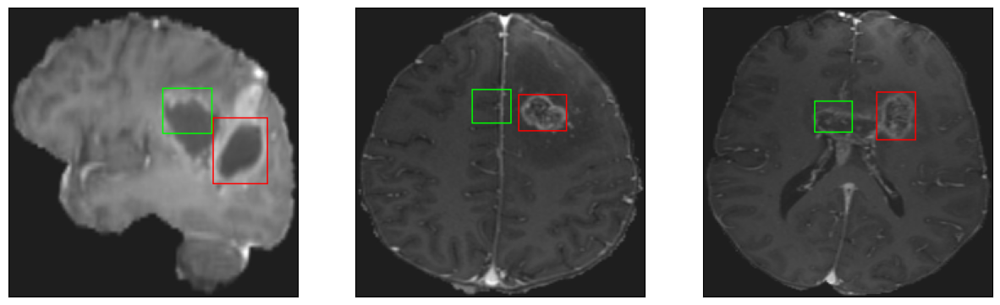

26/26 [==============================] - 3s 117ms/step - loss: 7.1004 - IoU: 0.5063 - val_loss: 17.8882 - val_IoU: 0.1642
Epoch 30/200
25/26 [===========================>..] - ETA: 0s - loss: 6.9884 - IoU: 0.5173
Epoch 30: val_IoU improved from 0.35480 to 0.36180, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


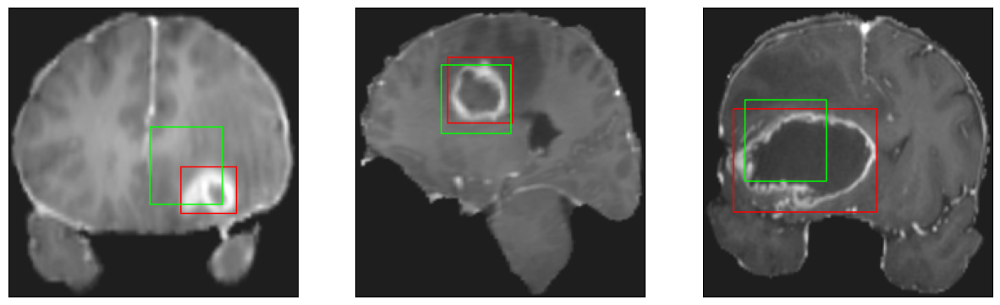

26/26 [==============================] - 3s 109ms/step - loss: 6.9849 - IoU: 0.5175 - val_loss: 12.4366 - val_IoU: 0.3618
Epoch 31/200
26/26 [==============================] - ETA: 0s - loss: 6.8665 - IoU: 0.5217
Epoch 31: val_IoU did not improve from 0.36180
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


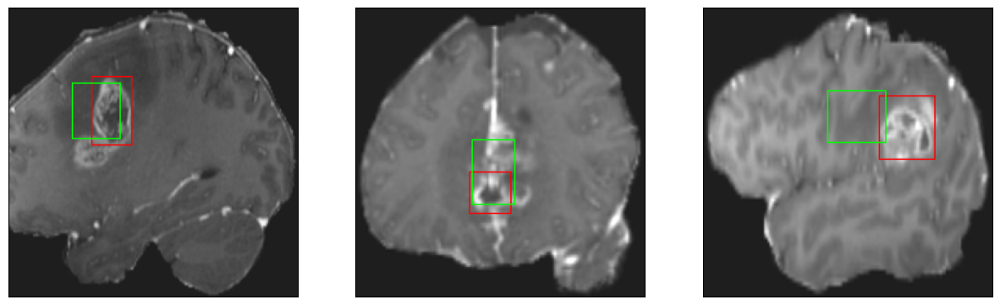

26/26 [==============================] - 2s 91ms/step - loss: 6.8665 - IoU: 0.5217 - val_loss: 12.7390 - val_IoU: 0.3375
Epoch 32/200
26/26 [==============================] - ETA: 0s - loss: 7.1860 - IoU: 0.5102
Epoch 32: val_IoU did not improve from 0.36180
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


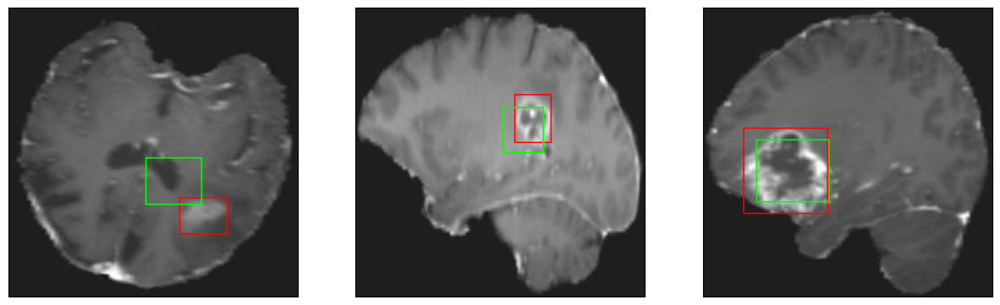

26/26 [==============================] - 3s 104ms/step - loss: 7.1860 - IoU: 0.5102 - val_loss: 12.8067 - val_IoU: 0.3329
Epoch 33/200
26/26 [==============================] - ETA: 0s - loss: 7.0631 - IoU: 0.5061
Epoch 33: val_IoU did not improve from 0.36180
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


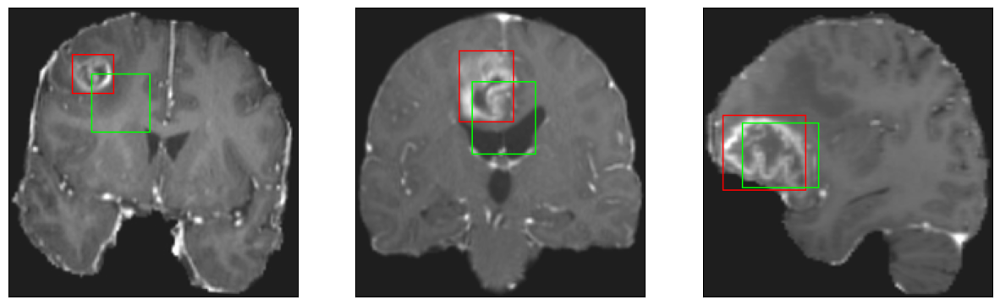

26/26 [==============================] - 3s 122ms/step - loss: 7.0631 - IoU: 0.5061 - val_loss: 12.8481 - val_IoU: 0.3322
Epoch 34/200
26/26 [==============================] - ETA: 0s - loss: 6.9119 - IoU: 0.5198
Epoch 34: val_IoU did not improve from 0.36180
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


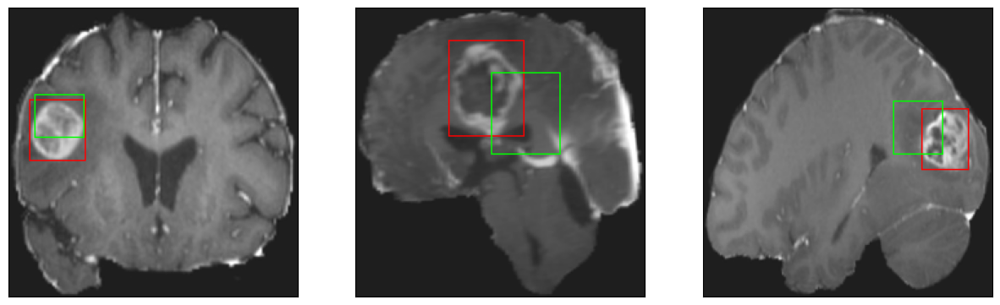

26/26 [==============================] - 3s 117ms/step - loss: 6.9119 - IoU: 0.5198 - val_loss: 12.3749 - val_IoU: 0.3513
Epoch 35/200
25/26 [===========================>..] - ETA: 0s - loss: 6.5335 - IoU: 0.5313
Epoch 35: val_IoU improved from 0.36180 to 0.37713, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


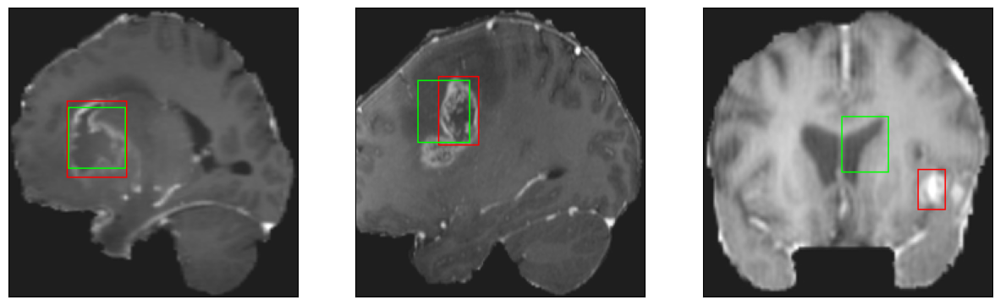

26/26 [==============================] - 3s 119ms/step - loss: 6.5456 - IoU: 0.5302 - val_loss: 11.9881 - val_IoU: 0.3771
Epoch 36/200
26/26 [==============================] - ETA: 0s - loss: 6.7011 - IoU: 0.5251
Epoch 36: val_IoU did not improve from 0.37713
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


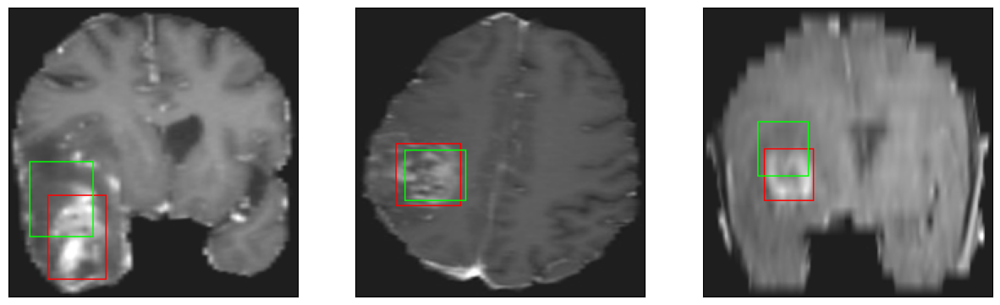

26/26 [==============================] - 3s 104ms/step - loss: 6.7011 - IoU: 0.5251 - val_loss: 12.7190 - val_IoU: 0.3320
Epoch 37/200
26/26 [==============================] - ETA: 0s - loss: 6.7334 - IoU: 0.5255
Epoch 37: val_IoU did not improve from 0.37713
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


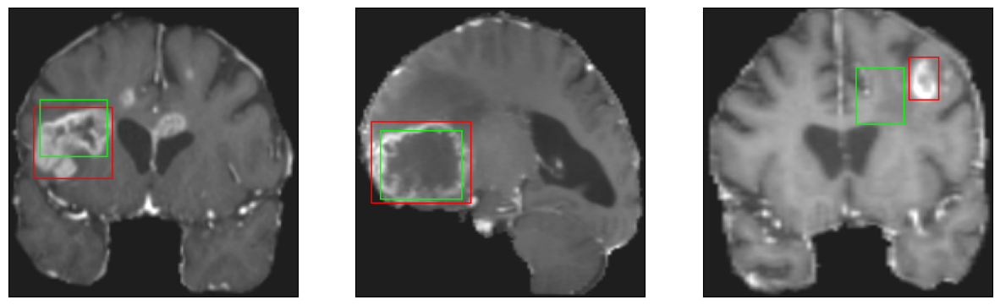

26/26 [==============================] - 3s 116ms/step - loss: 6.7334 - IoU: 0.5255 - val_loss: 12.5836 - val_IoU: 0.3395
Epoch 38/200
25/26 [===========================>..] - ETA: 0s - loss: 6.3562 - IoU: 0.5462
Epoch 38: val_IoU did not improve from 0.37713
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


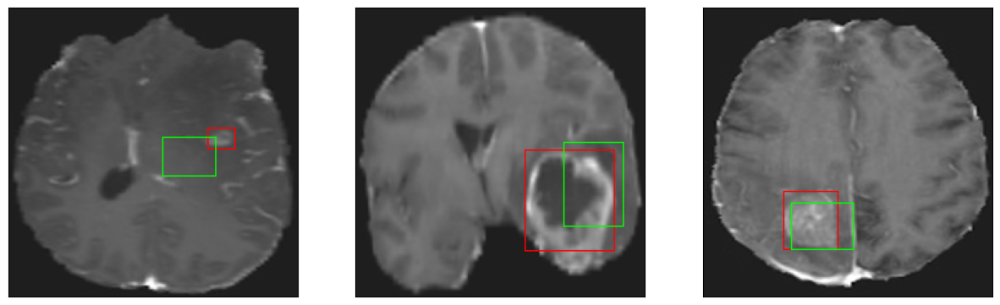

26/26 [==============================] - 3s 130ms/step - loss: 6.3842 - IoU: 0.5440 - val_loss: 12.2432 - val_IoU: 0.3652
Epoch 39/200
25/26 [===========================>..] - ETA: 0s - loss: 6.3713 - IoU: 0.5438
Epoch 39: val_IoU did not improve from 0.37713
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


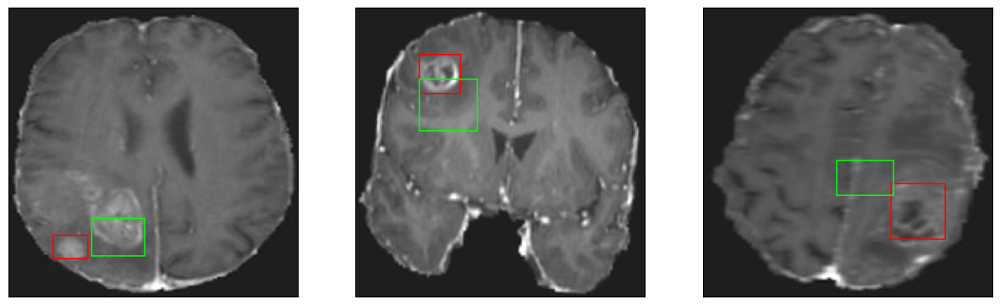

26/26 [==============================] - 3s 105ms/step - loss: 6.3588 - IoU: 0.5449 - val_loss: 12.0903 - val_IoU: 0.3707
Epoch 40/200
25/26 [===========================>..] - ETA: 0s - loss: 6.3547 - IoU: 0.5404
Epoch 40: val_IoU did not improve from 0.37713
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


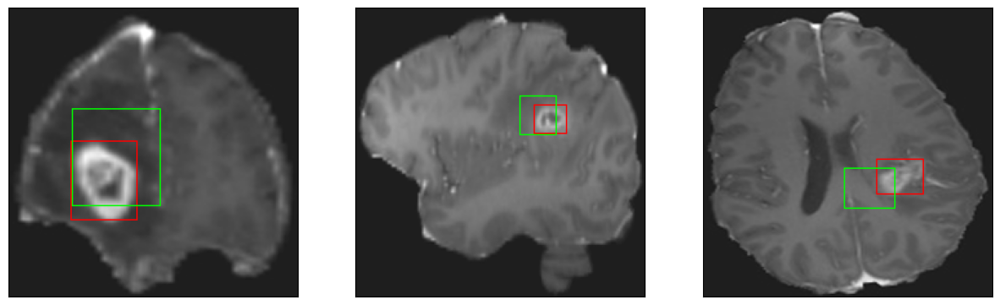

26/26 [==============================] - 3s 102ms/step - loss: 6.3724 - IoU: 0.5390 - val_loss: 11.7853 - val_IoU: 0.3728
Epoch 41/200
25/26 [===========================>..] - ETA: 0s - loss: 6.2794 - IoU: 0.5437
Epoch 41: val_IoU did not improve from 0.37713
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


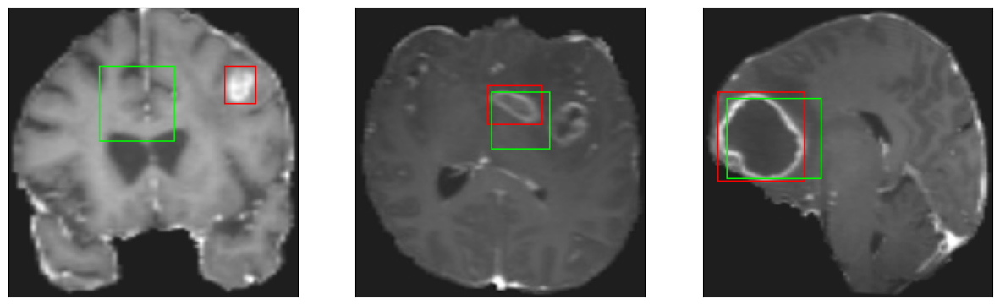

26/26 [==============================] - 3s 111ms/step - loss: 6.3102 - IoU: 0.5444 - val_loss: 13.9859 - val_IoU: 0.3041
Epoch 42/200
26/26 [==============================] - ETA: 0s - loss: 6.5073 - IoU: 0.5393
Epoch 42: val_IoU did not improve from 0.37713
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4


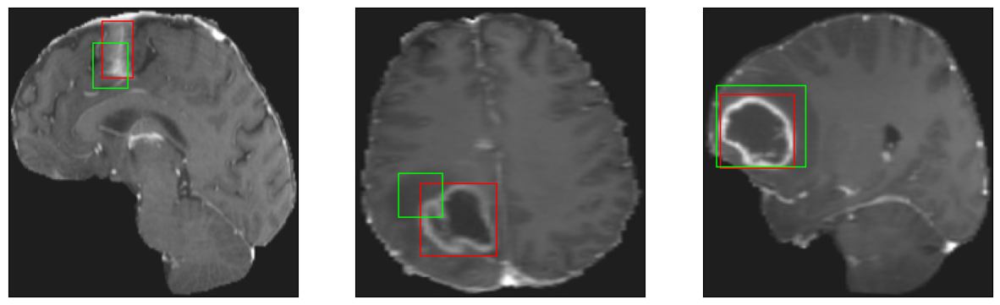

26/26 [==============================] - 4s 137ms/step - loss: 6.5073 - IoU: 0.5393 - val_loss: 15.1598 - val_IoU: 0.2305
Epoch 43/200
25/26 [===========================>..] - ETA: 0s - loss: 5.7703 - IoU: 0.5732
Epoch 43: val_IoU did not improve from 0.37713
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


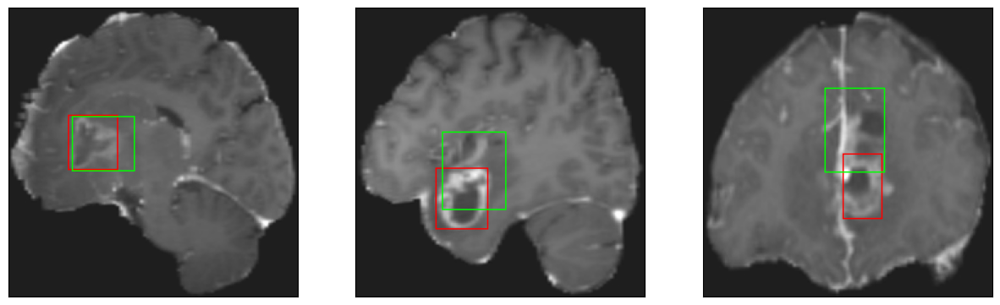

26/26 [==============================] - 3s 103ms/step - loss: 5.8206 - IoU: 0.5721 - val_loss: 17.3038 - val_IoU: 0.2583
Epoch 44/200
25/26 [===========================>..] - ETA: 0s - loss: 5.9286 - IoU: 0.5624
Epoch 44: val_IoU did not improve from 0.37713
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


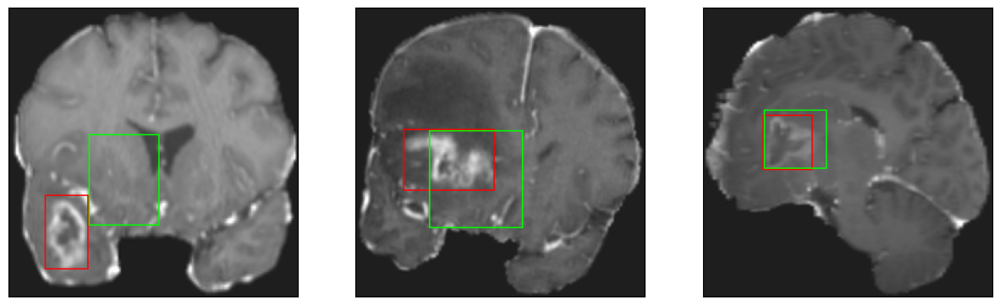

26/26 [==============================] - 3s 105ms/step - loss: 5.9701 - IoU: 0.5616 - val_loss: 19.2603 - val_IoU: 0.2436
Epoch 45/200
26/26 [==============================] - ETA: 0s - loss: 6.2080 - IoU: 0.5587
Epoch 45: val_IoU did not improve from 0.37713
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


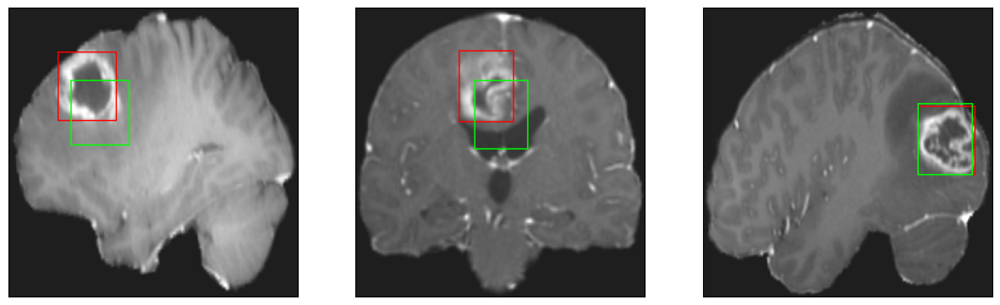

26/26 [==============================] - 3s 116ms/step - loss: 6.2080 - IoU: 0.5587 - val_loss: 12.3717 - val_IoU: 0.3408
Epoch 46/200
25/26 [===========================>..] - ETA: 0s - loss: 6.1295 - IoU: 0.5594
Epoch 46: val_IoU did not improve from 0.37713
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4


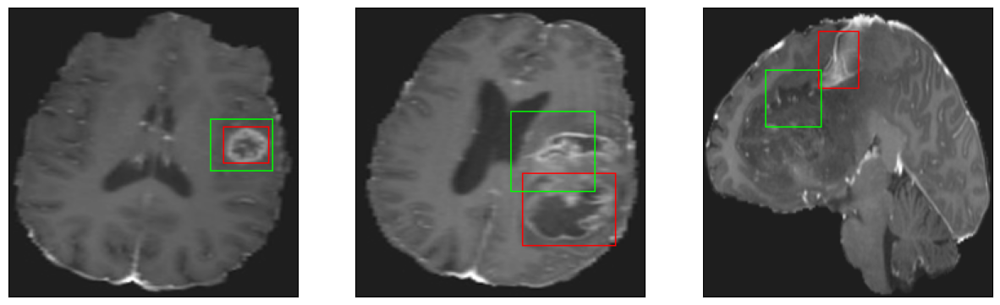

26/26 [==============================] - 3s 105ms/step - loss: 6.0916 - IoU: 0.5596 - val_loss: 12.7393 - val_IoU: 0.3454
Epoch 47/200
26/26 [==============================] - ETA: 0s - loss: 6.1225 - IoU: 0.5583
Epoch 47: val_IoU did not improve from 0.37713
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


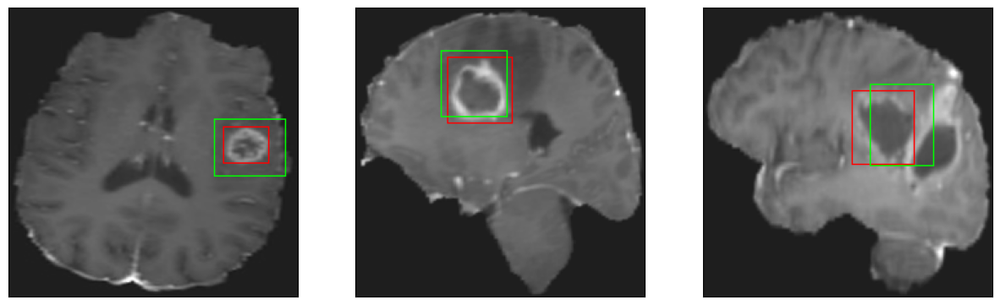

26/26 [==============================] - 3s 100ms/step - loss: 6.1225 - IoU: 0.5583 - val_loss: 13.9318 - val_IoU: 0.3311
Epoch 48/200
25/26 [===========================>..] - ETA: 0s - loss: 6.3483 - IoU: 0.5405
Epoch 48: val_IoU did not improve from 0.37713
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


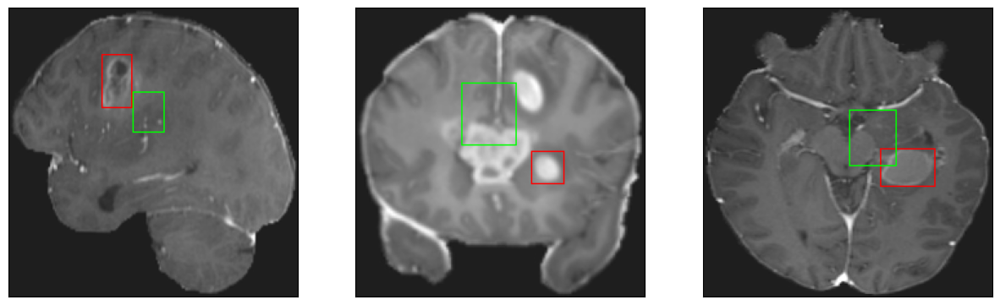

26/26 [==============================] - 3s 103ms/step - loss: 6.3626 - IoU: 0.5403 - val_loss: 12.2546 - val_IoU: 0.3525
Epoch 49/200
26/26 [==============================] - ETA: 0s - loss: 5.9933 - IoU: 0.5622
Epoch 49: val_IoU did not improve from 0.37713
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


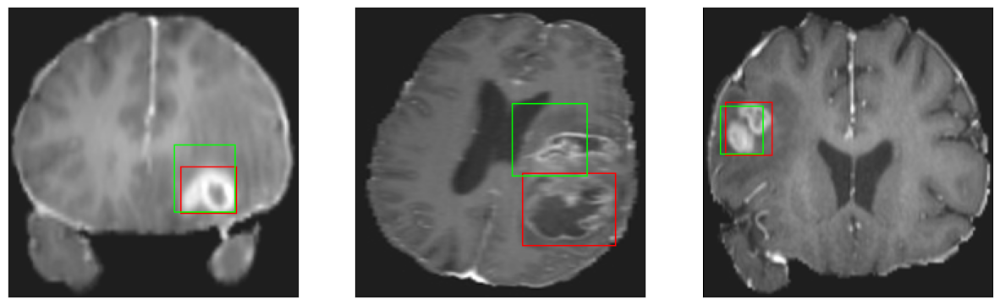

26/26 [==============================] - 3s 113ms/step - loss: 5.9933 - IoU: 0.5622 - val_loss: 12.0158 - val_IoU: 0.3742
Epoch 50/200
25/26 [===========================>..] - ETA: 0s - loss: 6.0137 - IoU: 0.5615
Epoch 50: val_IoU improved from 0.37713 to 0.38289, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


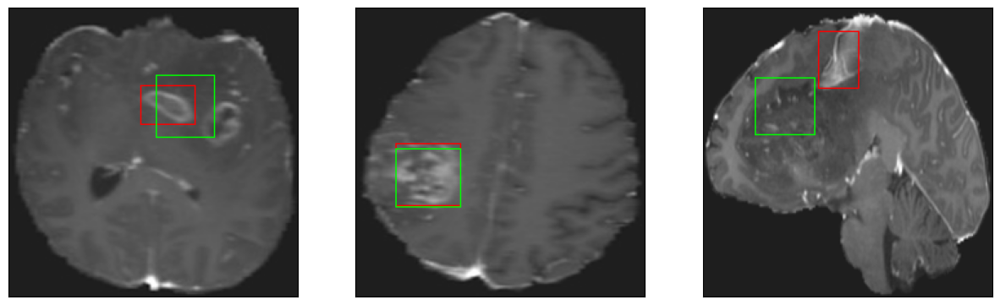

26/26 [==============================] - 3s 132ms/step - loss: 6.0186 - IoU: 0.5610 - val_loss: 11.9939 - val_IoU: 0.3829
Epoch 51/200
26/26 [==============================] - ETA: 0s - loss: 6.0003 - IoU: 0.5519
Epoch 51: val_IoU did not improve from 0.38289
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


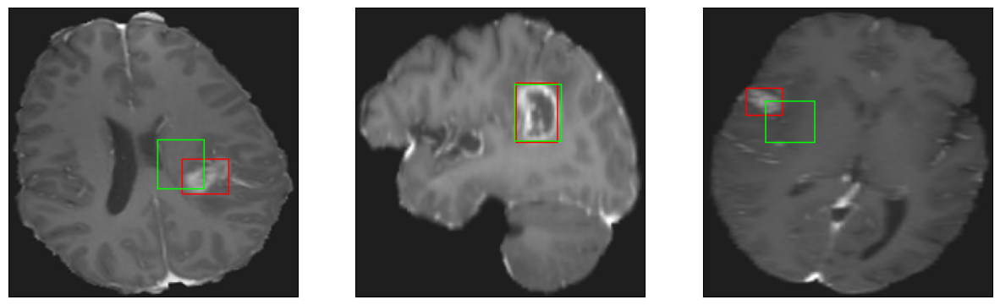

26/26 [==============================] - 3s 107ms/step - loss: 6.0003 - IoU: 0.5519 - val_loss: 11.9145 - val_IoU: 0.3686
Epoch 52/200
26/26 [==============================] - ETA: 0s - loss: 6.1357 - IoU: 0.5557
Epoch 52: val_IoU improved from 0.38289 to 0.39955, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


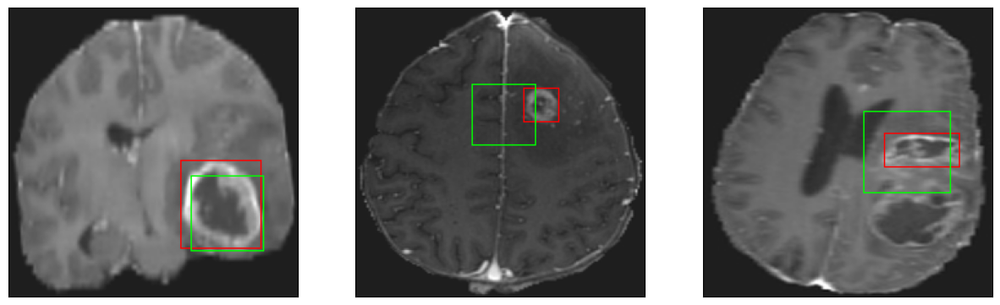

26/26 [==============================] - 3s 131ms/step - loss: 6.1357 - IoU: 0.5557 - val_loss: 11.5417 - val_IoU: 0.3996
Epoch 53/200
25/26 [===========================>..] - ETA: 0s - loss: 5.8544 - IoU: 0.5669
Epoch 53: val_IoU did not improve from 0.39955
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


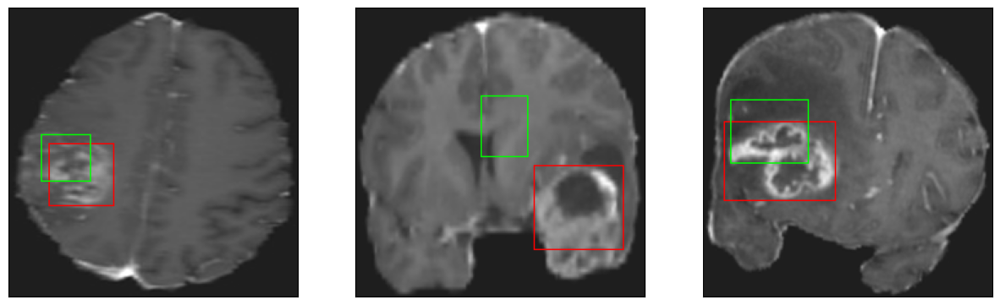

26/26 [==============================] - 3s 123ms/step - loss: 5.9073 - IoU: 0.5652 - val_loss: 19.9592 - val_IoU: 0.1293
Epoch 54/200
26/26 [==============================] - ETA: 0s - loss: 5.8212 - IoU: 0.5678
Epoch 54: val_IoU did not improve from 0.39955
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


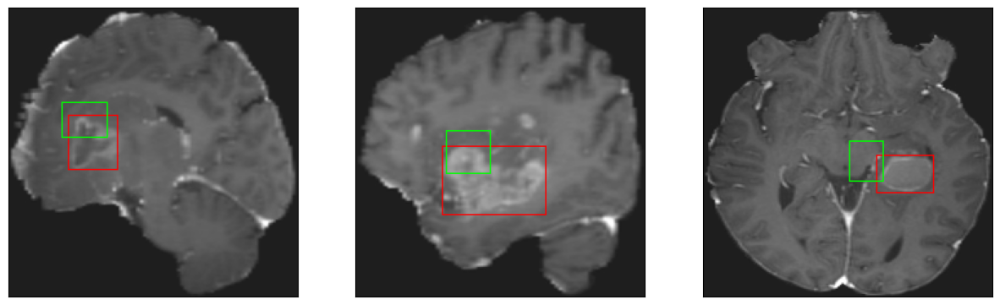

26/26 [==============================] - 3s 108ms/step - loss: 5.8212 - IoU: 0.5678 - val_loss: 13.3190 - val_IoU: 0.3041
Epoch 55/200
26/26 [==============================] - ETA: 0s - loss: 5.6958 - IoU: 0.5687
Epoch 55: val_IoU did not improve from 0.39955
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


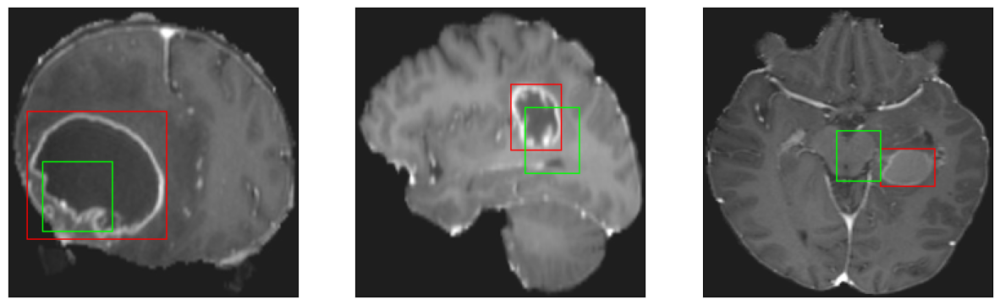

26/26 [==============================] - 3s 98ms/step - loss: 5.6958 - IoU: 0.5687 - val_loss: 12.2472 - val_IoU: 0.3788
Epoch 56/200
26/26 [==============================] - ETA: 0s - loss: 6.0053 - IoU: 0.5762
Epoch 56: val_IoU did not improve from 0.39955
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


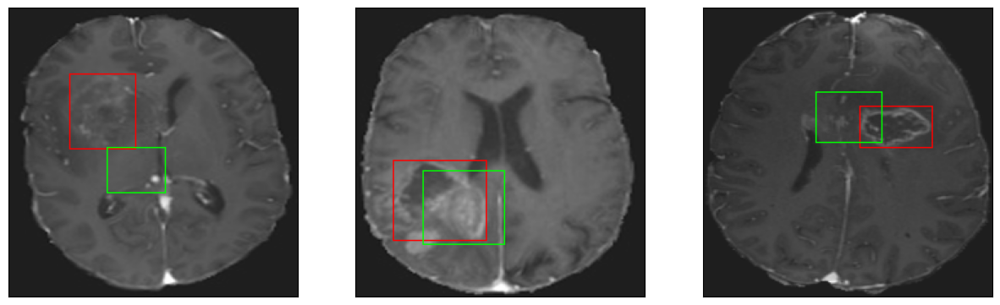

26/26 [==============================] - 3s 132ms/step - loss: 6.0053 - IoU: 0.5762 - val_loss: 22.4673 - val_IoU: 0.1919
Epoch 57/200
26/26 [==============================] - ETA: 0s - loss: 6.4265 - IoU: 0.5396
Epoch 57: val_IoU did not improve from 0.39955
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


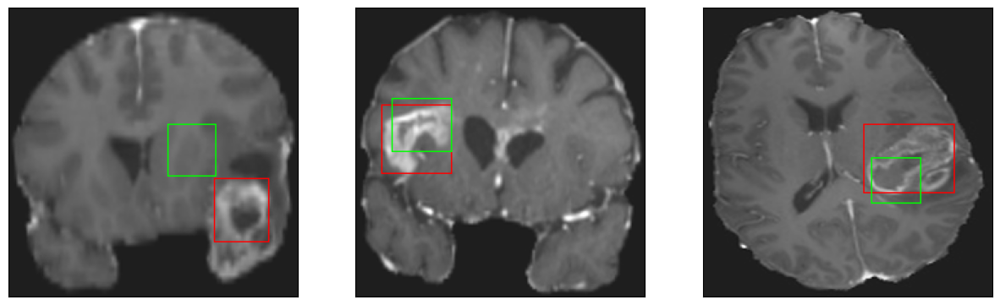

26/26 [==============================] - 3s 107ms/step - loss: 6.4265 - IoU: 0.5396 - val_loss: 14.6738 - val_IoU: 0.2699
Epoch 58/200
25/26 [===========================>..] - ETA: 0s - loss: 5.7824 - IoU: 0.5764
Epoch 58: val_IoU did not improve from 0.39955
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


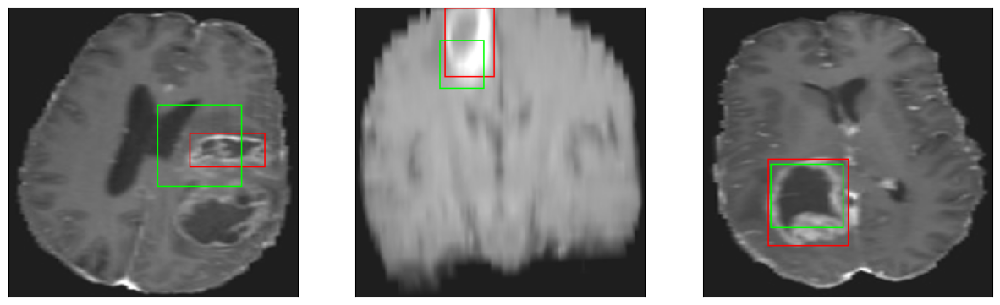

26/26 [==============================] - 3s 102ms/step - loss: 5.7769 - IoU: 0.5753 - val_loss: 12.6374 - val_IoU: 0.3466
Epoch 59/200
25/26 [===========================>..] - ETA: 0s - loss: 5.8274 - IoU: 0.5615
Epoch 59: val_IoU did not improve from 0.39955
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


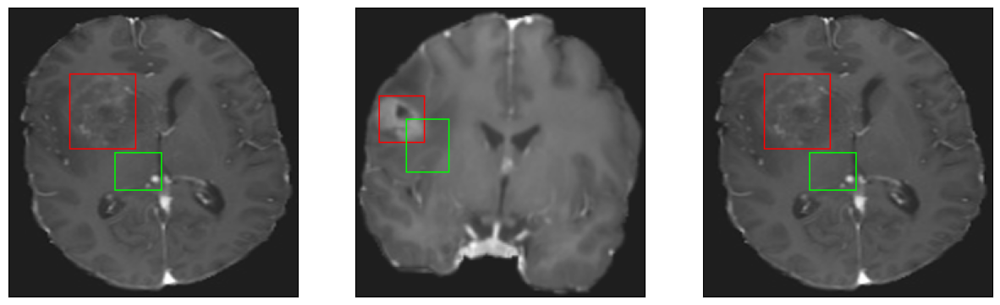

26/26 [==============================] - 3s 128ms/step - loss: 5.8836 - IoU: 0.5615 - val_loss: 11.5509 - val_IoU: 0.3877
Epoch 60/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5451 - IoU: 0.5897
Epoch 60: val_IoU did not improve from 0.39955
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


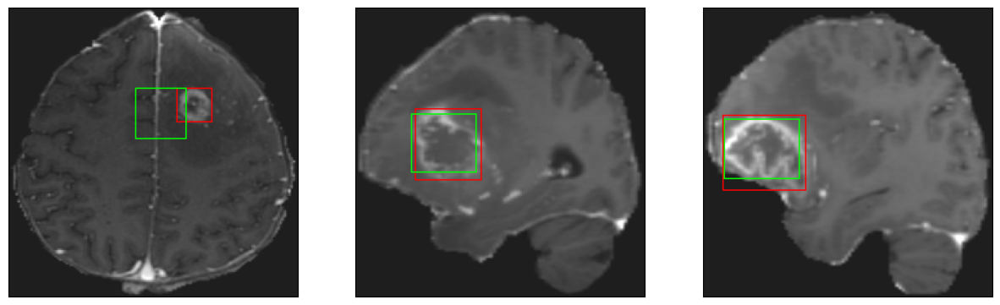

26/26 [==============================] - 3s 99ms/step - loss: 5.5290 - IoU: 0.5908 - val_loss: 11.5519 - val_IoU: 0.3922
Epoch 61/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2886 - IoU: 0.5947
Epoch 61: val_IoU did not improve from 0.39955
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


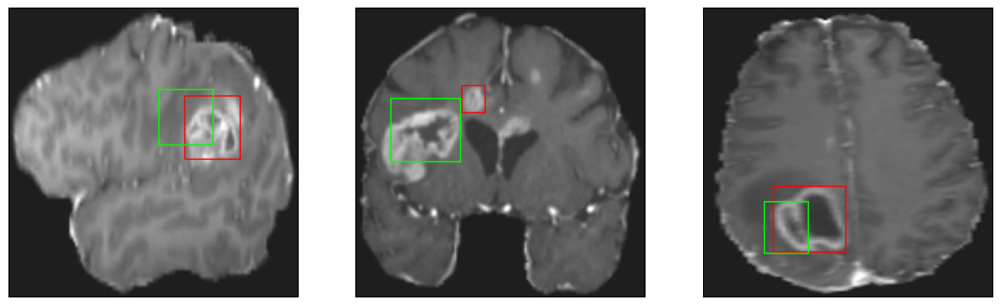

26/26 [==============================] - 3s 113ms/step - loss: 5.3292 - IoU: 0.5933 - val_loss: 11.8276 - val_IoU: 0.3748
Epoch 62/200
25/26 [===========================>..] - ETA: 0s - loss: 5.7295 - IoU: 0.5734
Epoch 62: val_IoU did not improve from 0.39955
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


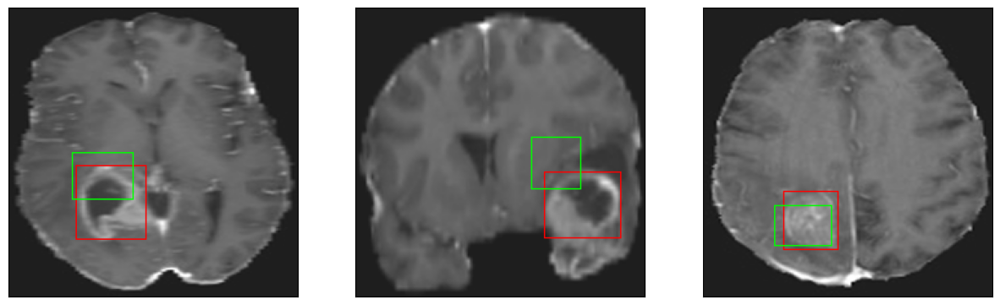

26/26 [==============================] - 3s 118ms/step - loss: 5.7944 - IoU: 0.5733 - val_loss: 12.6921 - val_IoU: 0.3508
Epoch 63/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5540 - IoU: 0.5853
Epoch 63: val_IoU did not improve from 0.39955
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


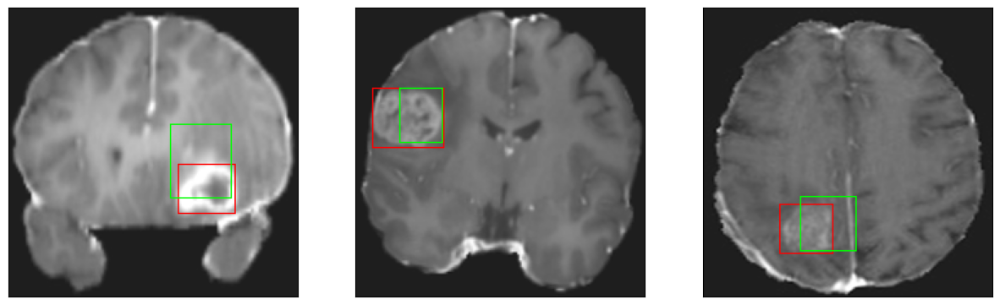

26/26 [==============================] - 3s 103ms/step - loss: 5.5607 - IoU: 0.5863 - val_loss: 12.4557 - val_IoU: 0.3637
Epoch 64/200
26/26 [==============================] - ETA: 0s - loss: 5.2760 - IoU: 0.5988
Epoch 64: val_IoU improved from 0.39955 to 0.41605, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


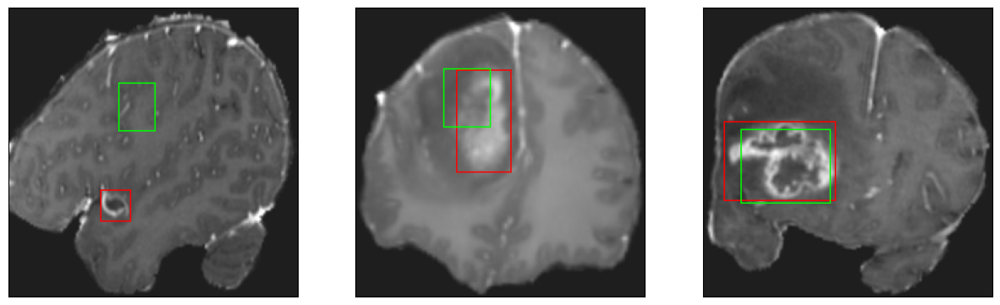

26/26 [==============================] - 3s 122ms/step - loss: 5.2760 - IoU: 0.5988 - val_loss: 11.3954 - val_IoU: 0.4161
Epoch 65/200
26/26 [==============================] - ETA: 0s - loss: 5.3929 - IoU: 0.5971
Epoch 65: val_IoU improved from 0.41605 to 0.42636, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


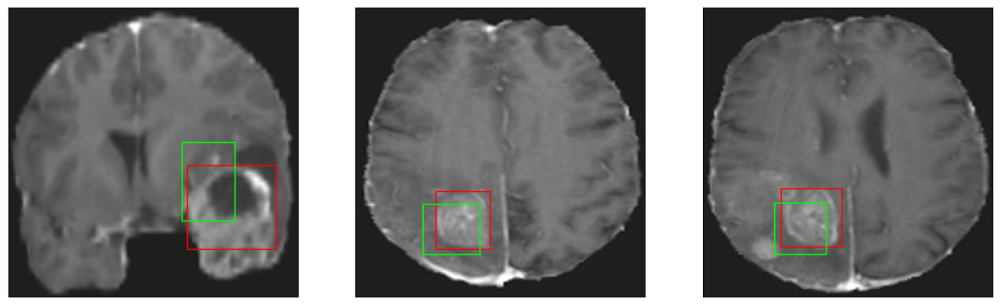

26/26 [==============================] - 4s 137ms/step - loss: 5.3929 - IoU: 0.5971 - val_loss: 11.1259 - val_IoU: 0.4264
Epoch 66/200
26/26 [==============================] - ETA: 0s - loss: 5.4325 - IoU: 0.6019
Epoch 66: val_IoU did not improve from 0.42636
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


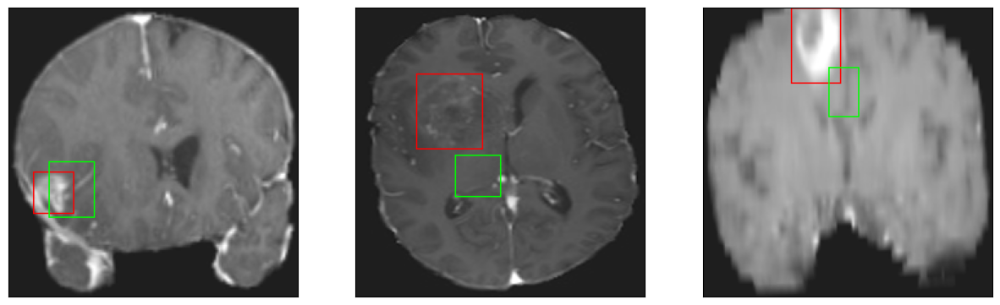

26/26 [==============================] - 3s 123ms/step - loss: 5.4325 - IoU: 0.6019 - val_loss: 11.0326 - val_IoU: 0.4167
Epoch 67/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3035 - IoU: 0.5968
Epoch 67: val_IoU did not improve from 0.42636
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


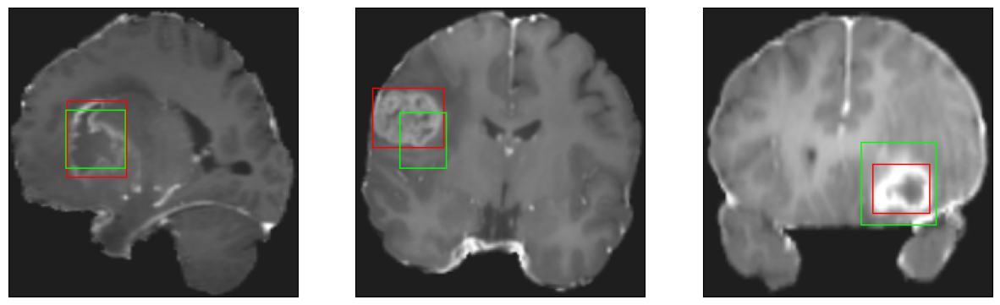

26/26 [==============================] - 3s 100ms/step - loss: 5.2810 - IoU: 0.5993 - val_loss: 11.3386 - val_IoU: 0.4067
Epoch 68/200
25/26 [===========================>..] - ETA: 0s - loss: 5.4194 - IoU: 0.5895
Epoch 68: val_IoU did not improve from 0.42636
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


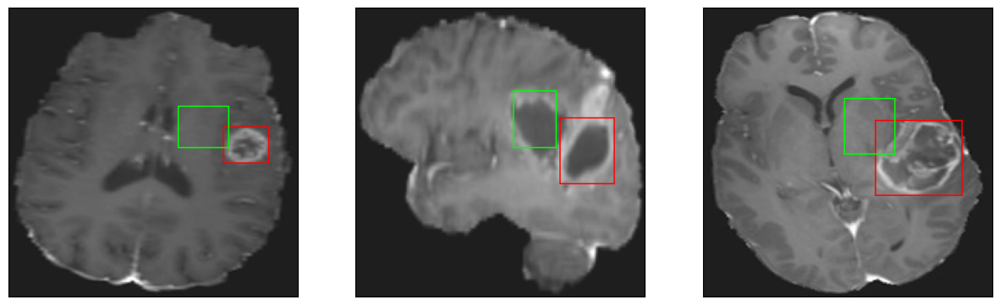

26/26 [==============================] - 3s 114ms/step - loss: 5.5406 - IoU: 0.5846 - val_loss: 18.0053 - val_IoU: 0.1555
Epoch 69/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5606 - IoU: 0.5893
Epoch 69: val_IoU did not improve from 0.42636
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


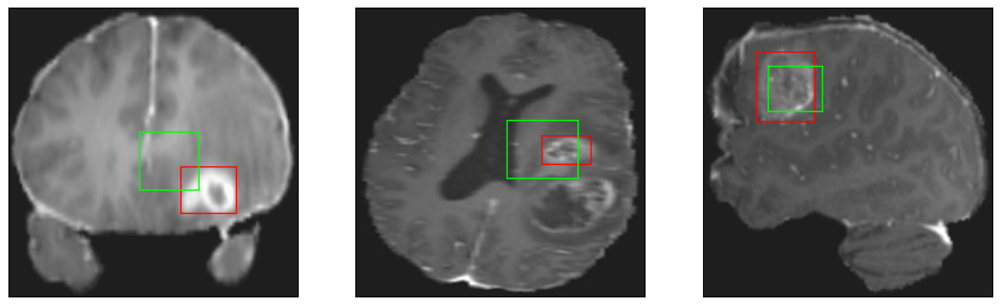

26/26 [==============================] - 3s 116ms/step - loss: 5.5585 - IoU: 0.5893 - val_loss: 12.3007 - val_IoU: 0.3496
Epoch 70/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2908 - IoU: 0.6078
Epoch 70: val_IoU did not improve from 0.42636
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


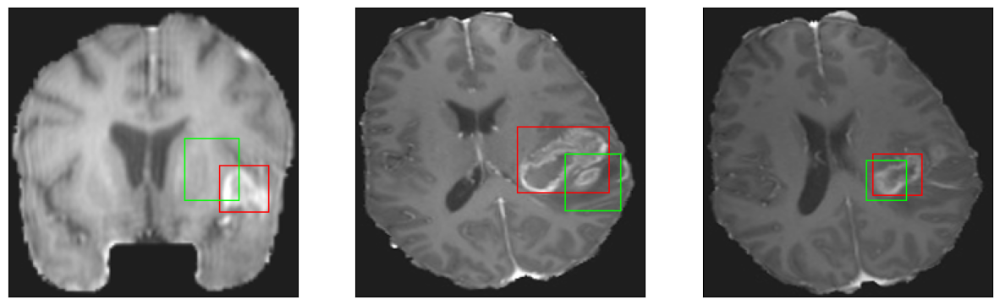

26/26 [==============================] - 3s 111ms/step - loss: 5.2826 - IoU: 0.6080 - val_loss: 11.2385 - val_IoU: 0.4019
Epoch 71/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2363 - IoU: 0.6039
Epoch 71: val_IoU did not improve from 0.42636
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


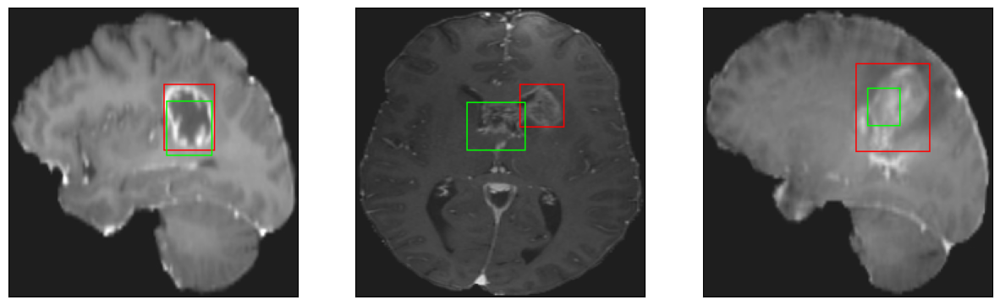

26/26 [==============================] - 3s 105ms/step - loss: 5.2464 - IoU: 0.6034 - val_loss: 11.6210 - val_IoU: 0.3927
Epoch 72/200
26/26 [==============================] - ETA: 0s - loss: 5.5927 - IoU: 0.5815
Epoch 72: val_IoU did not improve from 0.42636
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


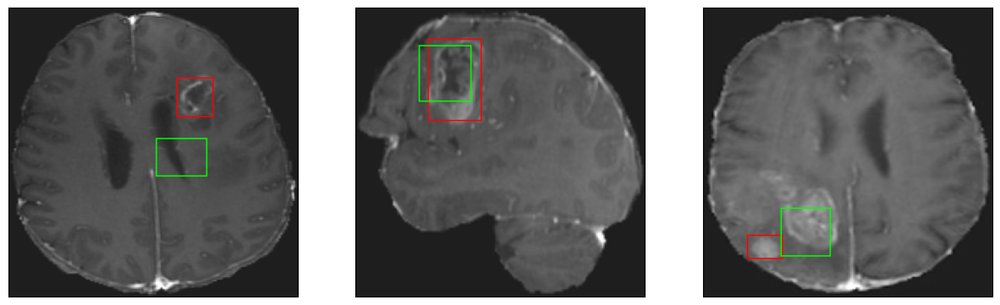

26/26 [==============================] - 2s 88ms/step - loss: 5.5927 - IoU: 0.5815 - val_loss: 11.5197 - val_IoU: 0.4135
Epoch 73/200
25/26 [===========================>..] - ETA: 0s - loss: 5.4452 - IoU: 0.5849
Epoch 73: val_IoU did not improve from 0.42636
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


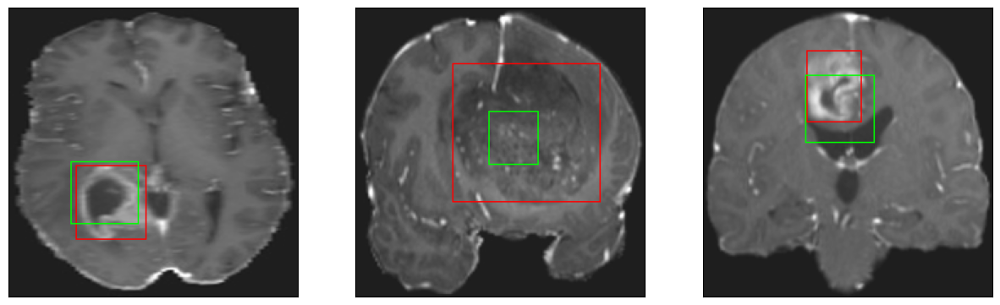

26/26 [==============================] - 3s 102ms/step - loss: 5.4620 - IoU: 0.5849 - val_loss: 11.3025 - val_IoU: 0.4183
Epoch 74/200
26/26 [==============================] - ETA: 0s - loss: 5.5680 - IoU: 0.5836
Epoch 74: val_IoU did not improve from 0.42636
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4


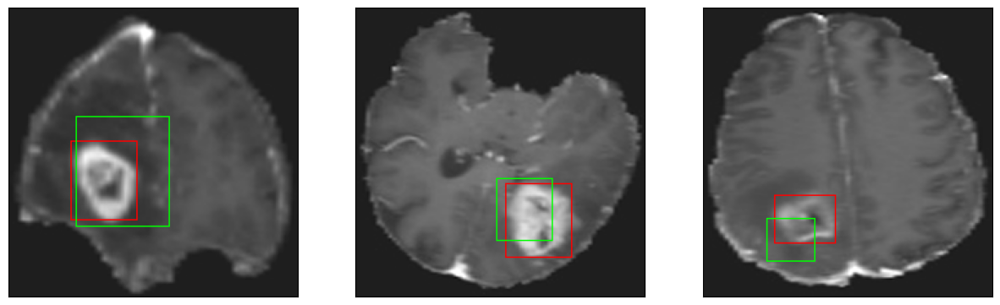

26/26 [==============================] - 3s 116ms/step - loss: 5.5680 - IoU: 0.5836 - val_loss: 11.9639 - val_IoU: 0.3803
Epoch 75/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2934 - IoU: 0.6062
Epoch 75: val_IoU did not improve from 0.42636
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


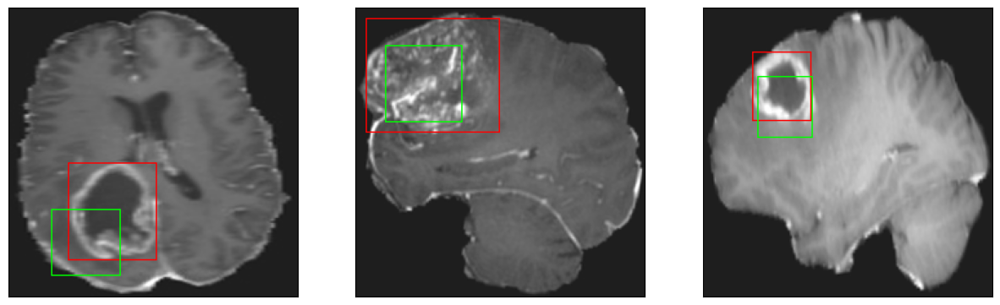

26/26 [==============================] - 3s 103ms/step - loss: 5.3000 - IoU: 0.6041 - val_loss: 10.9170 - val_IoU: 0.4137
Epoch 76/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3162 - IoU: 0.5982
Epoch 76: val_IoU did not improve from 0.42636
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


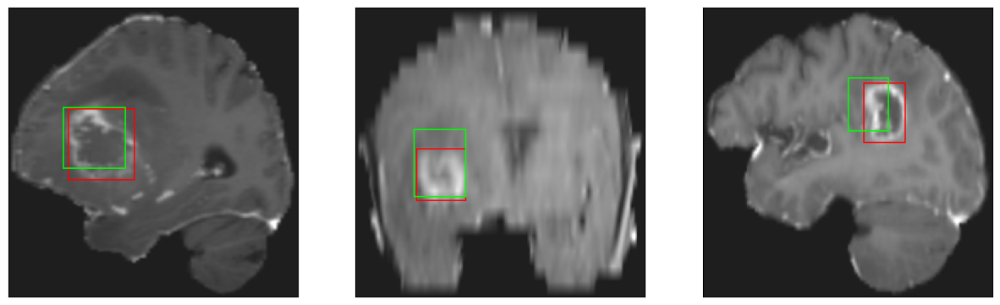

26/26 [==============================] - 3s 105ms/step - loss: 5.2909 - IoU: 0.6000 - val_loss: 12.1256 - val_IoU: 0.3569
Epoch 77/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1714 - IoU: 0.6071
Epoch 77: val_IoU did not improve from 0.42636
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


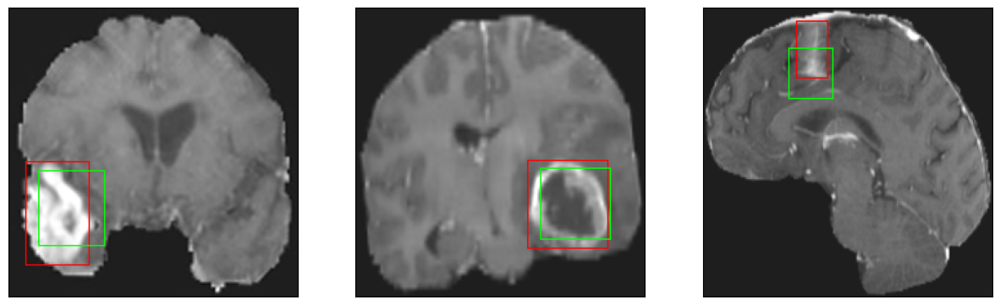

26/26 [==============================] - 3s 122ms/step - loss: 5.1322 - IoU: 0.6086 - val_loss: 11.5895 - val_IoU: 0.3770
Epoch 78/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5667 - IoU: 0.5705
Epoch 78: val_IoU did not improve from 0.42636
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


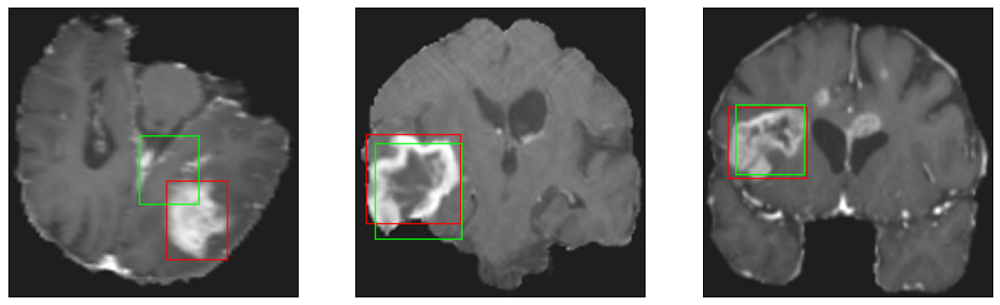

26/26 [==============================] - 3s 117ms/step - loss: 5.6599 - IoU: 0.5673 - val_loss: 11.0827 - val_IoU: 0.4094
Epoch 79/200
26/26 [==============================] - ETA: 0s - loss: 5.3748 - IoU: 0.5987
Epoch 79: val_IoU did not improve from 0.42636
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


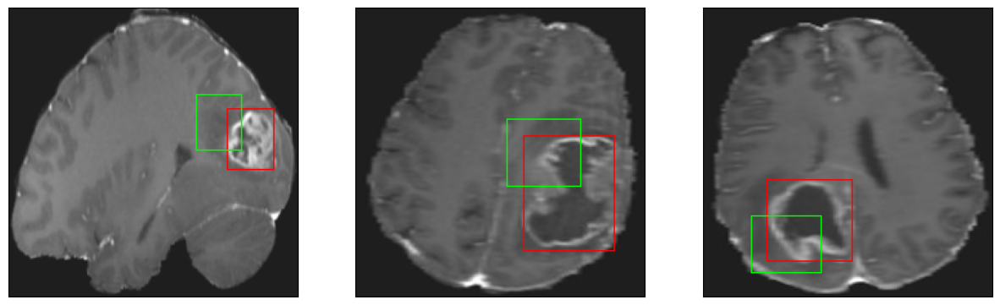

26/26 [==============================] - 3s 110ms/step - loss: 5.3748 - IoU: 0.5987 - val_loss: 11.2237 - val_IoU: 0.4114
Epoch 80/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1764 - IoU: 0.6060
Epoch 80: val_IoU did not improve from 0.42636
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


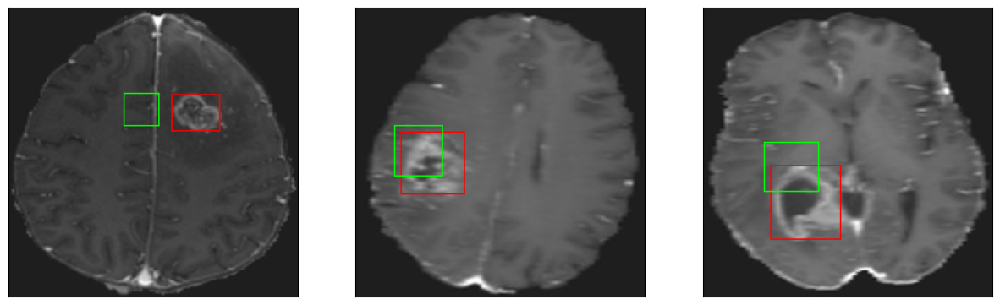

26/26 [==============================] - 3s 103ms/step - loss: 5.2194 - IoU: 0.6051 - val_loss: 15.6244 - val_IoU: 0.2321
Epoch 81/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1504 - IoU: 0.6145
Epoch 81: val_IoU did not improve from 0.42636
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


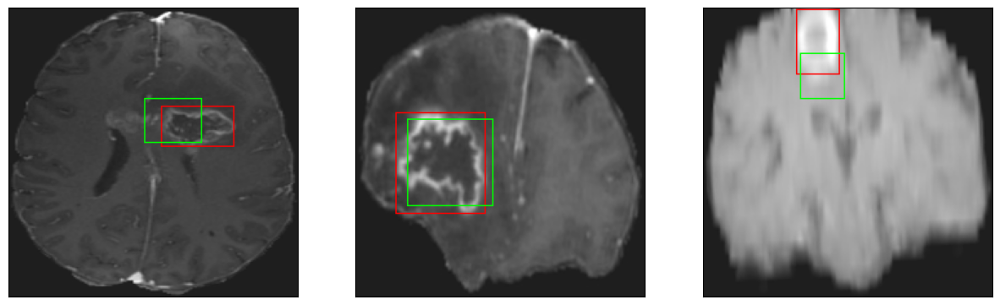

26/26 [==============================] - 4s 142ms/step - loss: 5.1184 - IoU: 0.6127 - val_loss: 11.1070 - val_IoU: 0.4189
Epoch 82/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0972 - IoU: 0.6162
Epoch 82: val_IoU did not improve from 0.42636
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


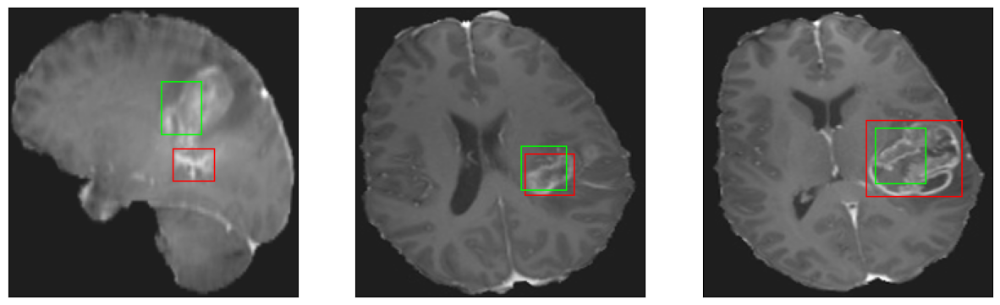

26/26 [==============================] - 3s 117ms/step - loss: 5.0770 - IoU: 0.6138 - val_loss: 11.4882 - val_IoU: 0.4002
Epoch 83/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1941 - IoU: 0.6077
Epoch 83: val_IoU did not improve from 0.42636
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


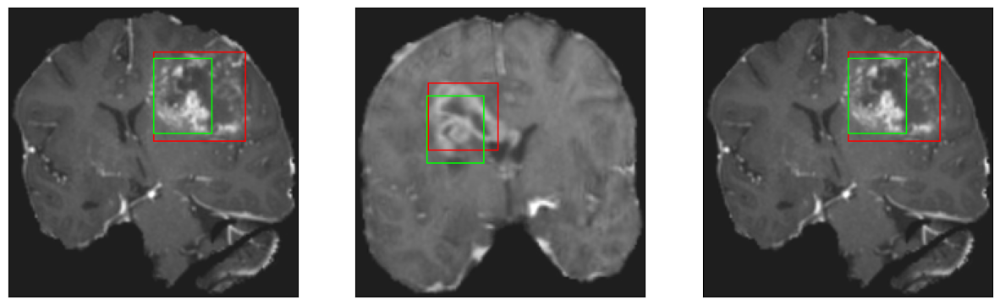

26/26 [==============================] - 3s 101ms/step - loss: 5.1921 - IoU: 0.6087 - val_loss: 11.8362 - val_IoU: 0.3730
Epoch 84/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3358 - IoU: 0.5940
Epoch 84: val_IoU did not improve from 0.42636
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


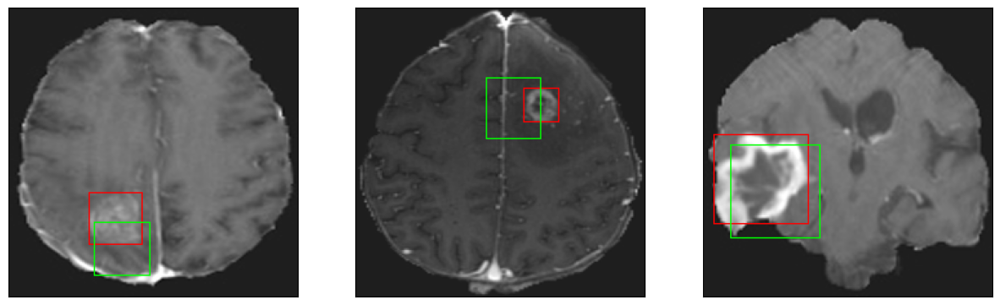

26/26 [==============================] - 3s 102ms/step - loss: 5.3045 - IoU: 0.5963 - val_loss: 11.0816 - val_IoU: 0.4054
Epoch 85/200
26/26 [==============================] - ETA: 0s - loss: 5.3904 - IoU: 0.5888
Epoch 85: val_IoU did not improve from 0.42636
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


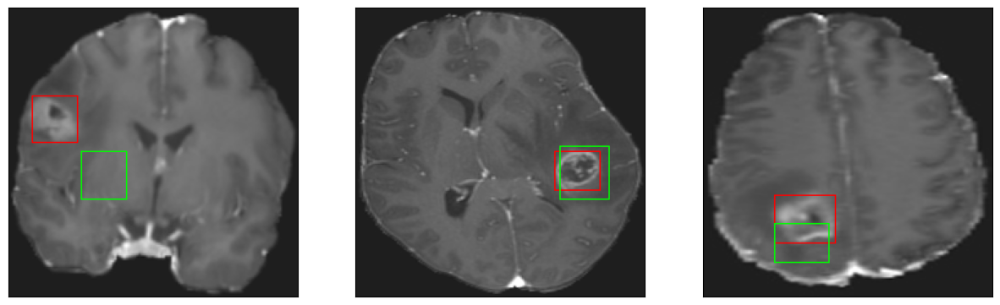

26/26 [==============================] - 3s 107ms/step - loss: 5.3904 - IoU: 0.5888 - val_loss: 11.6038 - val_IoU: 0.3701
Epoch 86/200
26/26 [==============================] - ETA: 0s - loss: 5.0581 - IoU: 0.6123
Epoch 86: val_IoU did not improve from 0.42636
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


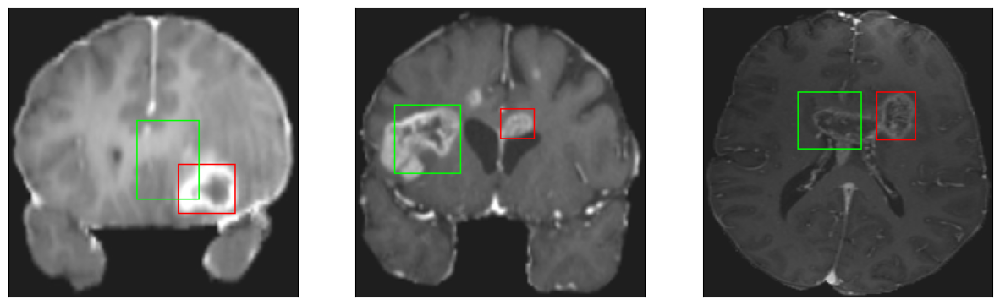

26/26 [==============================] - 2s 92ms/step - loss: 5.0581 - IoU: 0.6123 - val_loss: 14.0188 - val_IoU: 0.3032
Epoch 87/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1180 - IoU: 0.6011
Epoch 87: val_IoU did not improve from 0.42636
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


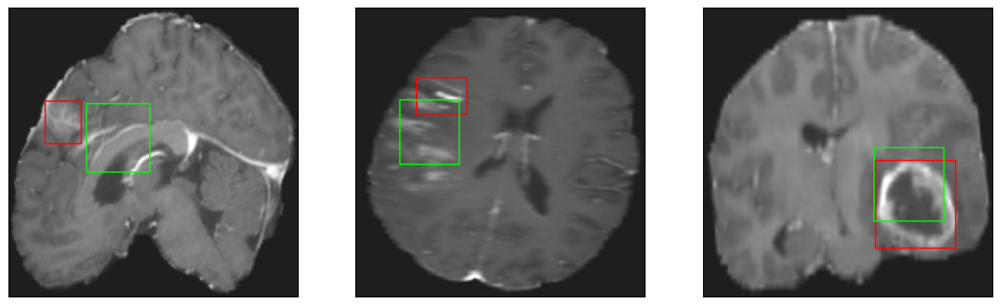

26/26 [==============================] - 2s 90ms/step - loss: 5.1001 - IoU: 0.6030 - val_loss: 11.4296 - val_IoU: 0.4048
Epoch 88/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2030 - IoU: 0.6034
Epoch 88: val_IoU did not improve from 0.42636
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


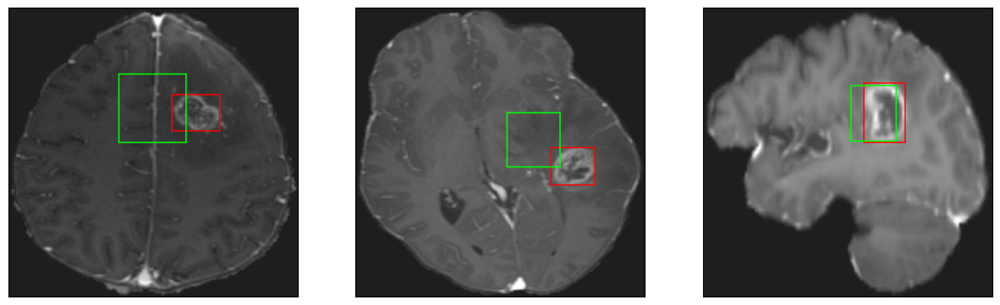

26/26 [==============================] - 3s 102ms/step - loss: 5.1834 - IoU: 0.6043 - val_loss: 13.7433 - val_IoU: 0.2964
Epoch 89/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0219 - IoU: 0.6213
Epoch 89: val_IoU did not improve from 0.42636
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


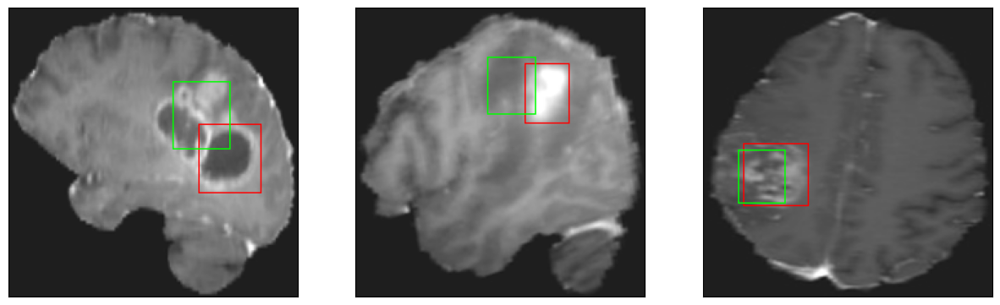

26/26 [==============================] - 3s 114ms/step - loss: 5.0527 - IoU: 0.6193 - val_loss: 14.5846 - val_IoU: 0.2620
Epoch 90/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2091 - IoU: 0.6053
Epoch 90: val_IoU did not improve from 0.42636
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


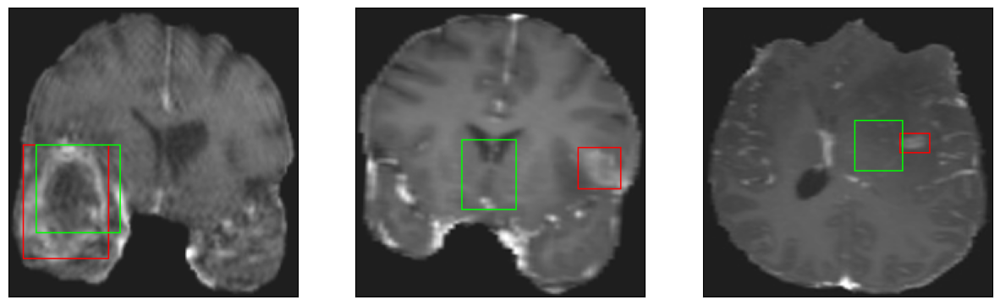

26/26 [==============================] - 2s 94ms/step - loss: 5.1878 - IoU: 0.6058 - val_loss: 13.1981 - val_IoU: 0.3585
Epoch 91/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1454 - IoU: 0.6046
Epoch 91: val_IoU did not improve from 0.42636
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


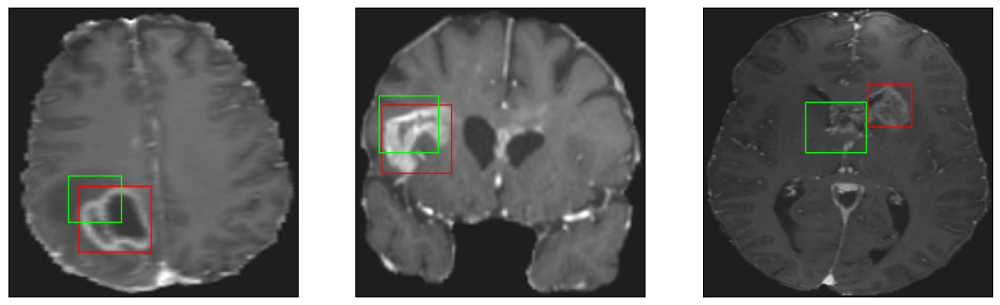

26/26 [==============================] - 2s 93ms/step - loss: 5.1068 - IoU: 0.6073 - val_loss: 15.7677 - val_IoU: 0.2419
Epoch 92/200
26/26 [==============================] - ETA: 0s - loss: 5.2985 - IoU: 0.5985
Epoch 92: val_IoU did not improve from 0.42636
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


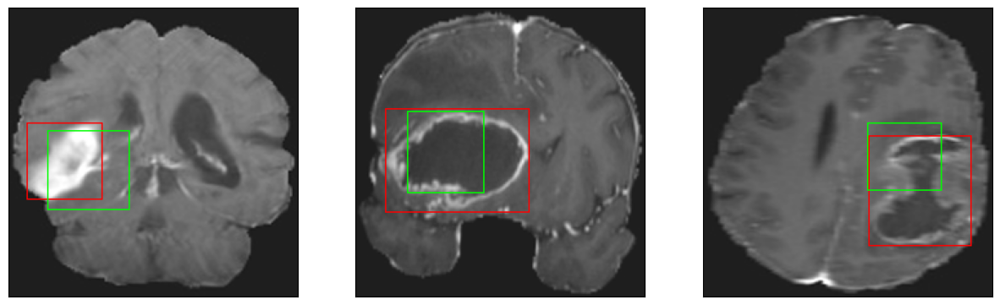

26/26 [==============================] - 3s 113ms/step - loss: 5.2985 - IoU: 0.5985 - val_loss: 12.1133 - val_IoU: 0.3838
Epoch 93/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1837 - IoU: 0.6033
Epoch 93: val_IoU did not improve from 0.42636
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


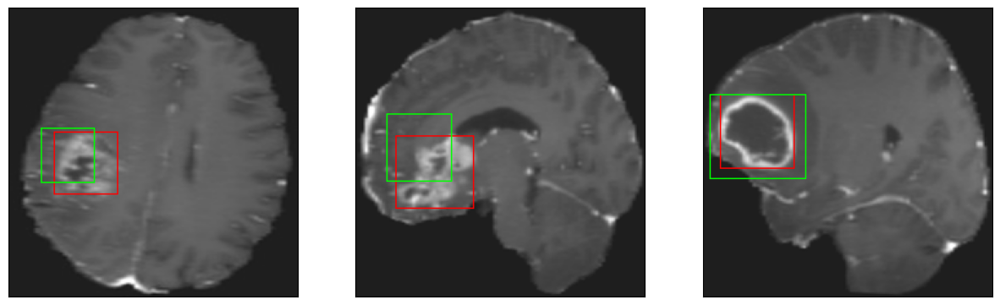

26/26 [==============================] - 3s 123ms/step - loss: 5.2627 - IoU: 0.6005 - val_loss: 15.7698 - val_IoU: 0.2330
Epoch 94/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2030 - IoU: 0.5998
Epoch 94: val_IoU did not improve from 0.42636
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


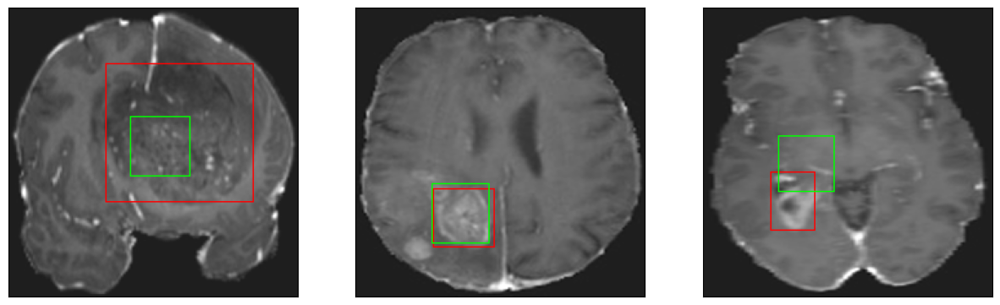

26/26 [==============================] - 3s 99ms/step - loss: 5.1969 - IoU: 0.6018 - val_loss: 12.4967 - val_IoU: 0.3830
Epoch 95/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9200 - IoU: 0.6288
Epoch 95: val_IoU did not improve from 0.42636
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


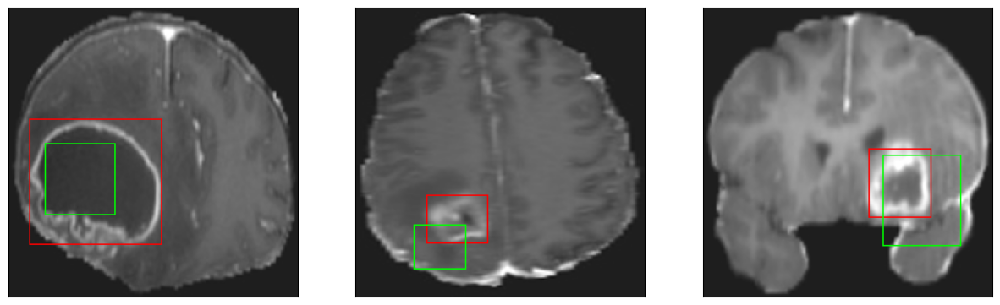

26/26 [==============================] - 3s 107ms/step - loss: 4.9017 - IoU: 0.6288 - val_loss: 10.7134 - val_IoU: 0.4193
Epoch 96/200
26/26 [==============================] - ETA: 0s - loss: 4.9147 - IoU: 0.6211
Epoch 96: val_IoU improved from 0.42636 to 0.43297, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4


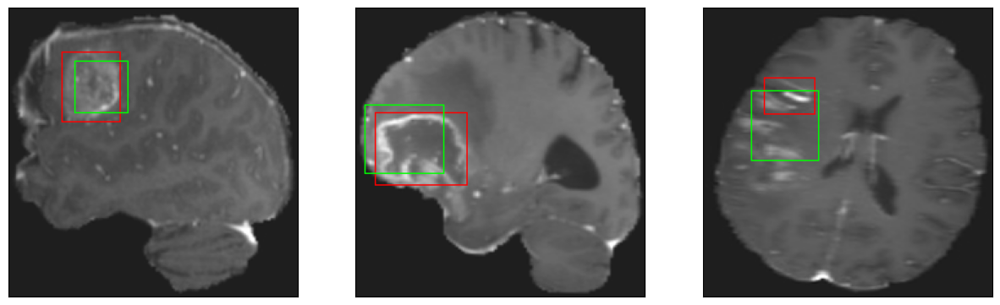

26/26 [==============================] - 3s 136ms/step - loss: 4.9147 - IoU: 0.6211 - val_loss: 10.6062 - val_IoU: 0.4330
Epoch 97/200
26/26 [==============================] - ETA: 0s - loss: 5.1432 - IoU: 0.6215
Epoch 97: val_IoU did not improve from 0.43297
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


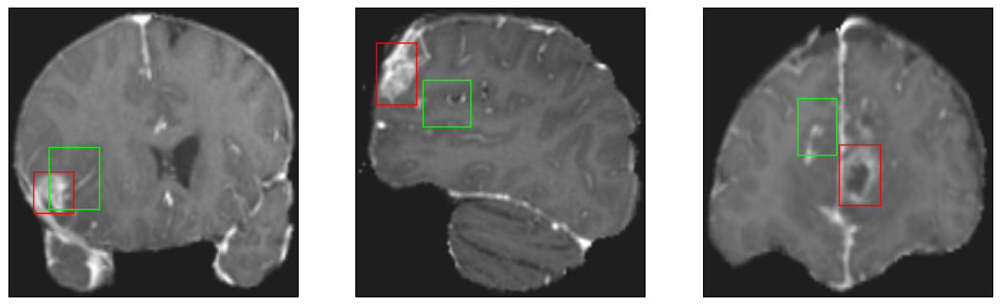

26/26 [==============================] - 3s 109ms/step - loss: 5.1432 - IoU: 0.6215 - val_loss: 11.7174 - val_IoU: 0.3769
Epoch 98/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8569 - IoU: 0.6302
Epoch 98: val_IoU did not improve from 0.43297
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


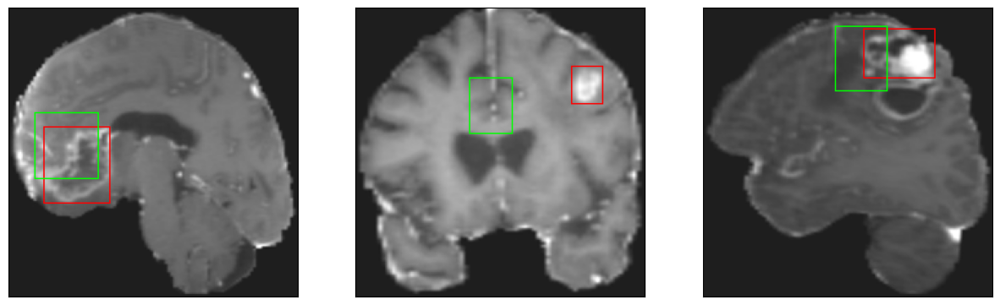

26/26 [==============================] - 3s 102ms/step - loss: 4.8366 - IoU: 0.6312 - val_loss: 11.1226 - val_IoU: 0.4208
Epoch 99/200
26/26 [==============================] - ETA: 0s - loss: 4.8250 - IoU: 0.6280
Epoch 99: val_IoU improved from 0.43297 to 0.43444, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


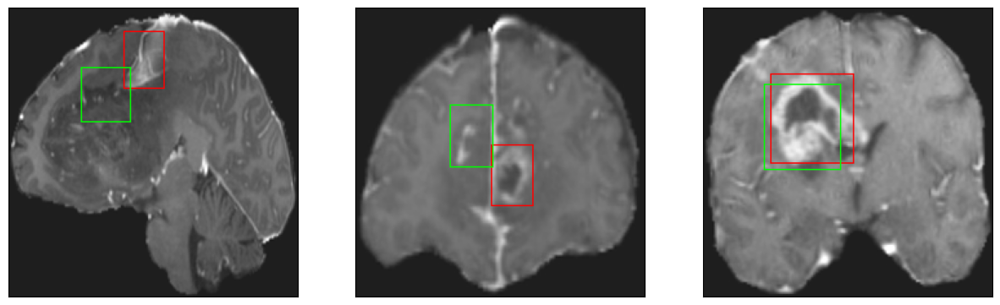

26/26 [==============================] - 4s 137ms/step - loss: 4.8250 - IoU: 0.6280 - val_loss: 10.8324 - val_IoU: 0.4344
Epoch 100/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8495 - IoU: 0.6336
Epoch 100: val_IoU did not improve from 0.43444
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


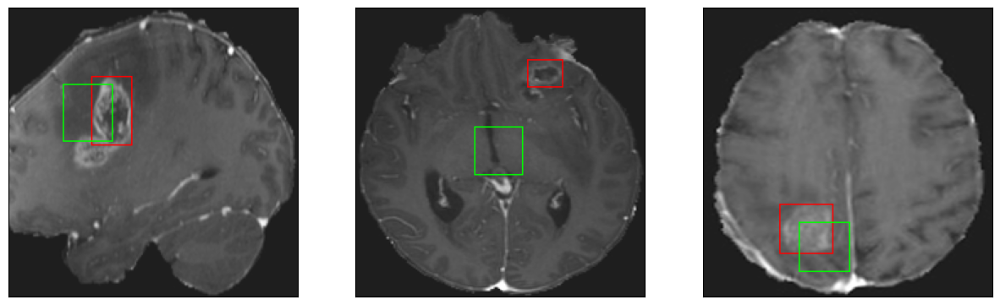

26/26 [==============================] - 3s 130ms/step - loss: 4.8573 - IoU: 0.6321 - val_loss: 11.0909 - val_IoU: 0.4259
Epoch 101/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2704 - IoU: 0.6069
Epoch 101: val_IoU did not improve from 0.43444
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


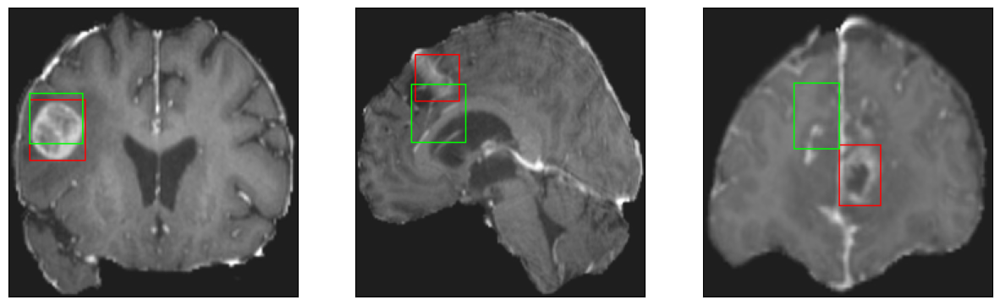

26/26 [==============================] - 3s 128ms/step - loss: 5.2650 - IoU: 0.6051 - val_loss: 13.0841 - val_IoU: 0.3342
Epoch 102/200
26/26 [==============================] - ETA: 0s - loss: 5.0059 - IoU: 0.6219
Epoch 102: val_IoU did not improve from 0.43444
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


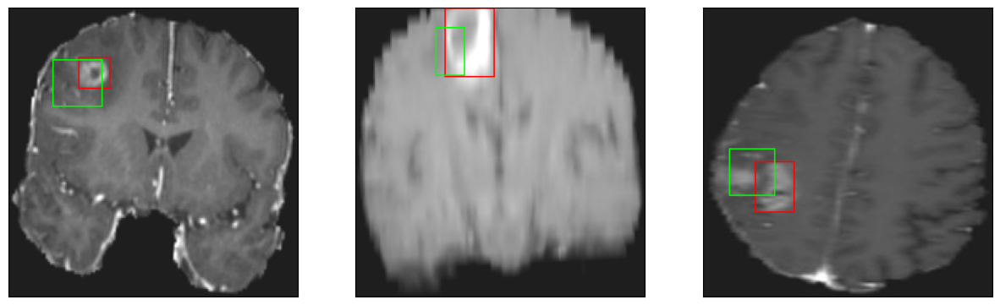

26/26 [==============================] - 3s 99ms/step - loss: 5.0059 - IoU: 0.6219 - val_loss: 13.6679 - val_IoU: 0.2908
Epoch 103/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8416 - IoU: 0.6224
Epoch 103: val_IoU did not improve from 0.43444
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


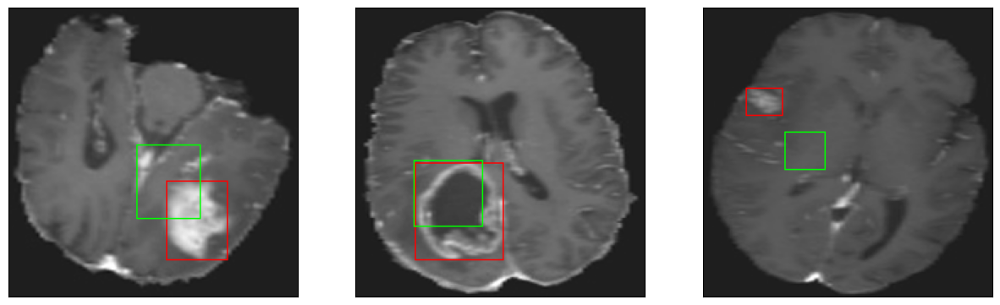

26/26 [==============================] - 3s 104ms/step - loss: 4.8446 - IoU: 0.6239 - val_loss: 14.7531 - val_IoU: 0.2826
Epoch 104/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6947 - IoU: 0.6353
Epoch 104: val_IoU did not improve from 0.43444
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


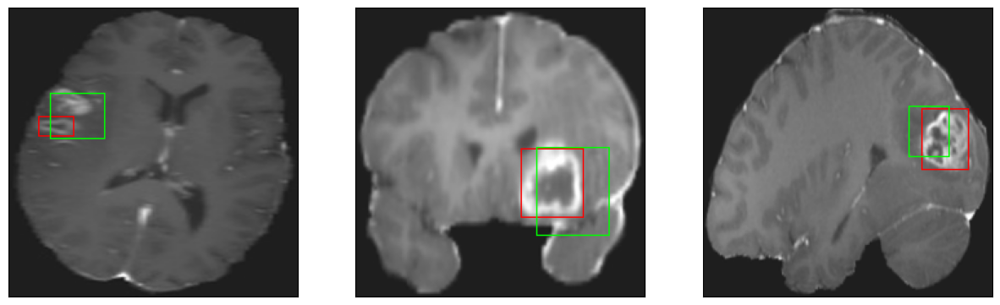

26/26 [==============================] - 2s 90ms/step - loss: 4.7545 - IoU: 0.6344 - val_loss: 10.8395 - val_IoU: 0.4312
Epoch 105/200
26/26 [==============================] - ETA: 0s - loss: 5.0199 - IoU: 0.6177
Epoch 105: val_IoU did not improve from 0.43444
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


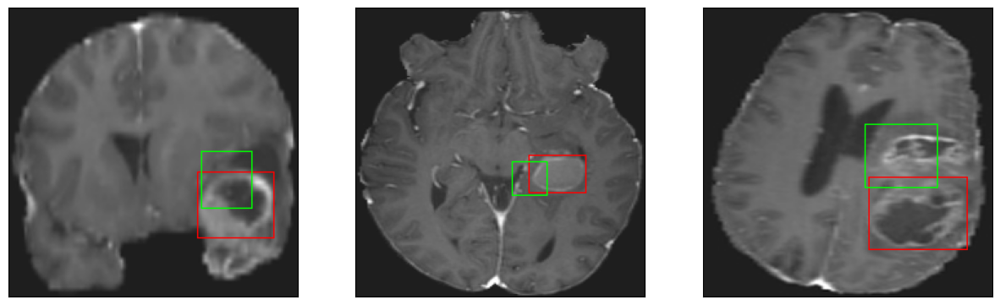

26/26 [==============================] - 2s 92ms/step - loss: 5.0199 - IoU: 0.6177 - val_loss: 11.4422 - val_IoU: 0.3982
Epoch 106/200
26/26 [==============================] - ETA: 0s - loss: 5.0397 - IoU: 0.6119
Epoch 106: val_IoU did not improve from 0.43444
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


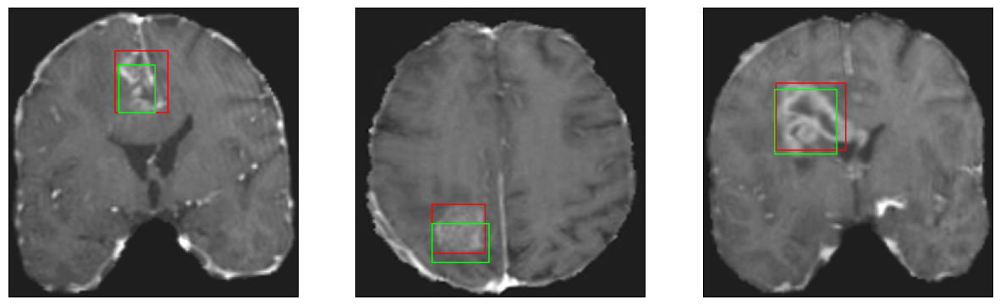

26/26 [==============================] - 3s 114ms/step - loss: 5.0397 - IoU: 0.6119 - val_loss: 13.7999 - val_IoU: 0.3033
Epoch 107/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7547 - IoU: 0.6372
Epoch 107: val_IoU did not improve from 0.43444
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


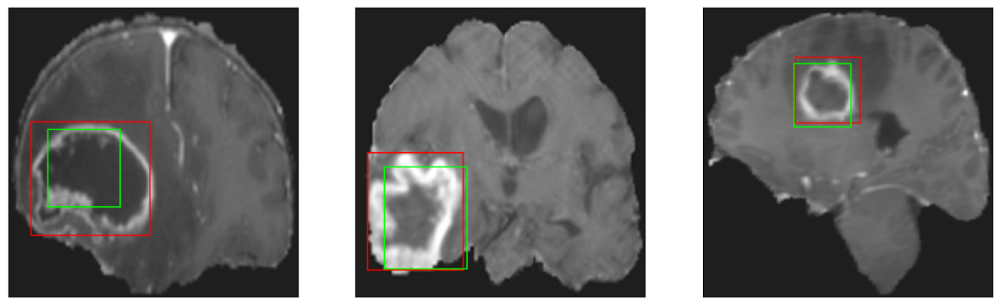

26/26 [==============================] - 3s 128ms/step - loss: 4.7665 - IoU: 0.6376 - val_loss: 10.9870 - val_IoU: 0.4199
Epoch 108/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9359 - IoU: 0.6246
Epoch 108: val_IoU did not improve from 0.43444
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4


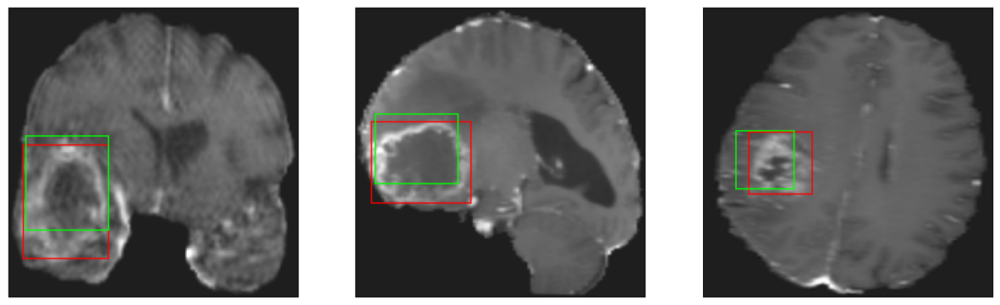

26/26 [==============================] - 3s 99ms/step - loss: 4.9089 - IoU: 0.6261 - val_loss: 13.2929 - val_IoU: 0.3210
Epoch 109/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7495 - IoU: 0.6347
Epoch 109: val_IoU did not improve from 0.43444
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


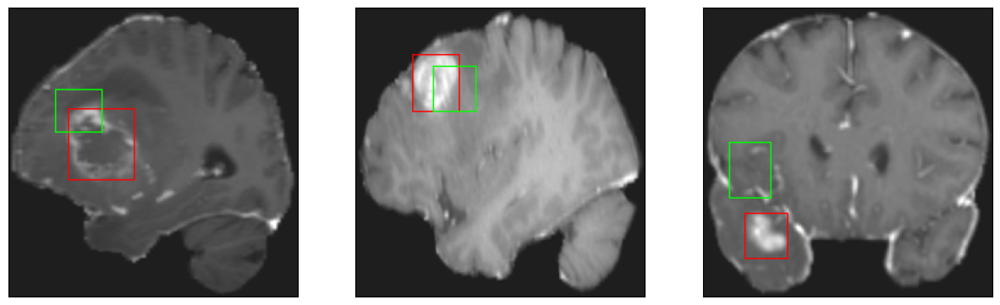

26/26 [==============================] - 3s 105ms/step - loss: 4.7220 - IoU: 0.6353 - val_loss: 20.6929 - val_IoU: 0.1199
Epoch 110/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8648 - IoU: 0.6226
Epoch 110: val_IoU did not improve from 0.43444
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


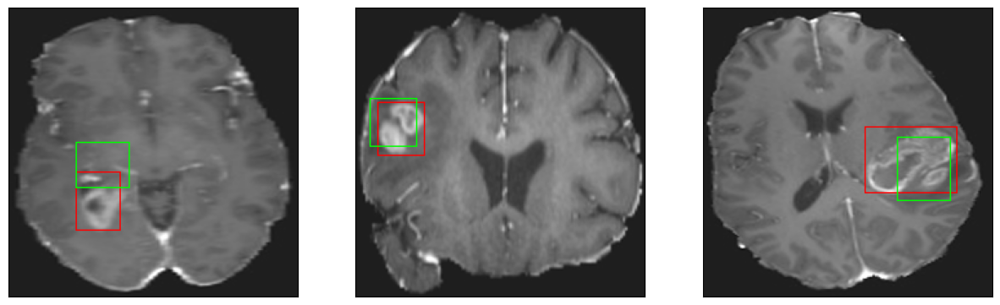

26/26 [==============================] - 3s 113ms/step - loss: 4.8414 - IoU: 0.6249 - val_loss: 11.8338 - val_IoU: 0.3794
Epoch 111/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6343 - IoU: 0.6359
Epoch 111: val_IoU did not improve from 0.43444
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


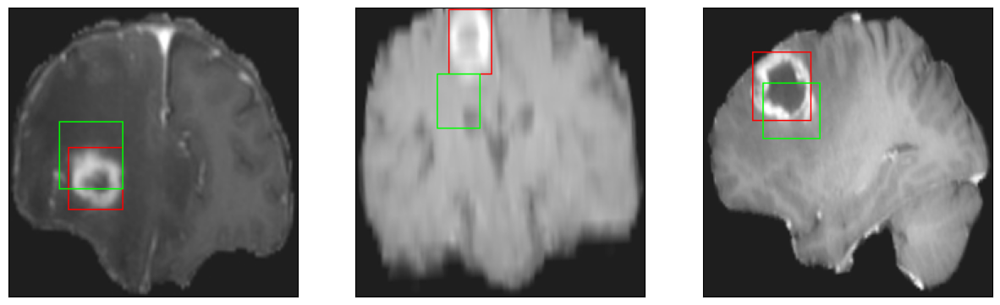

26/26 [==============================] - 3s 118ms/step - loss: 4.6551 - IoU: 0.6346 - val_loss: 10.9980 - val_IoU: 0.4231
Epoch 112/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1749 - IoU: 0.6042
Epoch 112: val_IoU did not improve from 0.43444
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


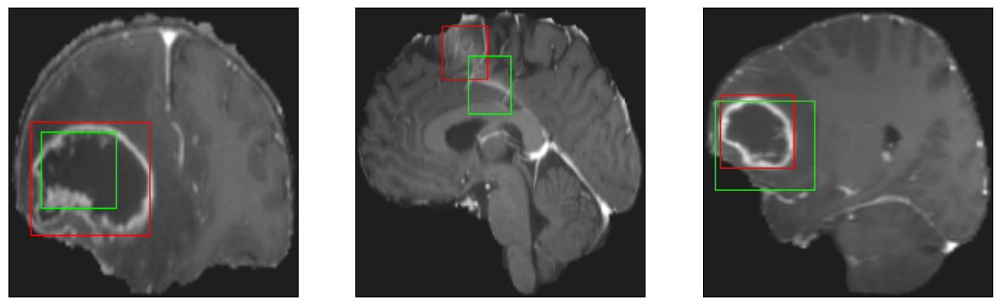

26/26 [==============================] - 3s 98ms/step - loss: 5.1772 - IoU: 0.6044 - val_loss: 10.9660 - val_IoU: 0.4312
Epoch 113/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7679 - IoU: 0.6279
Epoch 113: val_IoU did not improve from 0.43444
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


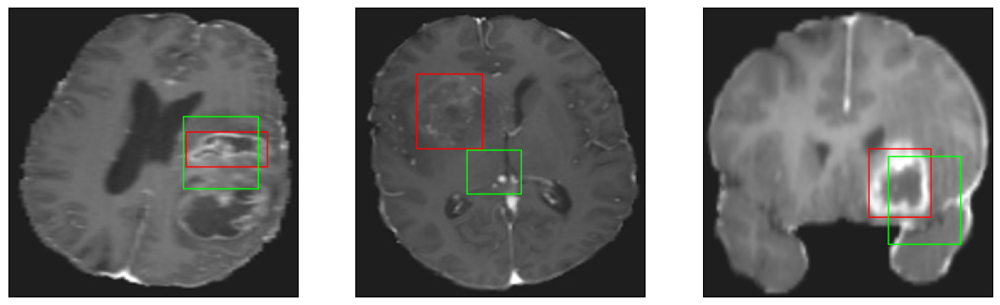

26/26 [==============================] - 2s 92ms/step - loss: 4.7767 - IoU: 0.6286 - val_loss: 10.9071 - val_IoU: 0.4291
Epoch 114/200
26/26 [==============================] - ETA: 0s - loss: 4.8315 - IoU: 0.6261
Epoch 114: val_IoU did not improve from 0.43444
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


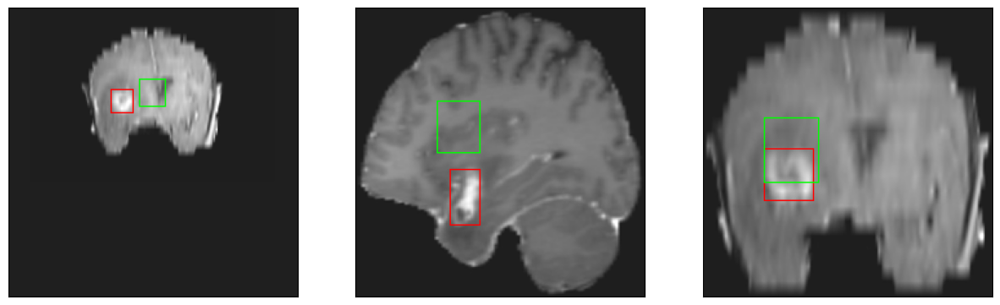

26/26 [==============================] - 3s 102ms/step - loss: 4.8315 - IoU: 0.6261 - val_loss: 15.4859 - val_IoU: 0.2352
Epoch 115/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6573 - IoU: 0.6373
Epoch 115: val_IoU did not improve from 0.43444
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


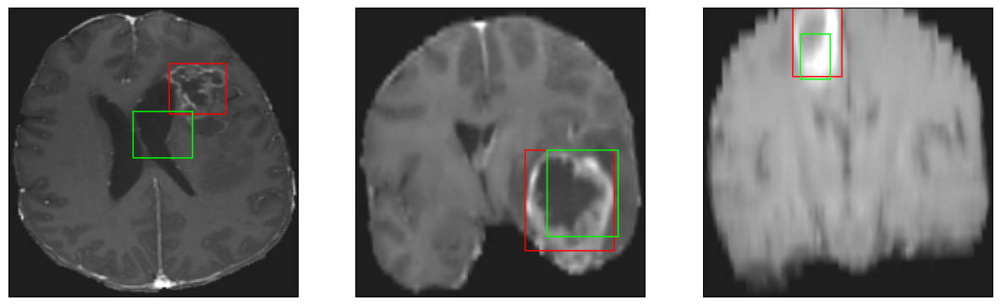

26/26 [==============================] - 3s 124ms/step - loss: 4.7237 - IoU: 0.6361 - val_loss: 10.9087 - val_IoU: 0.4277
Epoch 116/200
26/26 [==============================] - ETA: 0s - loss: 4.8089 - IoU: 0.6304
Epoch 116: val_IoU did not improve from 0.43444
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


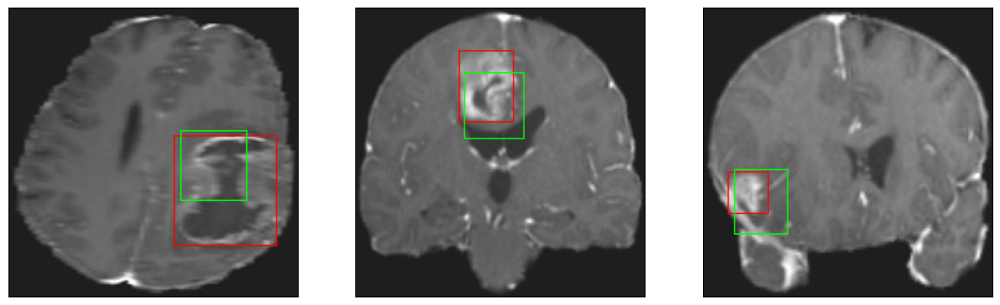

26/26 [==============================] - 3s 100ms/step - loss: 4.8089 - IoU: 0.6304 - val_loss: 11.1669 - val_IoU: 0.4158
Epoch 117/200
26/26 [==============================] - ETA: 0s - loss: 4.5346 - IoU: 0.6541
Epoch 117: val_IoU did not improve from 0.43444
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


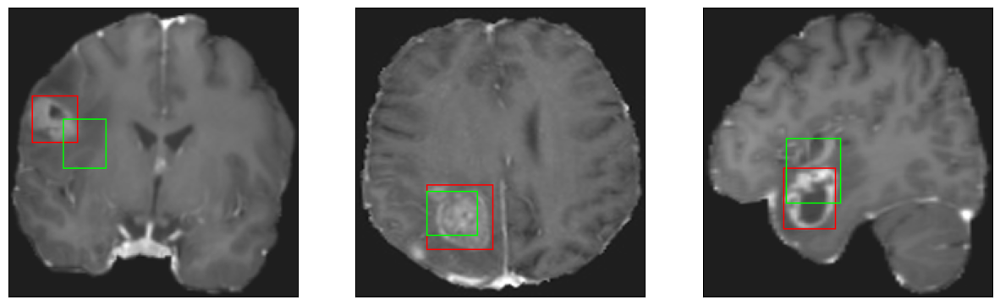

26/26 [==============================] - 2s 95ms/step - loss: 4.5346 - IoU: 0.6541 - val_loss: 11.0200 - val_IoU: 0.4269
Epoch 118/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7613 - IoU: 0.6285
Epoch 118: val_IoU did not improve from 0.43444
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


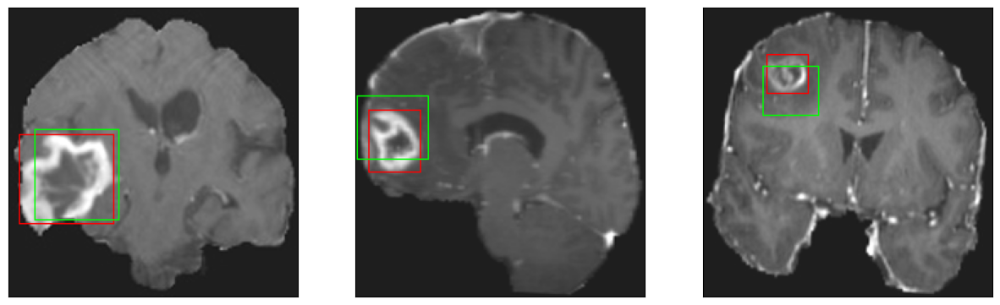

26/26 [==============================] - 3s 111ms/step - loss: 4.7436 - IoU: 0.6297 - val_loss: 12.0670 - val_IoU: 0.3777
Epoch 119/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0565 - IoU: 0.6135
Epoch 119: val_IoU did not improve from 0.43444
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


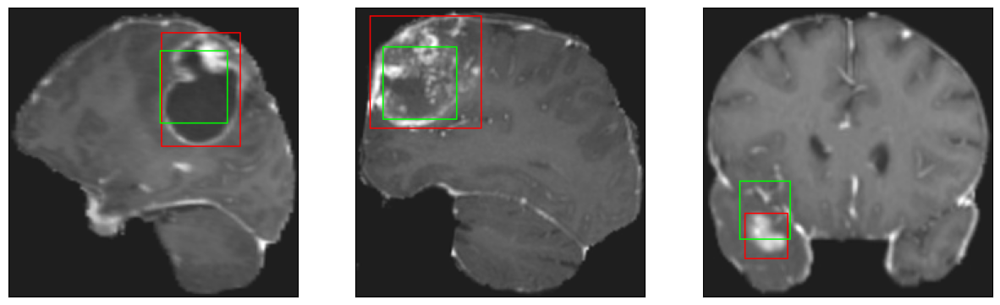

26/26 [==============================] - 3s 100ms/step - loss: 5.0778 - IoU: 0.6116 - val_loss: 11.7645 - val_IoU: 0.4015
Epoch 120/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8449 - IoU: 0.6284
Epoch 120: val_IoU did not improve from 0.43444
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


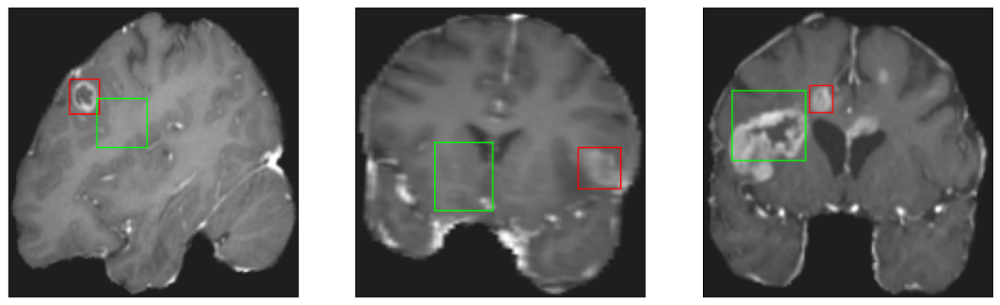

26/26 [==============================] - 3s 101ms/step - loss: 4.8482 - IoU: 0.6283 - val_loss: 10.9677 - val_IoU: 0.4211
Epoch 121/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7346 - IoU: 0.6348
Epoch 121: val_IoU did not improve from 0.43444
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


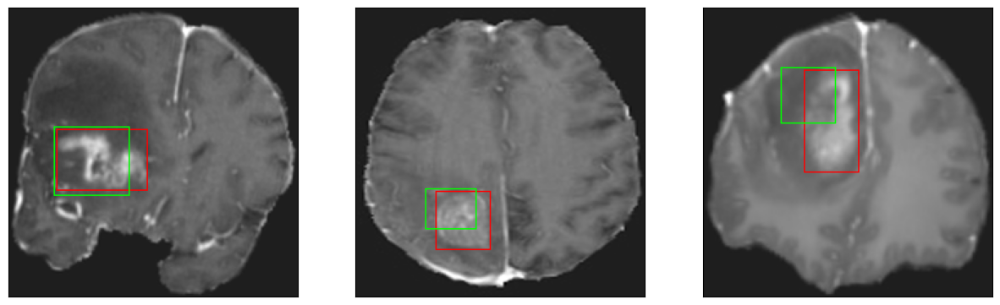

26/26 [==============================] - 3s 114ms/step - loss: 4.7482 - IoU: 0.6340 - val_loss: 13.9326 - val_IoU: 0.3121
Epoch 122/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9356 - IoU: 0.6240
Epoch 122: val_IoU did not improve from 0.43444
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


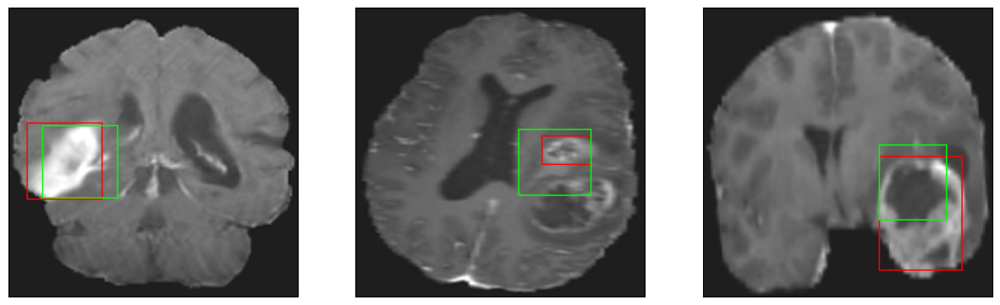

26/26 [==============================] - 3s 114ms/step - loss: 4.9010 - IoU: 0.6245 - val_loss: 11.1062 - val_IoU: 0.4213
Epoch 123/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6390 - IoU: 0.6363
Epoch 123: val_IoU did not improve from 0.43444
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


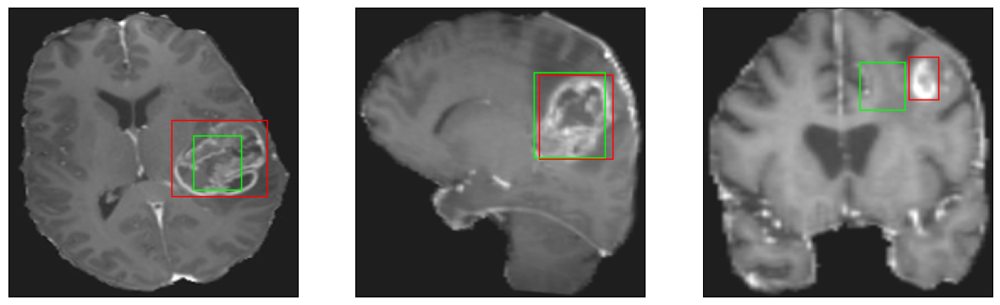

26/26 [==============================] - 3s 99ms/step - loss: 4.6701 - IoU: 0.6339 - val_loss: 11.0391 - val_IoU: 0.4188
Epoch 124/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6637 - IoU: 0.6383
Epoch 124: val_IoU improved from 0.43444 to 0.43745, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 12ms/step
4


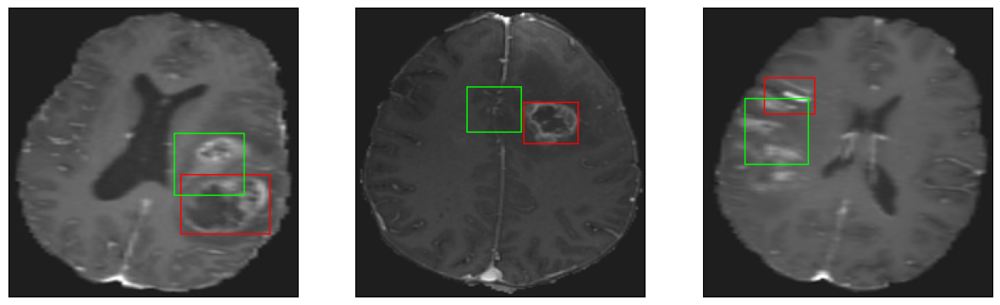

26/26 [==============================] - 4s 153ms/step - loss: 4.6283 - IoU: 0.6407 - val_loss: 10.9729 - val_IoU: 0.4374
Epoch 125/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5151 - IoU: 0.6470
Epoch 125: val_IoU did not improve from 0.43745
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


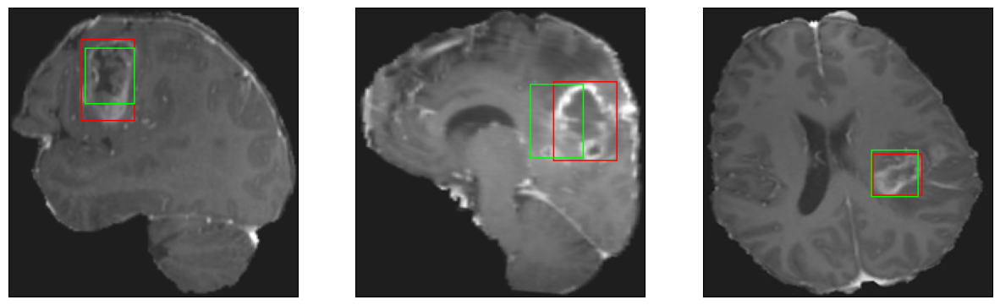

26/26 [==============================] - 3s 103ms/step - loss: 4.5931 - IoU: 0.6442 - val_loss: 11.1072 - val_IoU: 0.4211
Epoch 126/200
26/26 [==============================] - ETA: 0s - loss: 4.6586 - IoU: 0.6365
Epoch 126: val_IoU improved from 0.43745 to 0.45384, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


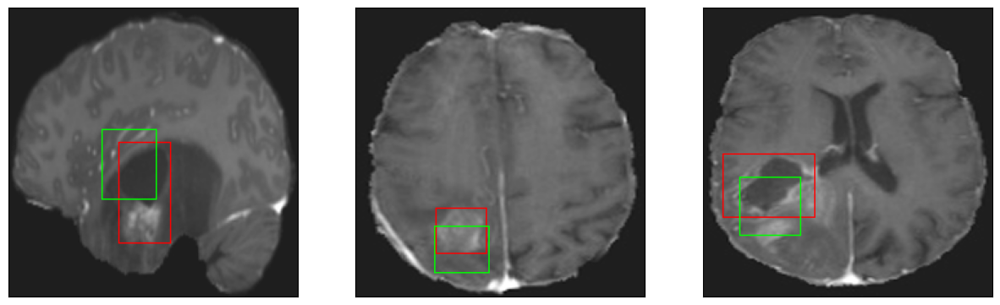

26/26 [==============================] - 2s 95ms/step - loss: 4.6586 - IoU: 0.6365 - val_loss: 10.5284 - val_IoU: 0.4538
Epoch 127/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5538 - IoU: 0.6412
Epoch 127: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


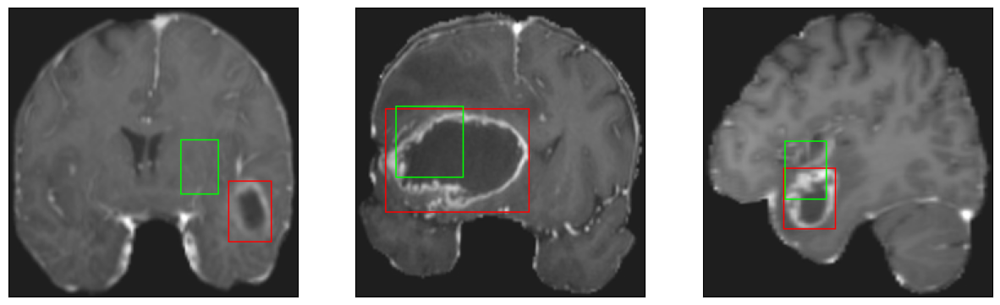

26/26 [==============================] - 3s 97ms/step - loss: 4.5343 - IoU: 0.6430 - val_loss: 11.8001 - val_IoU: 0.4049
Epoch 128/200
26/26 [==============================] - ETA: 0s - loss: 4.5451 - IoU: 0.6457
Epoch 128: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


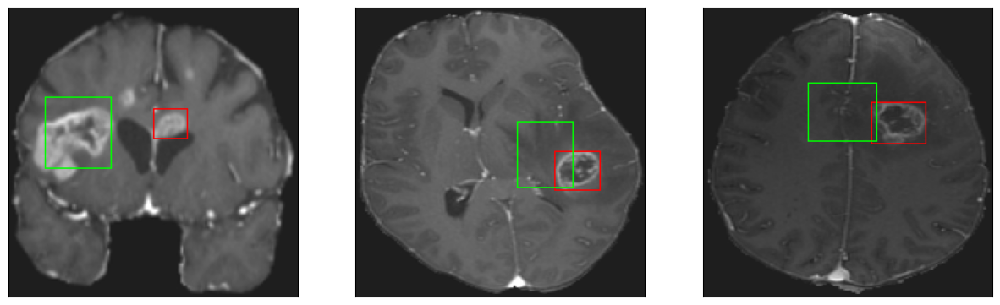

26/26 [==============================] - 3s 103ms/step - loss: 4.5451 - IoU: 0.6457 - val_loss: 15.4884 - val_IoU: 0.2734
Epoch 129/200
26/26 [==============================] - ETA: 0s - loss: 4.6148 - IoU: 0.6424
Epoch 129: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


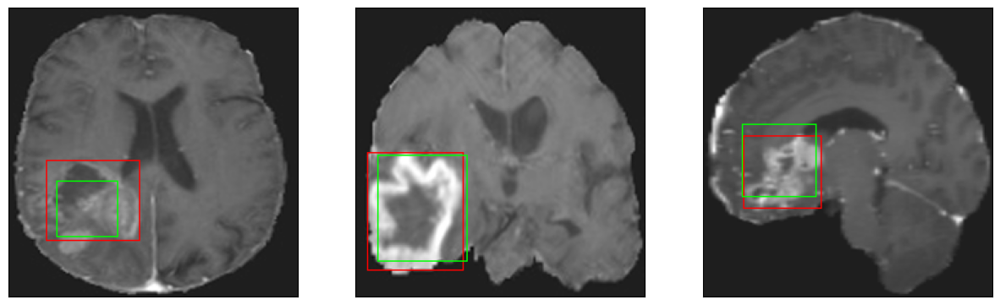

26/26 [==============================] - 3s 129ms/step - loss: 4.6148 - IoU: 0.6424 - val_loss: 11.1292 - val_IoU: 0.4188
Epoch 130/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5546 - IoU: 0.6319
Epoch 130: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


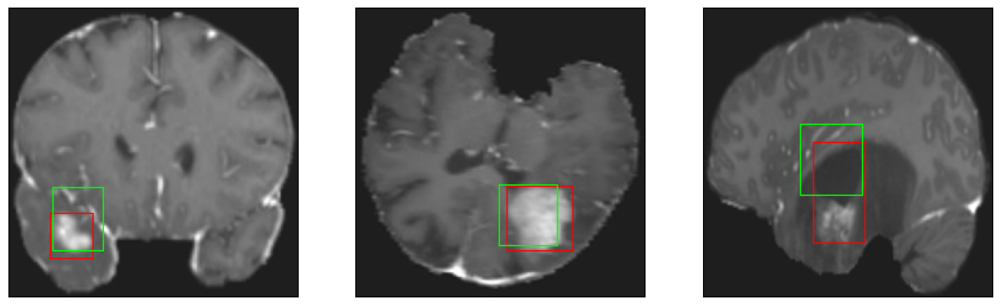

26/26 [==============================] - 3s 97ms/step - loss: 4.6364 - IoU: 0.6291 - val_loss: 11.3339 - val_IoU: 0.4159
Epoch 131/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7260 - IoU: 0.6314
Epoch 131: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


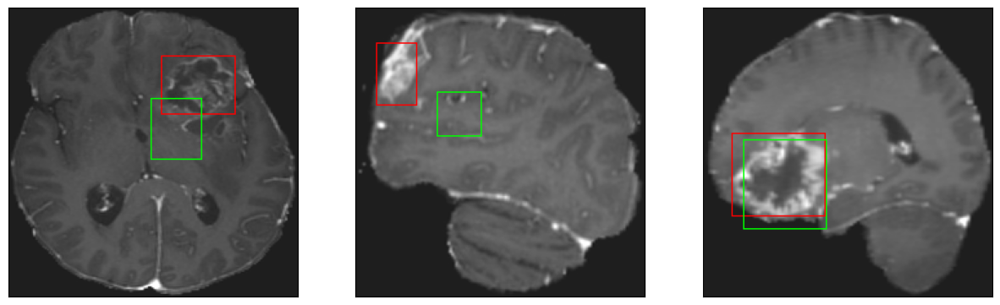

26/26 [==============================] - 2s 95ms/step - loss: 4.6921 - IoU: 0.6334 - val_loss: 10.7822 - val_IoU: 0.4299
Epoch 132/200
26/26 [==============================] - ETA: 0s - loss: 4.5696 - IoU: 0.6440
Epoch 132: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


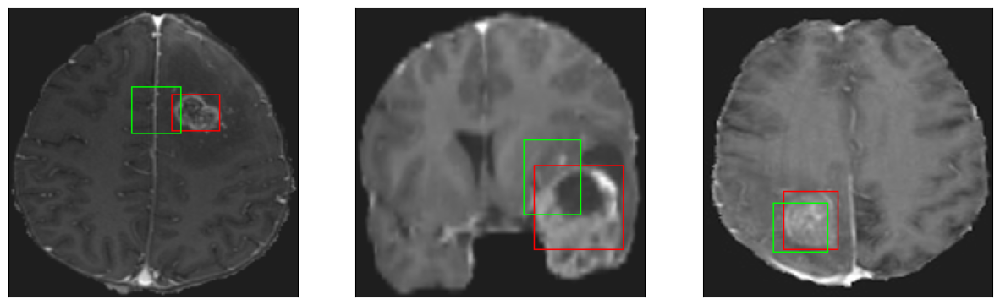

26/26 [==============================] - 2s 89ms/step - loss: 4.5696 - IoU: 0.6440 - val_loss: 10.8492 - val_IoU: 0.4382
Epoch 133/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4844 - IoU: 0.6489
Epoch 133: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


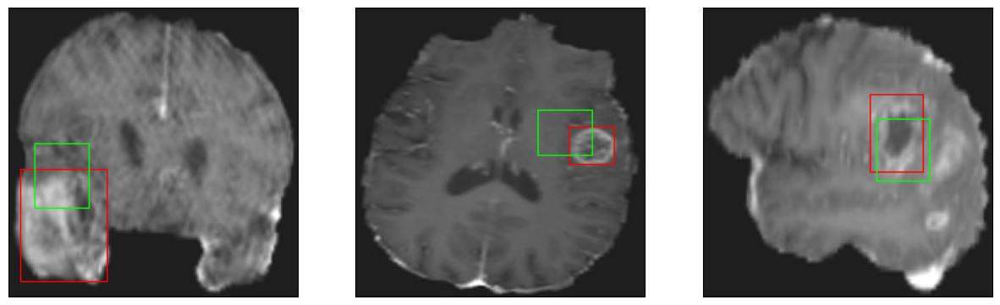

26/26 [==============================] - 3s 124ms/step - loss: 4.4739 - IoU: 0.6488 - val_loss: 10.8899 - val_IoU: 0.4190
Epoch 134/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6471 - IoU: 0.6404
Epoch 134: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 6ms/step
4


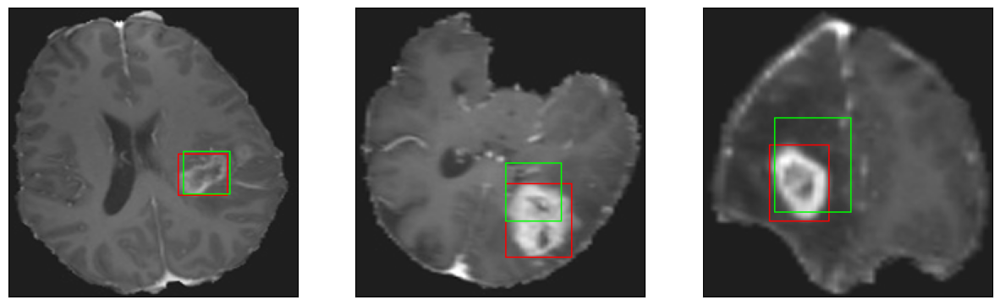

26/26 [==============================] - 3s 111ms/step - loss: 4.6322 - IoU: 0.6418 - val_loss: 11.1929 - val_IoU: 0.4159
Epoch 135/200
26/26 [==============================] - ETA: 0s - loss: 4.6723 - IoU: 0.6310
Epoch 135: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


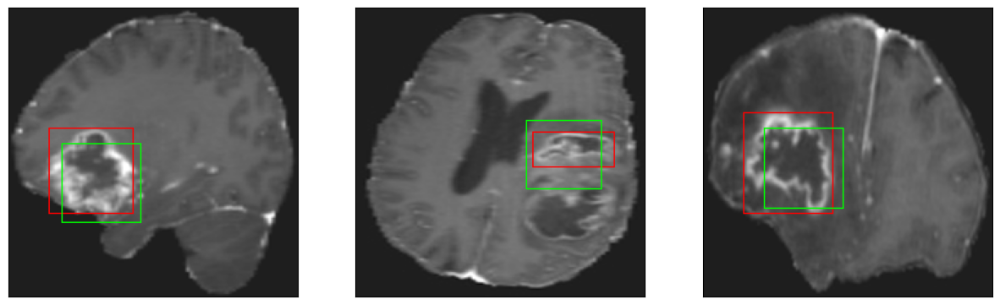

26/26 [==============================] - 2s 94ms/step - loss: 4.6723 - IoU: 0.6310 - val_loss: 10.9958 - val_IoU: 0.4269
Epoch 136/200
26/26 [==============================] - ETA: 0s - loss: 4.6072 - IoU: 0.6432
Epoch 136: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


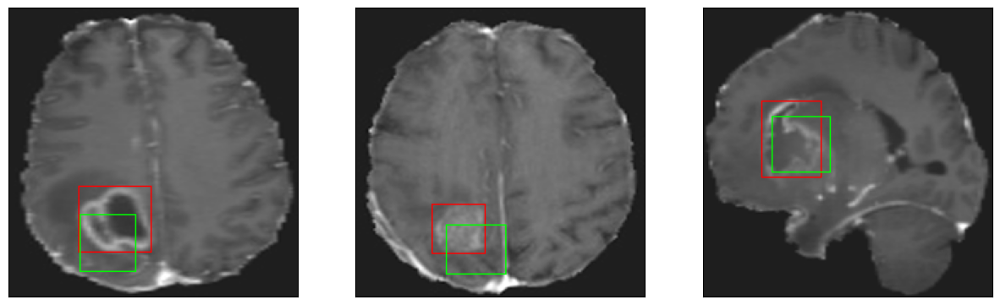

26/26 [==============================] - 3s 114ms/step - loss: 4.6072 - IoU: 0.6432 - val_loss: 11.7061 - val_IoU: 0.4001
Epoch 137/200
26/26 [==============================] - ETA: 0s - loss: 4.6166 - IoU: 0.6415
Epoch 137: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


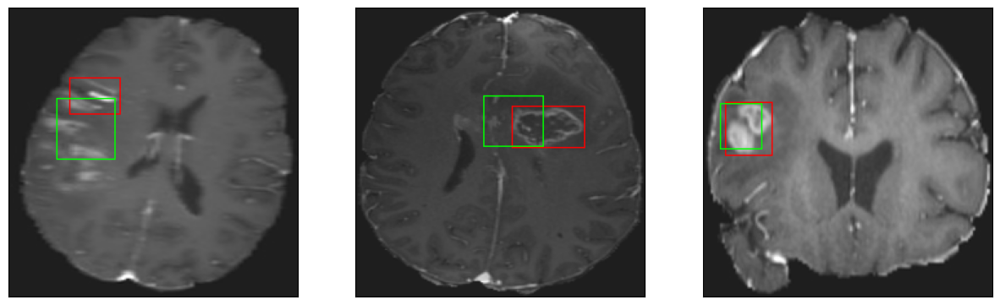

26/26 [==============================] - 3s 116ms/step - loss: 4.6166 - IoU: 0.6415 - val_loss: 11.4181 - val_IoU: 0.3946
Epoch 138/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6987 - IoU: 0.6401
Epoch 138: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


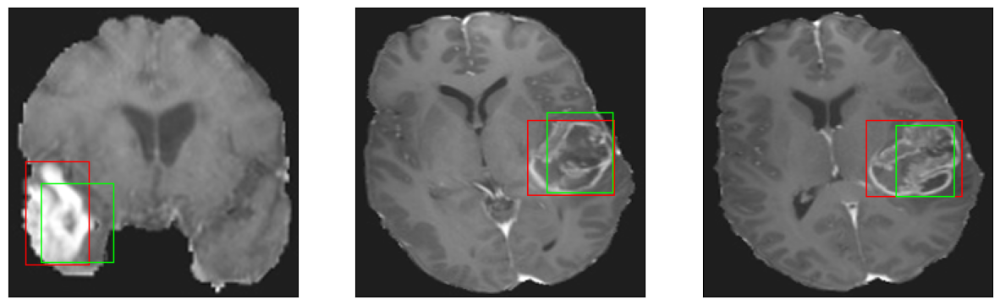

26/26 [==============================] - 3s 131ms/step - loss: 4.7594 - IoU: 0.6357 - val_loss: 11.3485 - val_IoU: 0.4109
Epoch 139/200
26/26 [==============================] - ETA: 0s - loss: 4.7116 - IoU: 0.6310
Epoch 139: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


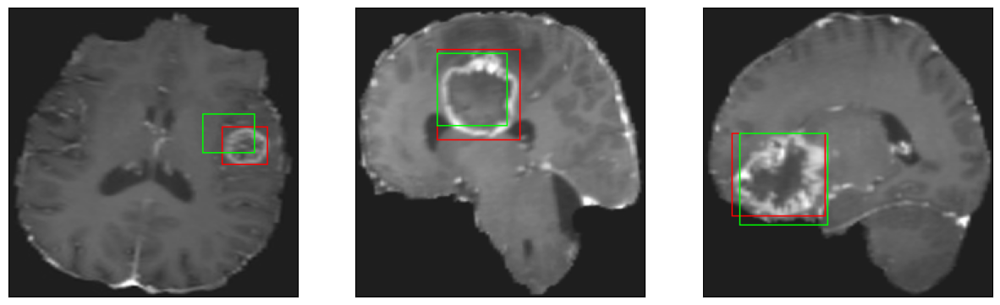

26/26 [==============================] - 3s 105ms/step - loss: 4.7116 - IoU: 0.6310 - val_loss: 11.3582 - val_IoU: 0.4005
Epoch 140/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4424 - IoU: 0.6508
Epoch 140: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


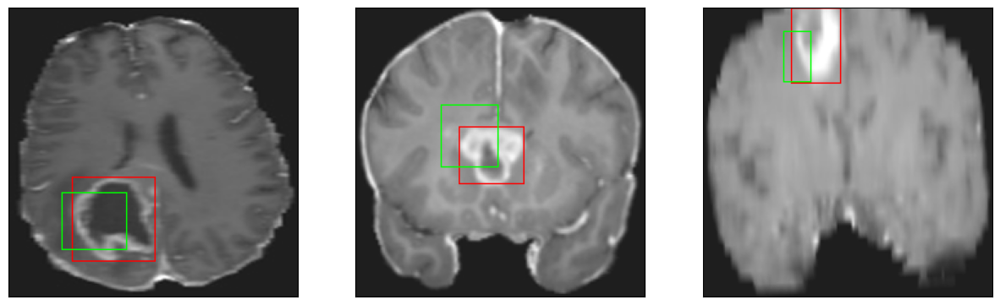

26/26 [==============================] - 3s 97ms/step - loss: 4.4360 - IoU: 0.6497 - val_loss: 12.3099 - val_IoU: 0.3553
Epoch 141/200
26/26 [==============================] - ETA: 0s - loss: 4.6041 - IoU: 0.6367
Epoch 141: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


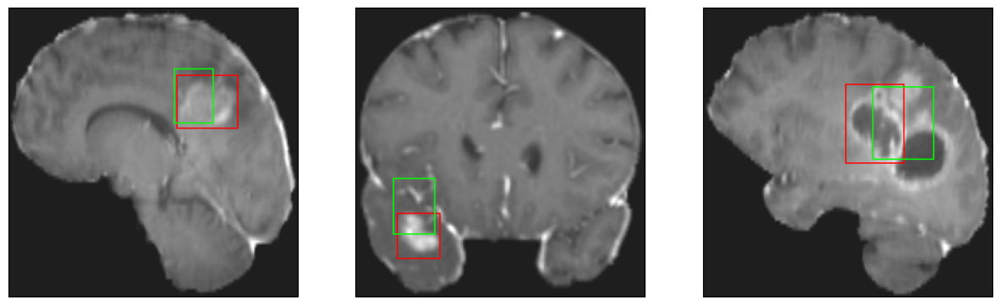

26/26 [==============================] - 3s 121ms/step - loss: 4.6041 - IoU: 0.6367 - val_loss: 13.0302 - val_IoU: 0.3169
Epoch 142/200
26/26 [==============================] - ETA: 0s - loss: 4.6000 - IoU: 0.6429
Epoch 142: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


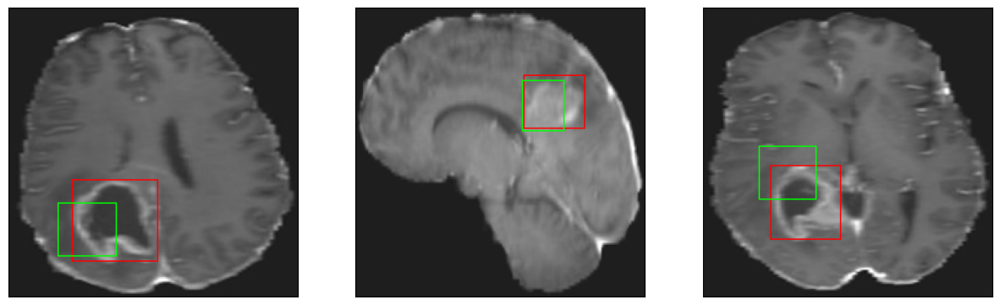

26/26 [==============================] - 2s 94ms/step - loss: 4.6000 - IoU: 0.6429 - val_loss: 13.5864 - val_IoU: 0.3169
Epoch 143/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5264 - IoU: 0.6436
Epoch 143: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


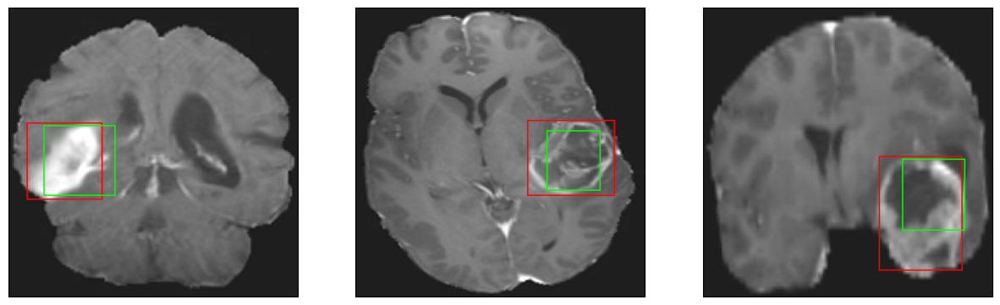

26/26 [==============================] - 3s 106ms/step - loss: 4.5331 - IoU: 0.6449 - val_loss: 10.5864 - val_IoU: 0.4407
Epoch 144/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4216 - IoU: 0.6524
Epoch 144: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


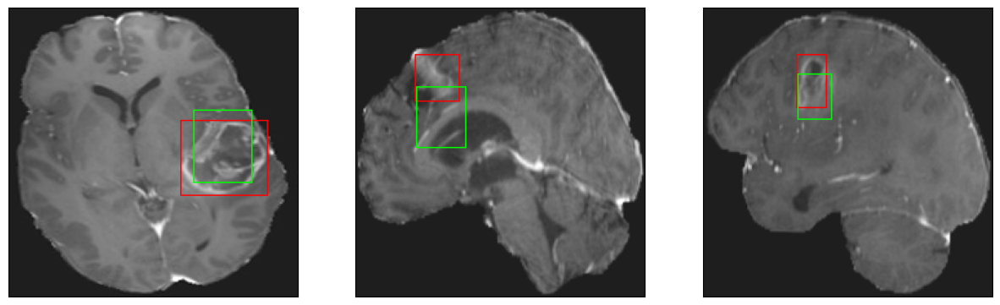

26/26 [==============================] - 3s 98ms/step - loss: 4.4096 - IoU: 0.6538 - val_loss: 11.4167 - val_IoU: 0.4108
Epoch 145/200
26/26 [==============================] - ETA: 0s - loss: 4.5542 - IoU: 0.6484
Epoch 145: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


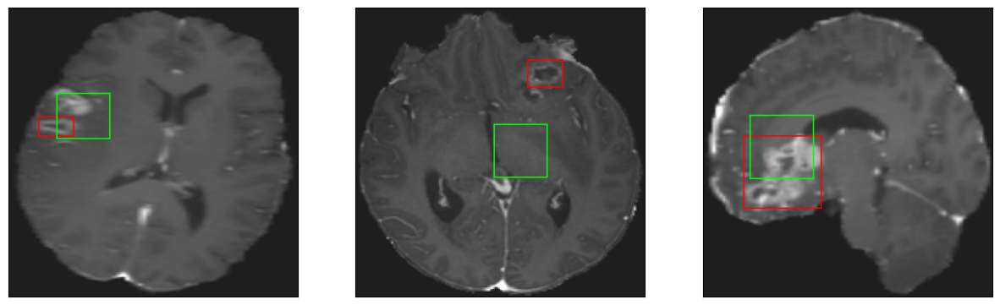

26/26 [==============================] - 3s 125ms/step - loss: 4.5542 - IoU: 0.6484 - val_loss: 12.3425 - val_IoU: 0.3570
Epoch 146/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3198 - IoU: 0.6542
Epoch 146: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


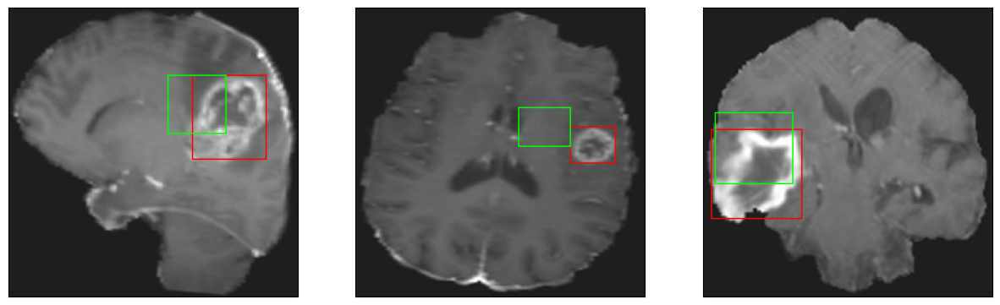

26/26 [==============================] - 3s 115ms/step - loss: 4.3502 - IoU: 0.6529 - val_loss: 15.8648 - val_IoU: 0.2028
Epoch 147/200
26/26 [==============================] - ETA: 0s - loss: 4.6203 - IoU: 0.6442
Epoch 147: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


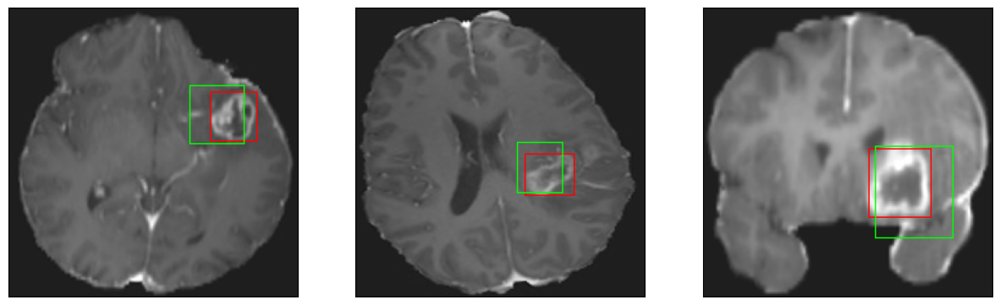

26/26 [==============================] - 3s 100ms/step - loss: 4.6203 - IoU: 0.6442 - val_loss: 10.6426 - val_IoU: 0.4430
Epoch 148/200
26/26 [==============================] - ETA: 0s - loss: 4.4200 - IoU: 0.6524
Epoch 148: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


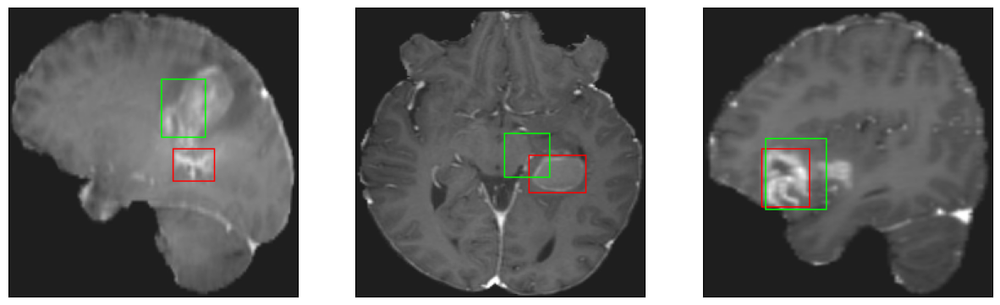

26/26 [==============================] - 3s 105ms/step - loss: 4.4200 - IoU: 0.6524 - val_loss: 11.5071 - val_IoU: 0.3929
Epoch 149/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4701 - IoU: 0.6522
Epoch 149: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4


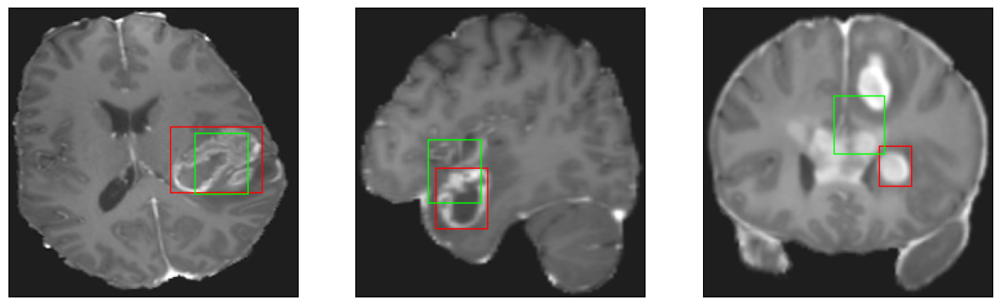

26/26 [==============================] - 3s 103ms/step - loss: 4.4551 - IoU: 0.6529 - val_loss: 11.4036 - val_IoU: 0.3995
Epoch 150/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5819 - IoU: 0.6463
Epoch 150: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


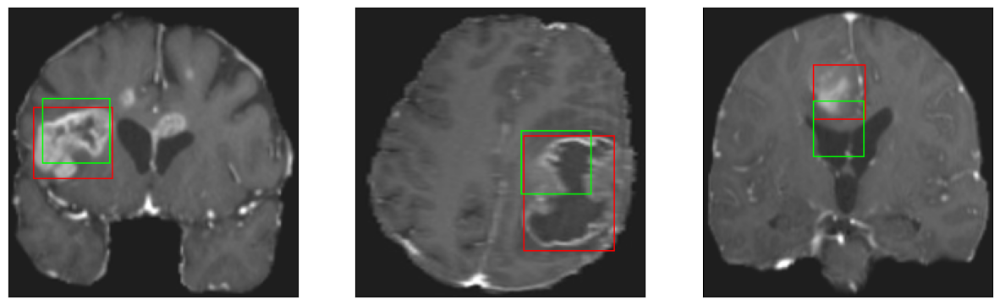

26/26 [==============================] - 3s 129ms/step - loss: 4.5612 - IoU: 0.6460 - val_loss: 10.7713 - val_IoU: 0.4373
Epoch 151/200
26/26 [==============================] - ETA: 0s - loss: 4.7603 - IoU: 0.6385
Epoch 151: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


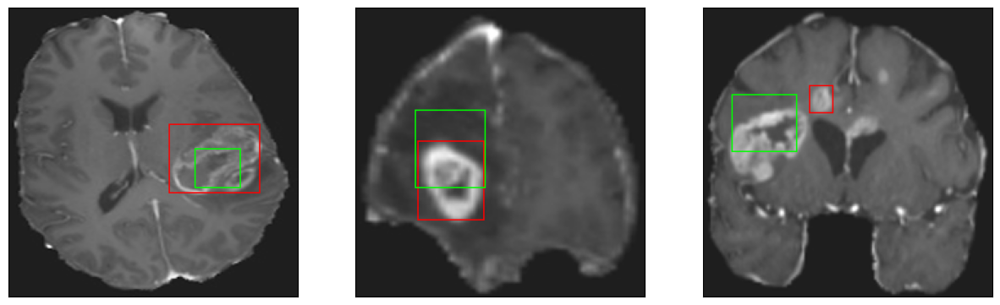

26/26 [==============================] - 3s 104ms/step - loss: 4.7603 - IoU: 0.6385 - val_loss: 11.8668 - val_IoU: 0.3710
Epoch 152/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5292 - IoU: 0.6489
Epoch 152: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


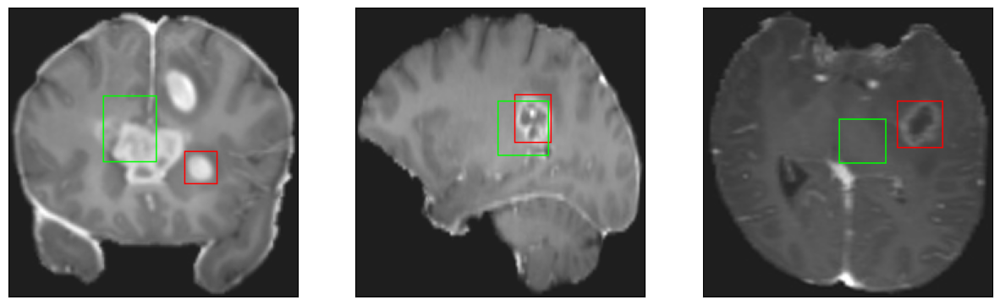

26/26 [==============================] - 3s 103ms/step - loss: 4.5343 - IoU: 0.6470 - val_loss: 11.0186 - val_IoU: 0.4308
Epoch 153/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3637 - IoU: 0.6560
Epoch 153: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


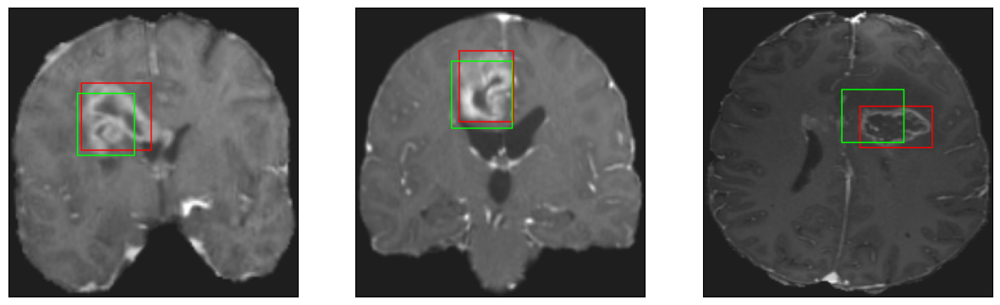

26/26 [==============================] - 3s 126ms/step - loss: 4.3772 - IoU: 0.6541 - val_loss: 11.0793 - val_IoU: 0.4170
Epoch 154/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3042 - IoU: 0.6534
Epoch 154: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


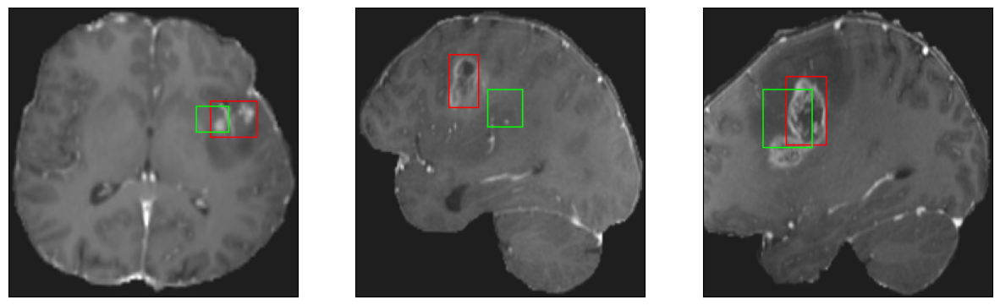

26/26 [==============================] - 3s 104ms/step - loss: 4.4009 - IoU: 0.6498 - val_loss: 11.0796 - val_IoU: 0.4243
Epoch 155/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6185 - IoU: 0.6463
Epoch 155: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


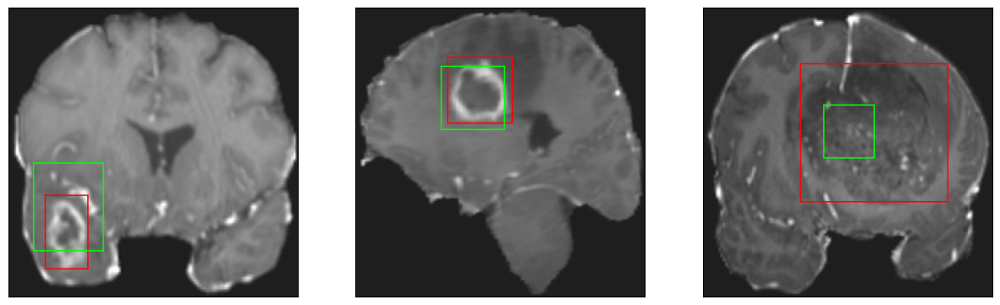

26/26 [==============================] - 3s 100ms/step - loss: 4.6045 - IoU: 0.6474 - val_loss: 10.9476 - val_IoU: 0.4289
Epoch 156/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5923 - IoU: 0.6434
Epoch 156: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


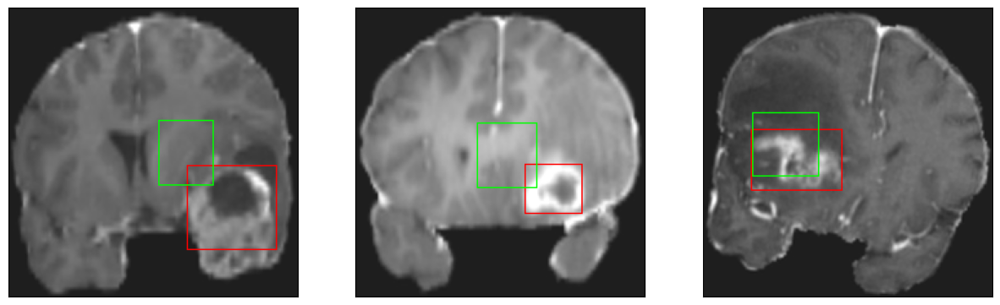

26/26 [==============================] - 3s 99ms/step - loss: 4.5919 - IoU: 0.6422 - val_loss: 13.8624 - val_IoU: 0.2951
Epoch 157/200
26/26 [==============================] - ETA: 0s - loss: 4.2747 - IoU: 0.6570
Epoch 157: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


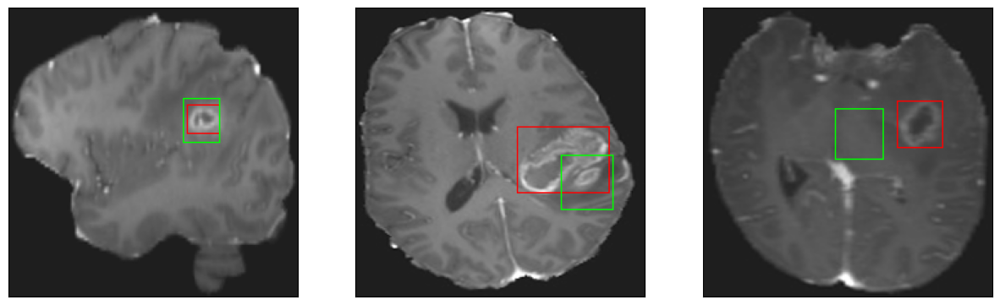

26/26 [==============================] - 3s 123ms/step - loss: 4.2747 - IoU: 0.6570 - val_loss: 10.3265 - val_IoU: 0.4462
Epoch 158/200
26/26 [==============================] - ETA: 0s - loss: 4.2409 - IoU: 0.6614
Epoch 158: val_IoU did not improve from 0.45384
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


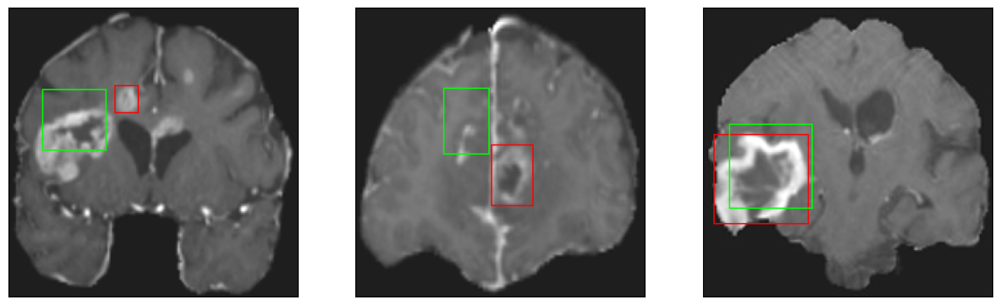

26/26 [==============================] - 3s 105ms/step - loss: 4.2409 - IoU: 0.6614 - val_loss: 11.8607 - val_IoU: 0.3715
Epoch 159/200
26/26 [==============================] - ETA: 0s - loss: 4.4443 - IoU: 0.6486
Epoch 159: val_IoU improved from 0.45384 to 0.46690, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


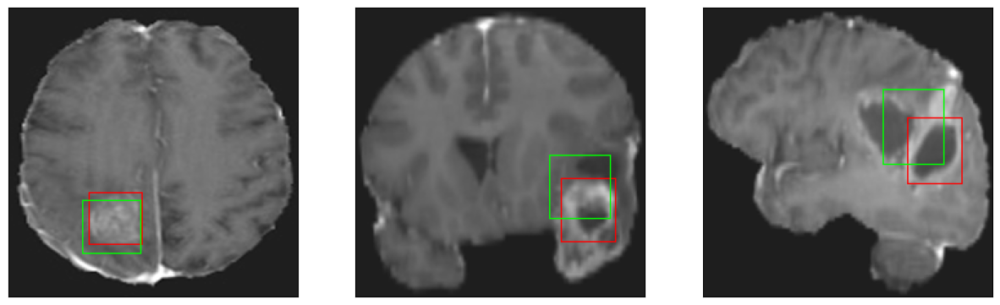

26/26 [==============================] - 3s 128ms/step - loss: 4.4443 - IoU: 0.6486 - val_loss: 10.1074 - val_IoU: 0.4669
Epoch 160/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4042 - IoU: 0.6539
Epoch 160: val_IoU did not improve from 0.46690
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


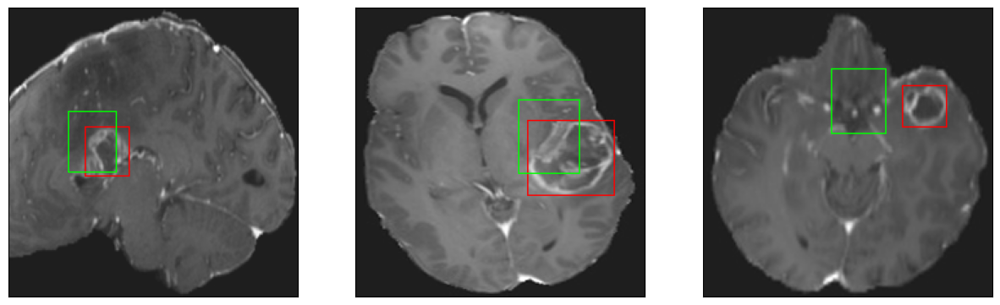

26/26 [==============================] - 3s 114ms/step - loss: 4.4198 - IoU: 0.6537 - val_loss: 12.0926 - val_IoU: 0.3629
Epoch 161/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2114 - IoU: 0.6712
Epoch 161: val_IoU did not improve from 0.46690
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


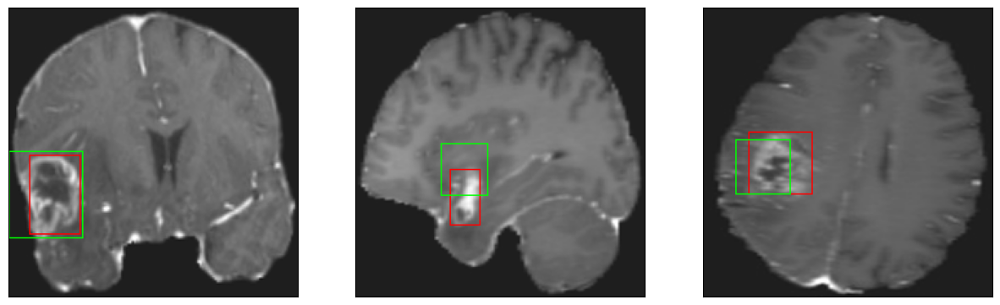

26/26 [==============================] - 3s 112ms/step - loss: 4.2141 - IoU: 0.6693 - val_loss: 10.8088 - val_IoU: 0.4412
Epoch 162/200
26/26 [==============================] - ETA: 0s - loss: 4.3776 - IoU: 0.6533
Epoch 162: val_IoU did not improve from 0.46690
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


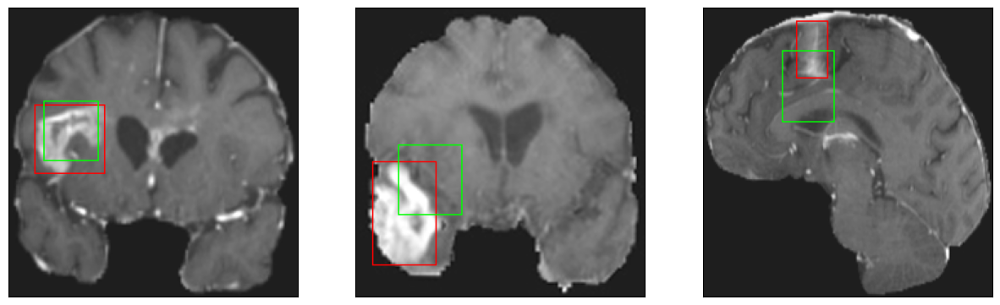

26/26 [==============================] - 3s 97ms/step - loss: 4.3776 - IoU: 0.6533 - val_loss: 14.7306 - val_IoU: 0.3016
Epoch 163/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2777 - IoU: 0.6581
Epoch 163: val_IoU did not improve from 0.46690
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


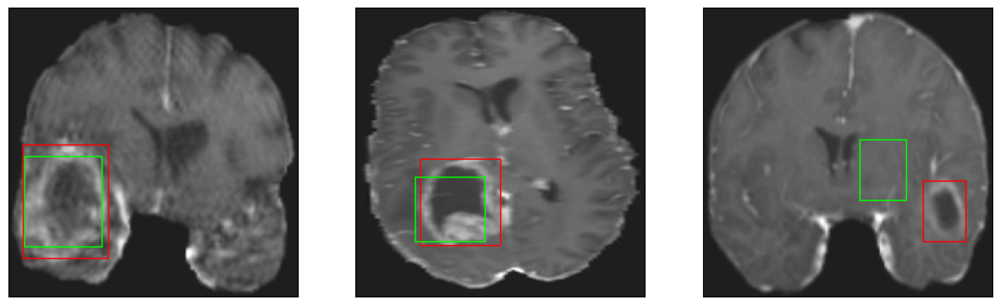

26/26 [==============================] - 3s 100ms/step - loss: 4.2945 - IoU: 0.6578 - val_loss: 10.1323 - val_IoU: 0.4577
Epoch 164/200
26/26 [==============================] - ETA: 0s - loss: 4.2549 - IoU: 0.6612
Epoch 164: val_IoU did not improve from 0.46690
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


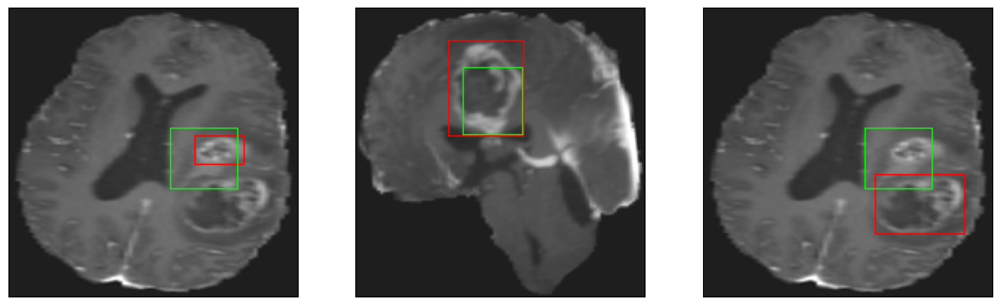

26/26 [==============================] - 3s 100ms/step - loss: 4.2549 - IoU: 0.6612 - val_loss: 10.3299 - val_IoU: 0.4605
Epoch 165/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4524 - IoU: 0.6500
Epoch 165: val_IoU did not improve from 0.46690
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


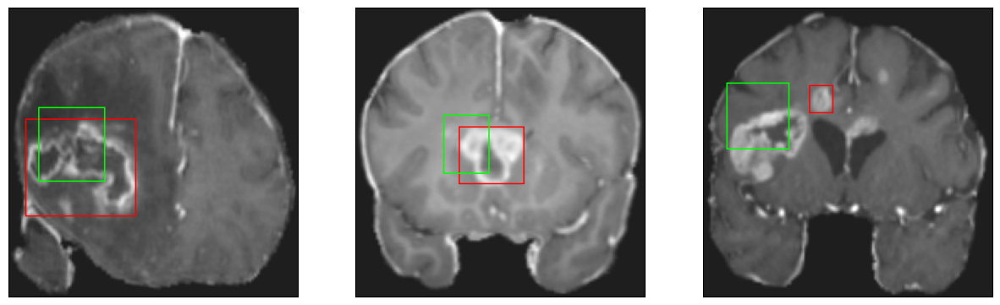

26/26 [==============================] - 3s 105ms/step - loss: 4.4412 - IoU: 0.6492 - val_loss: 11.7729 - val_IoU: 0.3706
Epoch 166/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4494 - IoU: 0.6555
Epoch 166: val_IoU did not improve from 0.46690
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


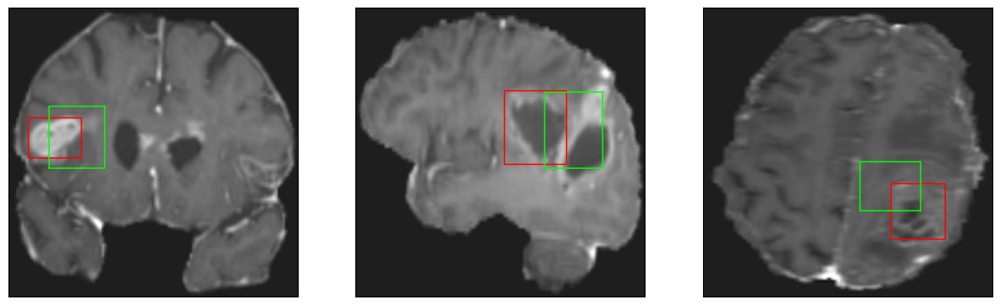

26/26 [==============================] - 3s 104ms/step - loss: 4.4214 - IoU: 0.6566 - val_loss: 10.4150 - val_IoU: 0.4601
Epoch 167/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3376 - IoU: 0.6540
Epoch 167: val_IoU did not improve from 0.46690
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


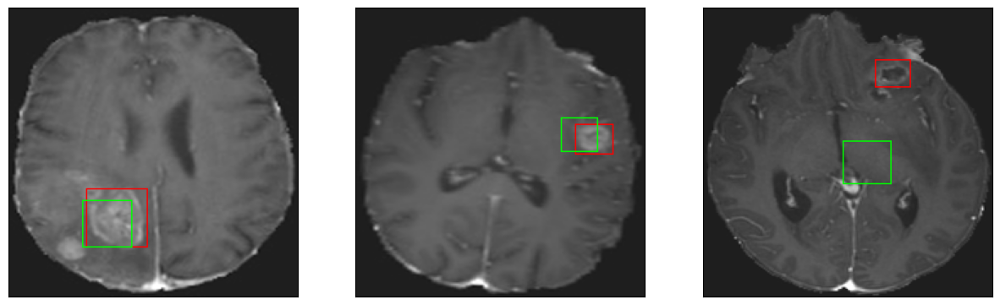

26/26 [==============================] - 3s 98ms/step - loss: 4.3509 - IoU: 0.6550 - val_loss: 10.4103 - val_IoU: 0.4525
Epoch 168/200
26/26 [==============================] - ETA: 0s - loss: 4.2781 - IoU: 0.6594
Epoch 168: val_IoU did not improve from 0.46690
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


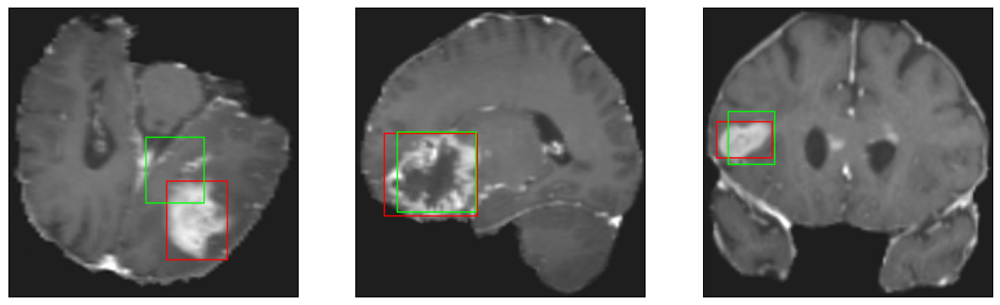

26/26 [==============================] - 3s 120ms/step - loss: 4.2781 - IoU: 0.6594 - val_loss: 10.6944 - val_IoU: 0.4280
Epoch 169/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2277 - IoU: 0.6616
Epoch 169: val_IoU did not improve from 0.46690
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


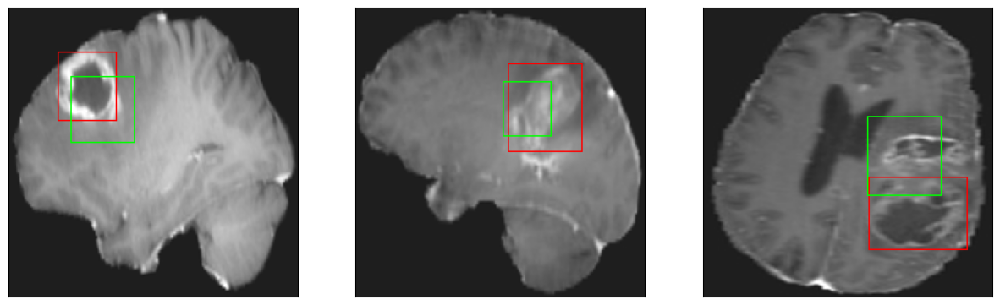

26/26 [==============================] - 3s 112ms/step - loss: 4.2339 - IoU: 0.6625 - val_loss: 11.2180 - val_IoU: 0.4064
Epoch 170/200
26/26 [==============================] - ETA: 0s - loss: 4.2153 - IoU: 0.6667
Epoch 170: val_IoU did not improve from 0.46690
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


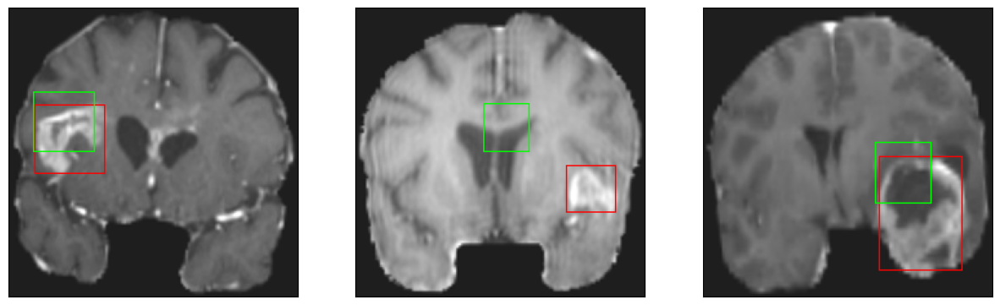

26/26 [==============================] - 3s 96ms/step - loss: 4.2153 - IoU: 0.6667 - val_loss: 13.7706 - val_IoU: 0.2867
Epoch 171/200
26/26 [==============================] - ETA: 0s - loss: 4.3638 - IoU: 0.6577
Epoch 171: val_IoU did not improve from 0.46690
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


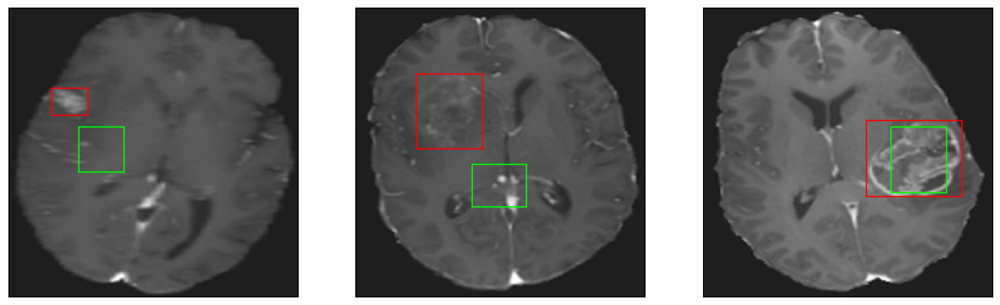

26/26 [==============================] - 3s 99ms/step - loss: 4.3638 - IoU: 0.6577 - val_loss: 10.9529 - val_IoU: 0.4289
Epoch 172/200
26/26 [==============================] - ETA: 0s - loss: 4.2657 - IoU: 0.6562
Epoch 172: val_IoU did not improve from 0.46690
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


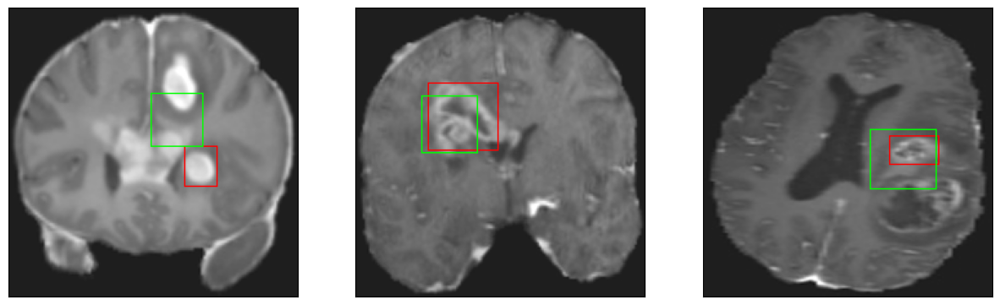

26/26 [==============================] - 3s 115ms/step - loss: 4.2657 - IoU: 0.6562 - val_loss: 11.1298 - val_IoU: 0.4142
Epoch 173/200
26/26 [==============================] - ETA: 0s - loss: 4.0602 - IoU: 0.6762
Epoch 173: val_IoU did not improve from 0.46690
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


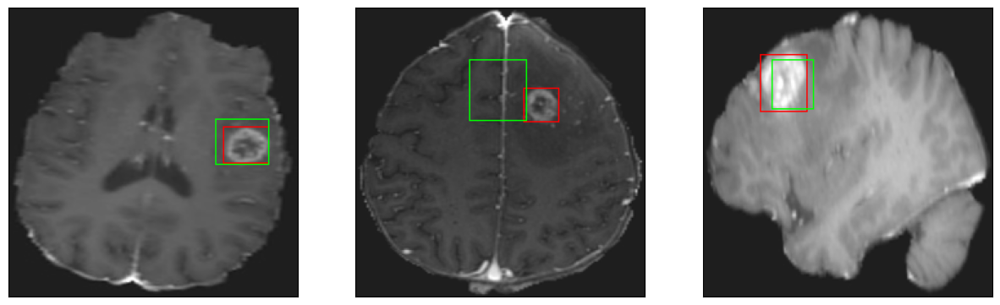

26/26 [==============================] - 3s 96ms/step - loss: 4.0602 - IoU: 0.6762 - val_loss: 10.2499 - val_IoU: 0.4590
Epoch 174/200
26/26 [==============================] - ETA: 0s - loss: 4.2540 - IoU: 0.6622
Epoch 174: val_IoU improved from 0.46690 to 0.46955, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


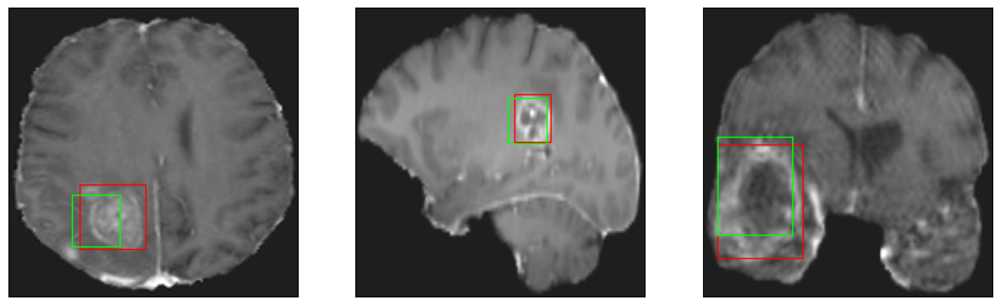

26/26 [==============================] - 3s 119ms/step - loss: 4.2540 - IoU: 0.6622 - val_loss: 10.2374 - val_IoU: 0.4696
Epoch 175/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3267 - IoU: 0.6561
Epoch 175: val_IoU did not improve from 0.46955
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


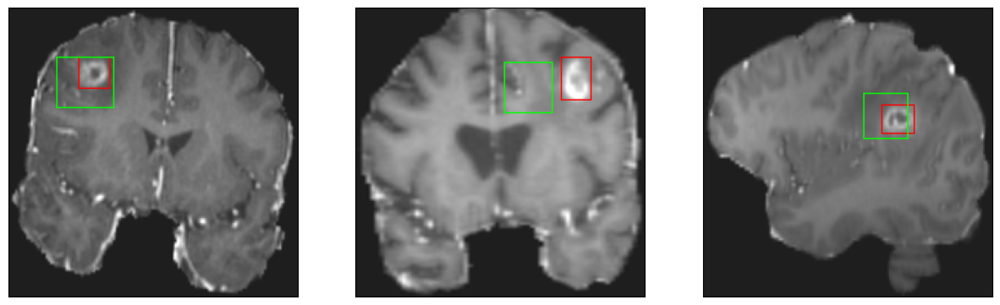

26/26 [==============================] - 3s 102ms/step - loss: 4.3392 - IoU: 0.6561 - val_loss: 10.2407 - val_IoU: 0.4616
Epoch 176/200
26/26 [==============================] - ETA: 0s - loss: 4.4932 - IoU: 0.6497
Epoch 176: val_IoU did not improve from 0.46955
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


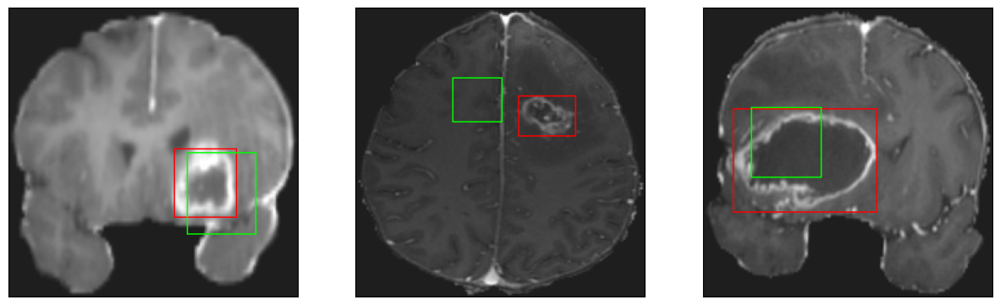

26/26 [==============================] - 3s 108ms/step - loss: 4.4932 - IoU: 0.6497 - val_loss: 10.8661 - val_IoU: 0.4092
Epoch 177/200
26/26 [==============================] - ETA: 0s - loss: 4.3344 - IoU: 0.6642
Epoch 177: val_IoU did not improve from 0.46955
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4


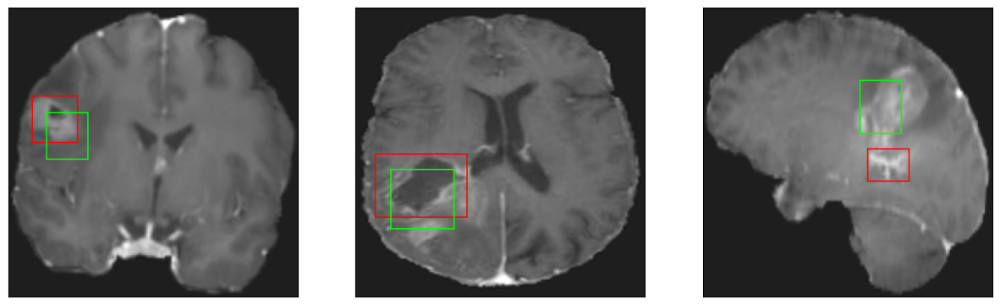

26/26 [==============================] - 3s 121ms/step - loss: 4.3344 - IoU: 0.6642 - val_loss: 10.2962 - val_IoU: 0.4566
Epoch 178/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1844 - IoU: 0.6688
Epoch 178: val_IoU did not improve from 0.46955
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


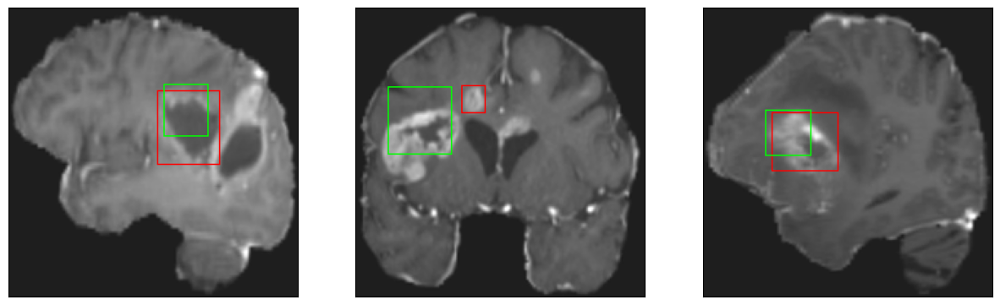

26/26 [==============================] - 2s 96ms/step - loss: 4.2114 - IoU: 0.6660 - val_loss: 12.8940 - val_IoU: 0.3380
Epoch 179/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2541 - IoU: 0.6628
Epoch 179: val_IoU did not improve from 0.46955
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


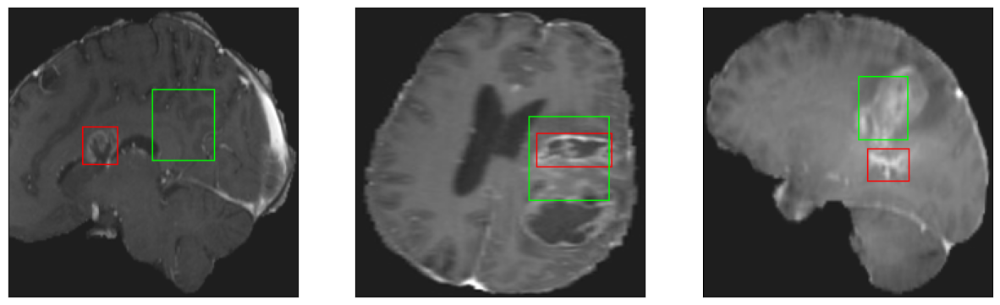

26/26 [==============================] - 3s 98ms/step - loss: 4.2385 - IoU: 0.6644 - val_loss: 10.5774 - val_IoU: 0.4528
Epoch 180/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2838 - IoU: 0.6490
Epoch 180: val_IoU did not improve from 0.46955
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


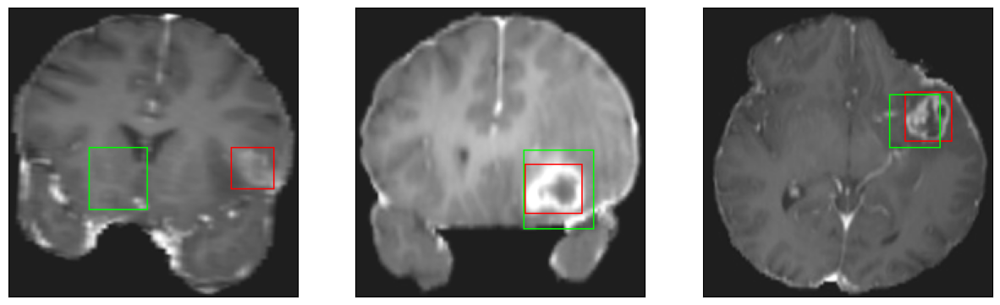

26/26 [==============================] - 3s 115ms/step - loss: 4.2804 - IoU: 0.6490 - val_loss: 10.0374 - val_IoU: 0.4594
Epoch 181/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3089 - IoU: 0.6543
Epoch 181: val_IoU did not improve from 0.46955
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


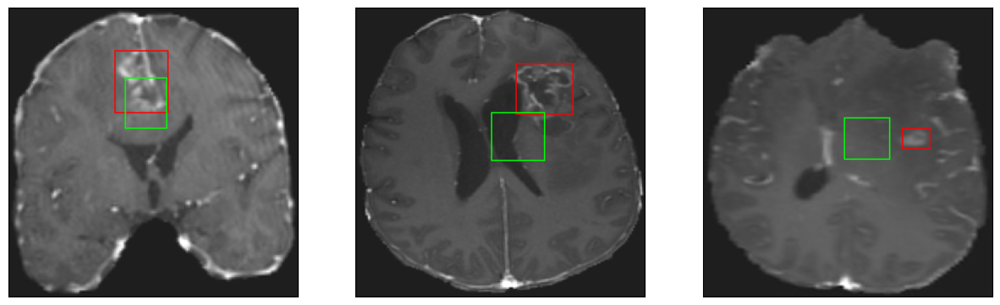

26/26 [==============================] - 3s 122ms/step - loss: 4.3222 - IoU: 0.6537 - val_loss: 10.9425 - val_IoU: 0.4186
Epoch 182/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2438 - IoU: 0.6617
Epoch 182: val_IoU did not improve from 0.46955
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


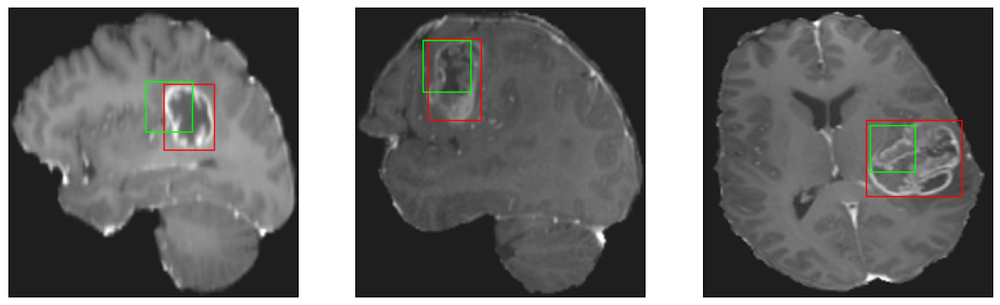

26/26 [==============================] - 3s 118ms/step - loss: 4.2292 - IoU: 0.6611 - val_loss: 12.3522 - val_IoU: 0.3492
Epoch 183/200
26/26 [==============================] - ETA: 0s - loss: 4.1362 - IoU: 0.6716
Epoch 183: val_IoU did not improve from 0.46955
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


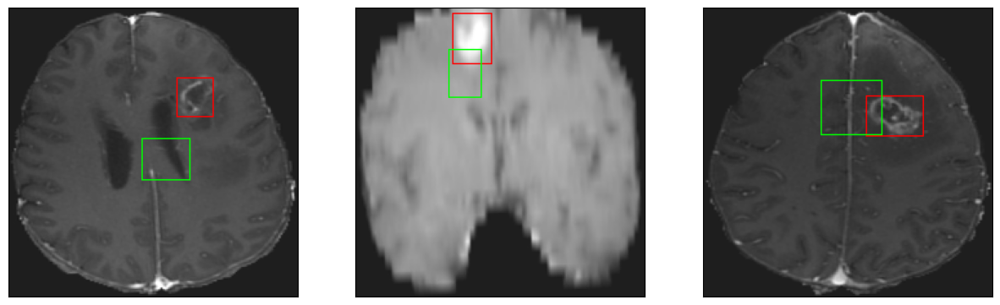

26/26 [==============================] - 3s 96ms/step - loss: 4.1362 - IoU: 0.6716 - val_loss: 11.8181 - val_IoU: 0.3765
Epoch 184/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3938 - IoU: 0.6481
Epoch 184: val_IoU did not improve from 0.46955
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


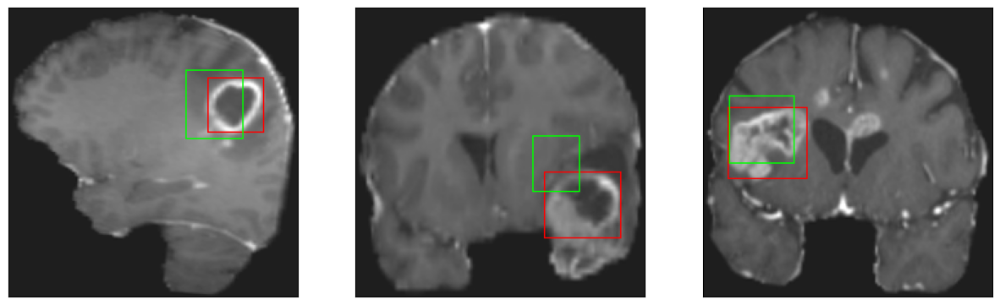

26/26 [==============================] - 2s 93ms/step - loss: 4.3490 - IoU: 0.6492 - val_loss: 10.9514 - val_IoU: 0.4109
Epoch 185/200
26/26 [==============================] - ETA: 0s - loss: 4.1476 - IoU: 0.6668
Epoch 185: val_IoU did not improve from 0.46955
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


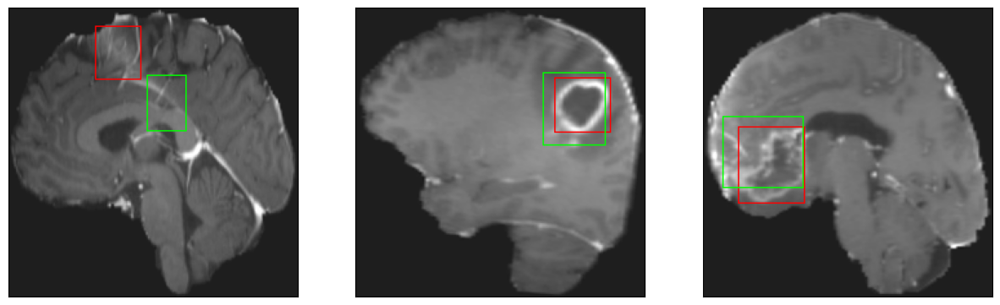

26/26 [==============================] - 2s 96ms/step - loss: 4.1476 - IoU: 0.6668 - val_loss: 10.9809 - val_IoU: 0.4288
Epoch 186/200
26/26 [==============================] - ETA: 0s - loss: 4.1828 - IoU: 0.6618
Epoch 186: val_IoU did not improve from 0.46955
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


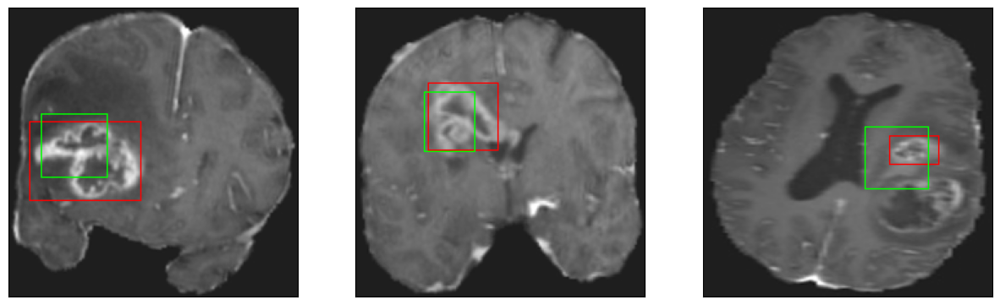

26/26 [==============================] - 3s 99ms/step - loss: 4.1828 - IoU: 0.6618 - val_loss: 13.5770 - val_IoU: 0.3101
Epoch 187/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2321 - IoU: 0.6707
Epoch 187: val_IoU did not improve from 0.46955
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


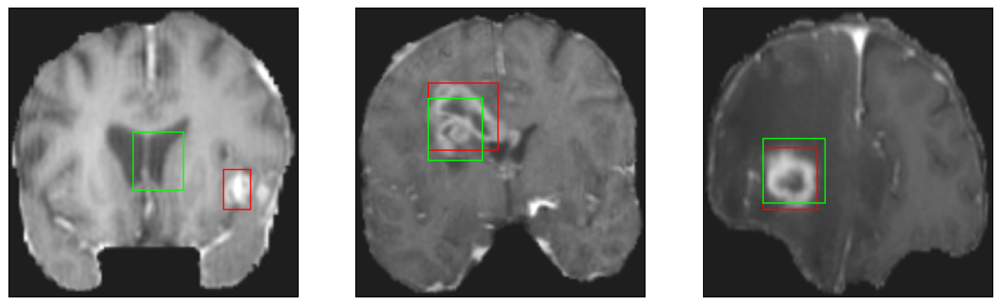

26/26 [==============================] - 3s 118ms/step - loss: 4.2326 - IoU: 0.6696 - val_loss: 11.2121 - val_IoU: 0.4056
Epoch 188/200
26/26 [==============================] - ETA: 0s - loss: 4.3494 - IoU: 0.6585
Epoch 188: val_IoU did not improve from 0.46955
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


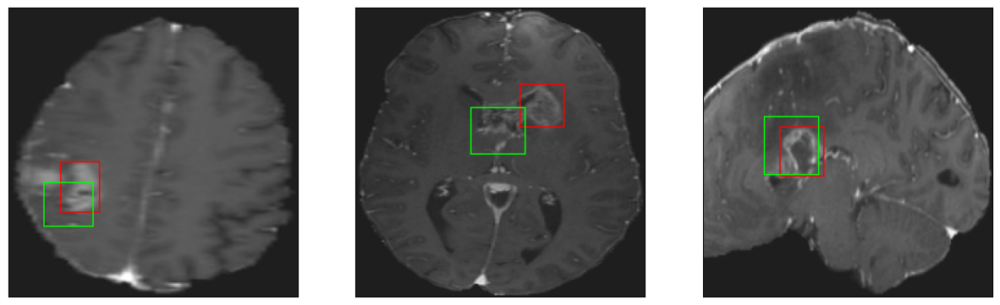

26/26 [==============================] - 3s 107ms/step - loss: 4.3494 - IoU: 0.6585 - val_loss: 10.7134 - val_IoU: 0.4507
Epoch 189/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2866 - IoU: 0.6559
Epoch 189: val_IoU did not improve from 0.46955
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


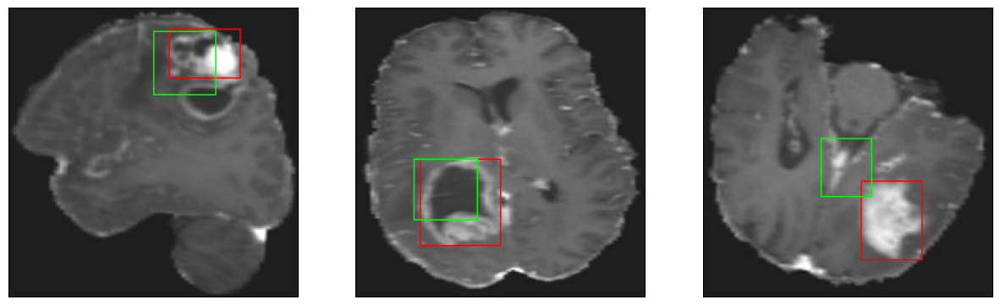

26/26 [==============================] - 3s 101ms/step - loss: 4.2452 - IoU: 0.6575 - val_loss: 13.1104 - val_IoU: 0.3323
Epoch 190/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0772 - IoU: 0.6732
Epoch 190: val_IoU did not improve from 0.46955
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4


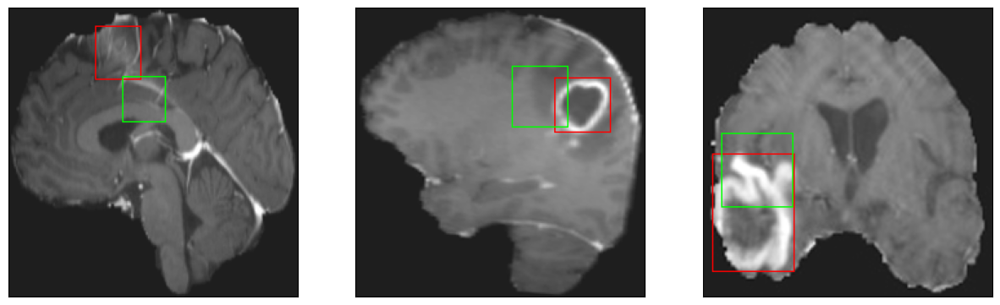

26/26 [==============================] - 3s 121ms/step - loss: 4.1138 - IoU: 0.6716 - val_loss: 15.5049 - val_IoU: 0.2451
Epoch 191/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1108 - IoU: 0.6744
Epoch 191: val_IoU did not improve from 0.46955
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


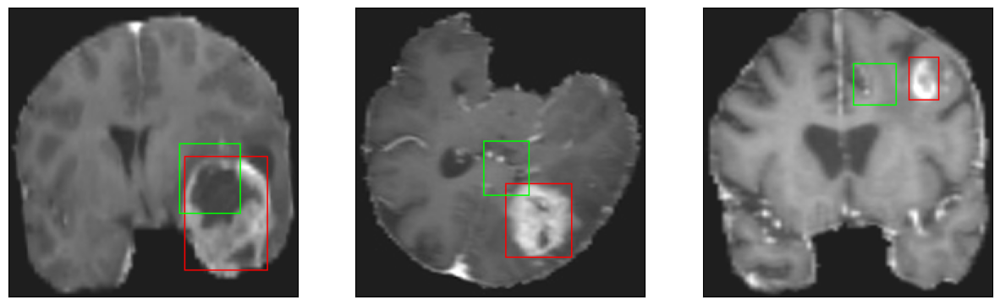

26/26 [==============================] - 3s 102ms/step - loss: 4.1450 - IoU: 0.6694 - val_loss: 12.0906 - val_IoU: 0.3552
Epoch 192/200
26/26 [==============================] - ETA: 0s - loss: 4.4279 - IoU: 0.6536
Epoch 192: val_IoU did not improve from 0.46955
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


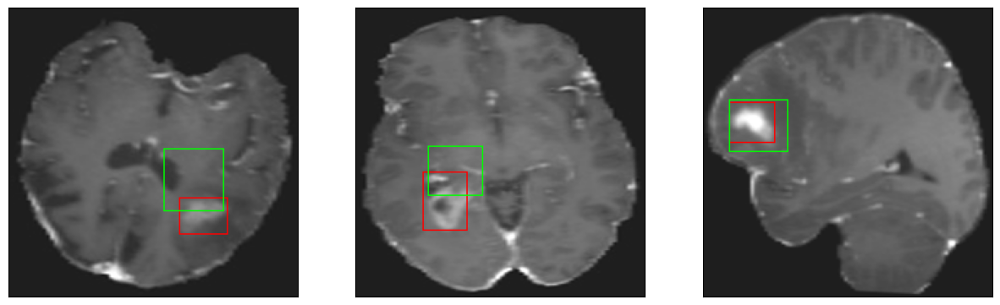

26/26 [==============================] - 3s 101ms/step - loss: 4.4279 - IoU: 0.6536 - val_loss: 10.7169 - val_IoU: 0.4363
Epoch 193/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1271 - IoU: 0.6732
Epoch 193: val_IoU improved from 0.46955 to 0.47163, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


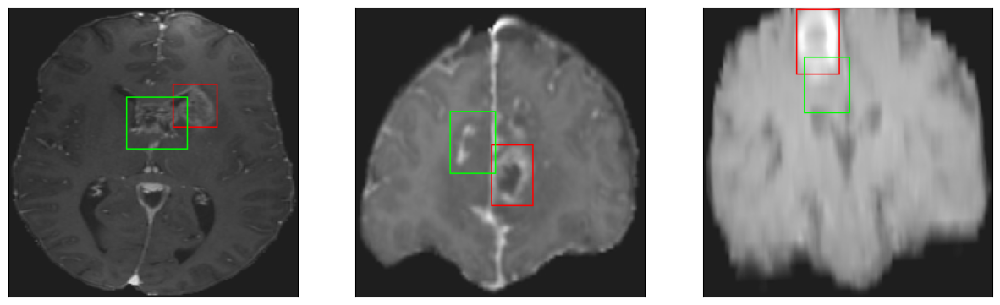

26/26 [==============================] - 3s 124ms/step - loss: 4.1193 - IoU: 0.6738 - val_loss: 10.0749 - val_IoU: 0.4716
Epoch 194/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2723 - IoU: 0.6608
Epoch 194: val_IoU did not improve from 0.47163
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 9ms/step
4


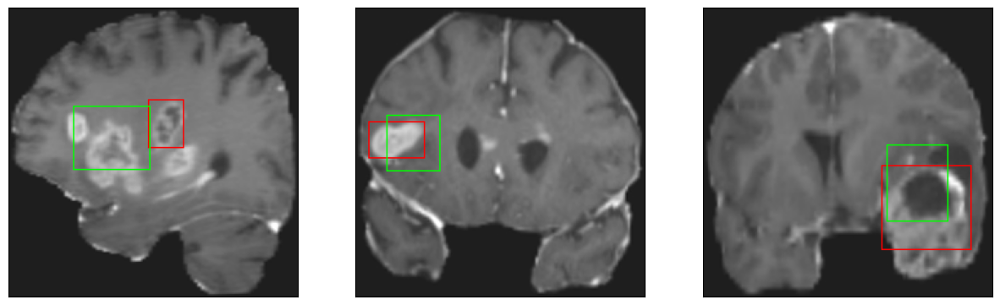

26/26 [==============================] - 3s 124ms/step - loss: 4.2425 - IoU: 0.6605 - val_loss: 10.4941 - val_IoU: 0.4454
Epoch 195/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2699 - IoU: 0.6537
Epoch 195: val_IoU did not improve from 0.47163
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


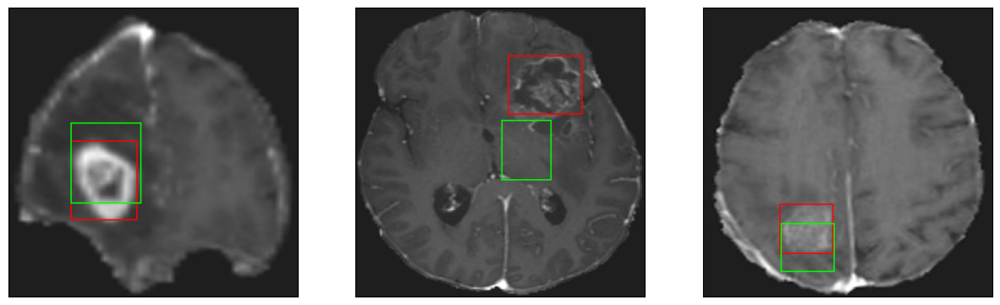

26/26 [==============================] - 3s 102ms/step - loss: 4.2739 - IoU: 0.6555 - val_loss: 11.9678 - val_IoU: 0.3856
Epoch 196/200
26/26 [==============================] - ETA: 0s - loss: 4.2212 - IoU: 0.6656
Epoch 196: val_IoU did not improve from 0.47163
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


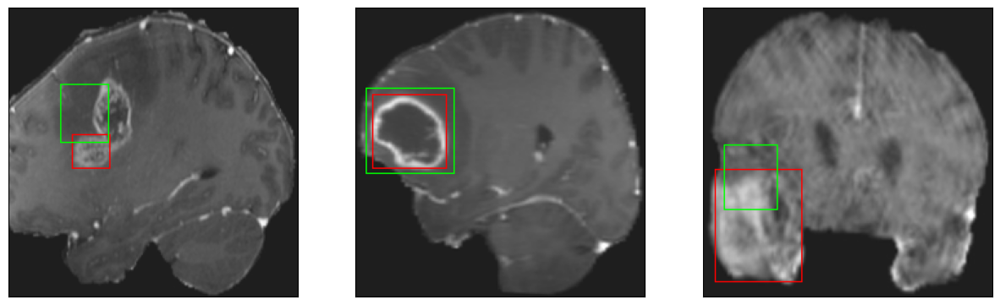

26/26 [==============================] - 3s 100ms/step - loss: 4.2212 - IoU: 0.6656 - val_loss: 10.7920 - val_IoU: 0.4230
Epoch 197/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2288 - IoU: 0.6648
Epoch 197: val_IoU did not improve from 0.47163
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


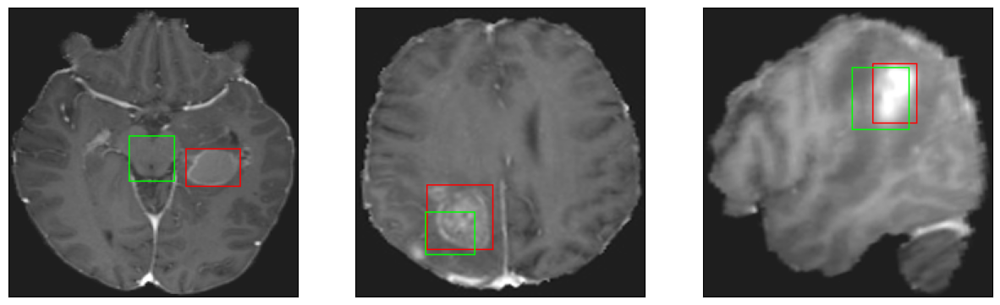

26/26 [==============================] - 2s 95ms/step - loss: 4.2596 - IoU: 0.6628 - val_loss: 11.3440 - val_IoU: 0.4029
Epoch 198/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0656 - IoU: 0.6772
Epoch 198: val_IoU did not improve from 0.47163
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


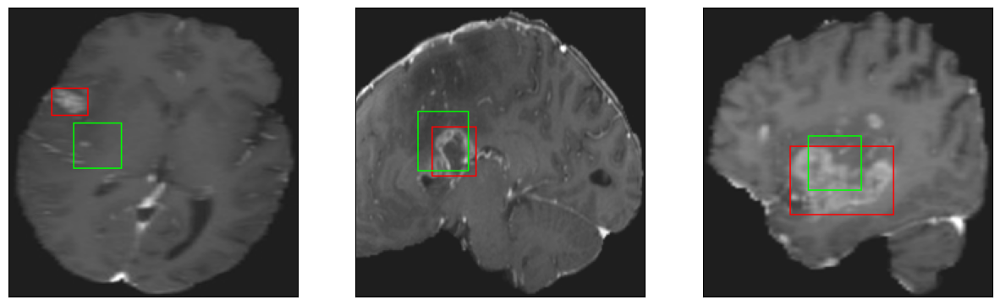

26/26 [==============================] - 3s 122ms/step - loss: 4.1076 - IoU: 0.6758 - val_loss: 10.2228 - val_IoU: 0.4625
Epoch 199/200
26/26 [==============================] - ETA: 0s - loss: 4.3548 - IoU: 0.6490
Epoch 199: val_IoU did not improve from 0.47163
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


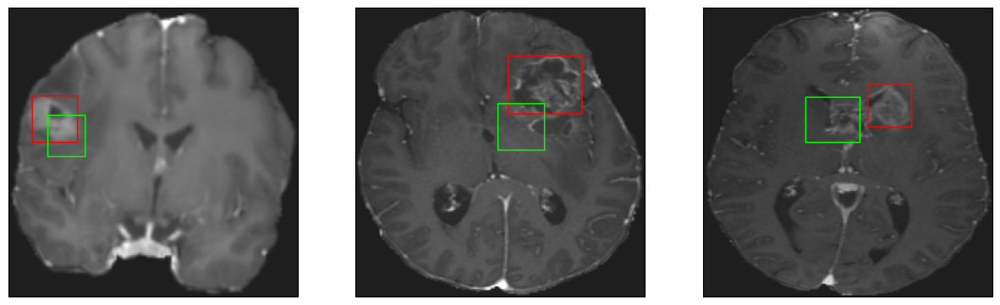

26/26 [==============================] - 3s 134ms/step - loss: 4.3548 - IoU: 0.6490 - val_loss: 11.6403 - val_IoU: 0.3733
Epoch 200/200
26/26 [==============================] - ETA: 0s - loss: 4.2412 - IoU: 0.6615
Epoch 200: val_IoU did not improve from 0.47163
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


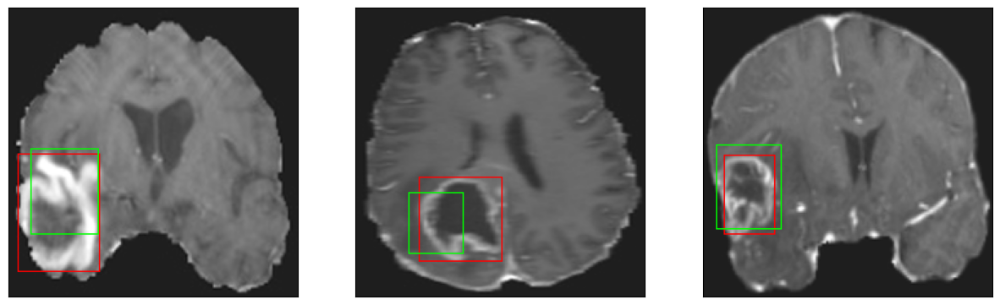

26/26 [==============================] - 3s 110ms/step - loss: 4.2412 - IoU: 0.6615 - val_loss: 10.8758 - val_IoU: 0.4264


In [24]:
hist = model.fit(
        train_dataset,
        epochs=200,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

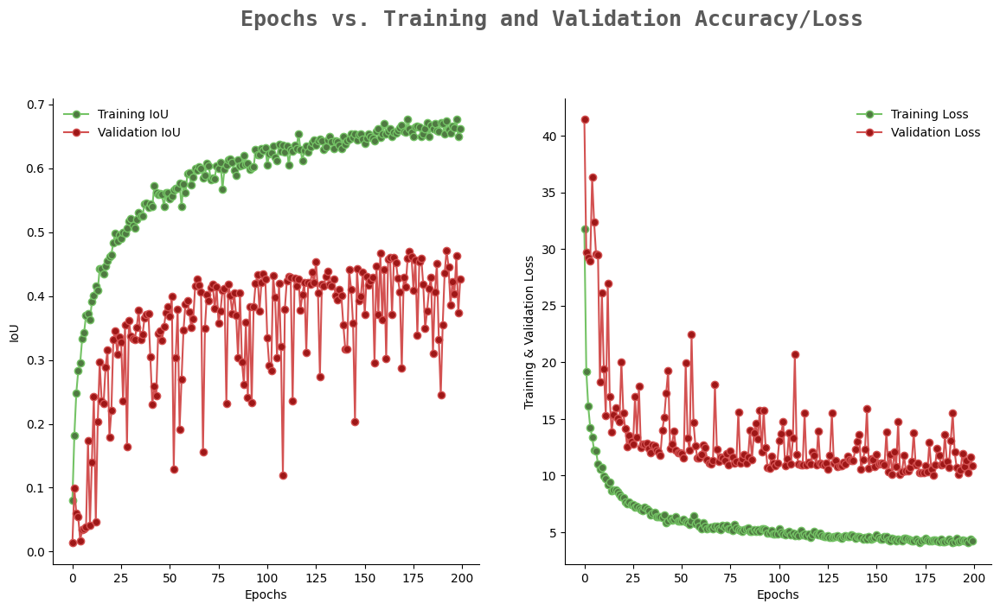

In [25]:
import seaborn as sns
colors_dark = ["#1F1F1F", "#313131", '#636363', '#AEAEAE', '#DADADA']
colors_red = ["#331313", "#582626", '#9E1717', '#D35151', '#E9B4B4']
colors_green = ['#01411C','#4B6F44','#4F7942','#74C365','#D0F0C0']
from warnings import filterwarnings
filterwarnings('ignore')

epochs = [i for i in range(200)]
fig, ax = plt.subplots(1,2,figsize=(14,7))
train_acc = hist.history['IoU']
train_loss = hist.history['loss']
val_acc = hist.history['val_IoU']
val_loss = hist.history['val_loss']

fig.text(s='Epochs vs. Training and Validation Accuracy/Loss',size=18,fontweight='bold',
             fontname='monospace',color=colors_dark[1],y=1,x=0.28,alpha=0.8)

sns.despine()
ax[0].plot(epochs, train_acc, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label = 'Training IoU')
ax[0].plot(epochs, val_acc, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation IoU')
ax[0].legend(frameon=False)
ax[0].set_xlabel('Epochs')
ax[0].set_ylabel('IoU')

sns.despine()
ax[1].plot(epochs, train_loss, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label ='Training Loss')
ax[1].plot(epochs, val_loss, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation Loss')
ax[1].legend(frameon=False)
ax[1].set_xlabel('Epochs')
ax[1].set_ylabel('Training & Validation Loss')

fig.show()

In [26]:
#iou = IoU(y_true, y_pred, 4, [1])
model = tf.keras.models.load_model('./model_checkpoint_SCRATCH/model_SCRATCH.h5',compile = False)

In [27]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

In [28]:
model.evaluate(test_dataset)

8/8 [==============================] - 1s 43ms/step - loss: 12.1087 - IoU: 0.3710


[12.108689308166504, 0.3710489273071289]